# Background
Task: This task is to predict the total cases of dengue fever (Label) for each in the test set.  

https://www.drivendata.org/competitions/44/dengai-predicting-disease-spread/

# 1. Data Preparation (shared among all team members)


In this section, data is only prepared, so the results of EDA will **not be further analyzed**. Further analysis will be displayed in the **individual section of each team member**.  



## 1.0 Install and import package
## Before starting to run, please drag all the files in the zip folder to a directory at the same level as the code

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import random
import seaborn as sns
import scipy
from scipy.stats import pearsonr
import sklearn
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.svm import SVR
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.pipeline import Pipeline
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.model_selection import GridSearchCV
from xgboost import XGBRegressor
import matplotlib.dates as mdates
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.callbacks import EarlyStopping

In [ ]:
!pip install -r requirements.txt

## 1.1 Data Loading
## Note ! ! ! ! (Please ensure that 8 source data and 1 txt is in the same directory as the ipynb file)
##As our pathname is like "dengue_features_train.csv"
#### Marked up of our  names for variables  
all_df_feature:  Features of Training Set  
all_df_label:  Labels of Training Set  
all_df_test: Features of Training Set  


In [ ]:
all_df_feature = pd.read_csv('dengue_features_train.csv')
all_df_label = pd.read_csv('dengue_labels_train.csv')
all_df_test = pd.read_csv('dengue_features_test.csv')

### Training Dataset
Overview of Training Dataset

#### Training Features
Overview of Training Feature dataset

1456 samples with 24 columns  

In [ ]:
print(all_df_feature.shape)
all_df_feature.head()

(1456, 24)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,1990,18,1990-04-30,0.122600,0.103725,0.198483,0.177617,12.42,297.572857,...,32.00,73.365714,12.42,14.012857,2.628571,25.442857,6.900000,29.4,20.0,16.0
1,sj,1990,19,1990-05-07,0.169900,0.142175,0.162357,0.155486,22.82,298.211429,...,17.94,77.368571,22.82,15.372857,2.371429,26.714286,6.371429,31.7,22.2,8.6
2,sj,1990,20,1990-05-14,0.032250,0.172967,0.157200,0.170843,34.54,298.781429,...,26.10,82.052857,34.54,16.848571,2.300000,26.714286,6.485714,32.2,22.8,41.4
3,sj,1990,21,1990-05-21,0.128633,0.245067,0.227557,0.235886,15.36,298.987143,...,13.90,80.337143,15.36,16.672857,2.428571,27.471429,6.771429,33.3,23.3,4.0
4,sj,1990,22,1990-05-28,0.196200,0.262200,0.251200,0.247340,7.52,299.518571,...,12.20,80.460000,7.52,17.210000,3.014286,28.942857,9.371429,35.0,23.9,5.8


#### Training Labels
Overview of Training Label dataset

In [ ]:
print(all_df_label.shape)
all_df_label.head()

(1456, 4)


,city,year,weekofyear,total_cases
0,sj,1990,18,4
1,sj,1990,19,5
2,sj,1990,20,4
3,sj,1990,21,3
4,sj,1990,22,6


### Testing Dataset
Overview of Training Dataset
416 samples with 24 columns

In [ ]:
all_df_test = pd.read_csv('dengue_features_test.csv')
print(all_df_test.shape)
all_df_test.head()

(416, 24)


,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
0,sj,2008,18,2008-04-29,-0.0189,-0.018900,0.102729,0.091200,78.60,298.492857,...,25.37,78.781429,78.60,15.918571,3.128571,26.528571,7.057143,33.3,21.7,75.2
1,sj,2008,19,2008-05-06,-0.0180,-0.012400,0.082043,0.072314,12.56,298.475714,...,21.83,78.230000,12.56,15.791429,2.571429,26.071429,5.557143,30.0,22.2,34.3
2,sj,2008,20,2008-05-13,-0.0015,NaN,0.151083,0.091529,3.66,299.455714,...,4.12,78.270000,3.66,16.674286,4.428571,27.928571,7.785714,32.8,22.8,3.0
3,sj,2008,21,2008-05-20,NaN,-0.019867,0.124329,0.125686,0.00,299.690000,...,2.20,73.015714,0.00,15.775714,4.342857,28.057143,6.271429,33.3,24.4,0.3
4,sj,2008,22,2008-05-27,0.0568,0.039833,0.062267,0.075914,0.76,299.780000,...,4.36,74.084286,0.76,16.137143,3.542857,27.614286,7.085714,33.3,23.3,84.1


So, this task is to predict the total cases of dengue fever (Label) for each (city, year, weekofyear) in the test set based on 24 Features.

### City
#### Both the test set and the training set are composed of data from two cities( San Juan and Iquitos)
1. All come from tropical areas.  
2. They are located in the northern and southern hemispheres respectively,  
San Juan(SJ): 8°27'58.79"N, 66°6'20.59"W  
Iquitos(IQ): 3°44'56.83"S, 73°15'13.79"W.

 which may cause them to have different climates at the same time of the year. This affects the outbreak period of dengue fever cases (label).

Therefore, before other Exploratory Data Analysis, first split the training set and test set according to different cities.

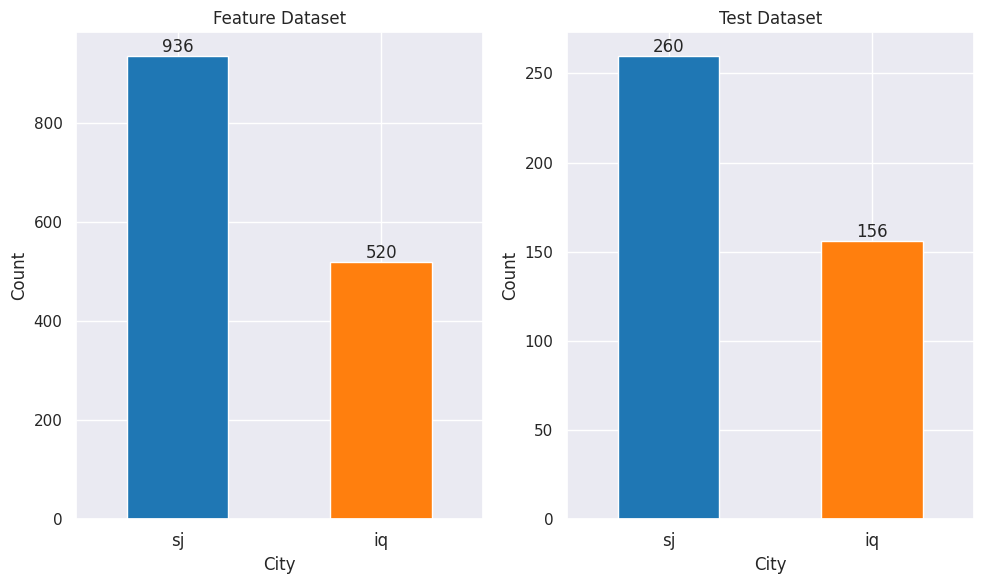

In [ ]:
# Histogram of Labels
import matplotlib.pyplot as plt
import pandas as pd
sns.set()


plt.figure(figsize=(10, 6))

colors_feature = plt.cm.tab20([0, 2])

plt.subplot(1, 2, 1)
bar1 = all_df_feature['city'].value_counts().plot(kind='bar', color=colors_feature)
plt.xlabel('City', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.title('Feature Dataset', fontsize=12)
plt.xticks(rotation=0, fontsize=12)

for index, value in enumerate(all_df_feature['city'].value_counts()):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12)


plt.subplot(1, 2, 2)
bar2 = all_df_test['city'].value_counts().plot(kind='bar', color=colors_feature)
plt.xlabel('City', fontsize=12)
plt.ylabel('Count', fontsize=12)
plt.title('Test Dataset', fontsize=12)
plt.xticks(rotation=0, fontsize=12)

for index, value in enumerate(all_df_test['city'].value_counts()):
    plt.text(index, value, str(value), ha='center', va='bottom', fontsize=12)

plt.tight_layout()
plt.show()

So, we split the dataset according to their cities

In [ ]:
# split Training Features
sj_df_feature = all_df_feature[all_df_feature['city'] == 'sj']
iq_df_feature = all_df_feature[all_df_feature['city'] == 'iq']
# split Training Labels
sj_df_label = all_df_label[all_df_label['city'] == 'sj']
iq_df_label = all_df_label[all_df_label['city'] == 'iq']
# split Testing data
sj_test_df = all_df_test[all_df_test['city'] == 'sj']
iq_test_df = all_df_test[all_df_test['city'] == 'iq']

## 1.2 Exploratory Data Analysis (EDA)

### For Label: Dengue fever cases
Distribution of dengue fever cases in Iquitos.  
It is known from Kernel density estimation (KDE) curve that the target has a negatively skewed distribution, not a normal distribution.

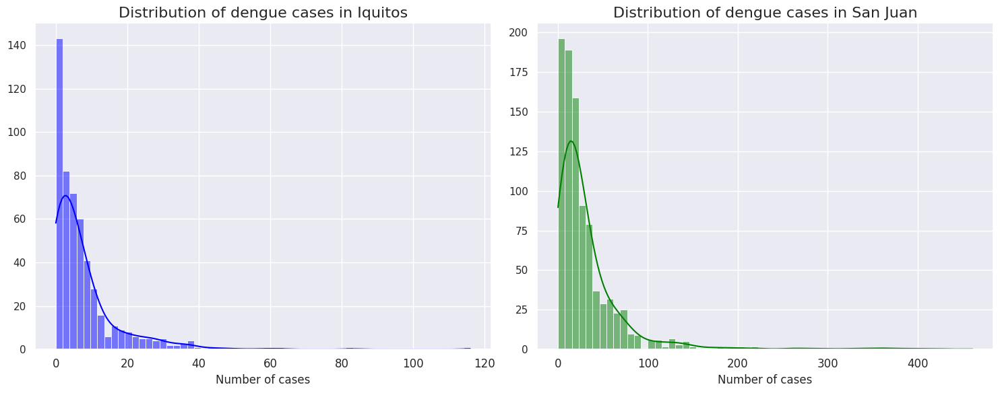

In [ ]:
# Distribution of dengue fever cases in Iquitos and San Juan with its Kernel density estimation (KDE) curve
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=[15, 6])

plt.subplot(1, 2, 1)
sns.histplot(iq_df_label.total_cases, bins=60, kde=True, color='blue')
plt.xticks(fontsize=12)
plt.title('Distribution of dengue cases in Iquitos', fontsize=16)
plt.xlabel('Number of cases', fontsize=12)
plt.ylabel('')

plt.subplot(1, 2, 2)
sns.histplot(sj_df_label.total_cases, bins=60, kde=True, color='green')
plt.xticks(fontsize=12)
plt.title('Distribution of dengue cases in San Juan', fontsize=16)
plt.xlabel('Number of cases', fontsize=12)
plt.ylabel('')
plt.tight_layout()
plt.show()



### For Features

General information of Features

In [ ]:
all_df_feature.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1456 entries, 0 to 1455
Data columns (total 24 columns):
 #   Column                                 Non-Null Count  Dtype  
---  ------                                 --------------  -----  
 0   city                                   1456 non-null   object 
 1   year                                   1456 non-null   int64  
 2   weekofyear                             1456 non-null   int64  
 3   week_start_date                        1456 non-null   object 
 4   ndvi_ne                                1262 non-null   float64
 5   ndvi_nw                                1404 non-null   float64
 6   ndvi_se                                1434 non-null   float64
 7   ndvi_sw                                1434 non-null   float64
 8   precipitation_amt_mm                   1443 non-null   float64
 9   reanalysis_air_temp_k                  1446 non-null   float64
 10  reanalysis_avg_temp_k                  1446 non-null   float64
 11  rean

#### For Iquitos (iq) city

#### Missing Data
In this data set, all missing values have been marked as NaN, so no further replacement is required.  
In the dataset for Iquitos, the feature with the highest number of missing values has 37 missing entries. Given this relatively small number.

In [ ]:
# Number of missing data in reverse order
iq_Missing_Value = iq_df_feature.isnull().sum()
iq_Missing_Value.sort_values(ascending=False)

station_diur_temp_rng_c                  37
station_avg_temp_c                       37
station_precip_mm                        16
station_max_temp_c                       14
station_min_temp_c                        8
reanalysis_min_air_temp_k                 4
reanalysis_tdtr_k                         4
reanalysis_specific_humidity_g_per_kg     4
reanalysis_sat_precip_amt_mm              4
reanalysis_relative_humidity_percent      4
reanalysis_precip_amt_kg_per_m2           4
reanalysis_max_air_temp_k                 4
reanalysis_dew_point_temp_k               4
reanalysis_avg_temp_k                     4
reanalysis_air_temp_k                     4
precipitation_amt_mm                      4
ndvi_sw                                   3
ndvi_se                                   3
ndvi_nw                                   3
ndvi_ne                                   3
year                                      0
week_start_date                           0
weekofyear                      

In [ ]:
sj_Missing_Value = sj_df_feature.isnull().sum()
sj_Missing_Value.sort_values(ascending=False)

ndvi_ne                                  191
ndvi_nw                                   49
ndvi_se                                   19
ndvi_sw                                   19
precipitation_amt_mm                       9
reanalysis_sat_precip_amt_mm               9
reanalysis_max_air_temp_k                  6
reanalysis_relative_humidity_percent       6
station_min_temp_c                         6
station_max_temp_c                         6
station_diur_temp_rng_c                    6
station_avg_temp_c                         6
reanalysis_tdtr_k                          6
reanalysis_specific_humidity_g_per_kg      6
station_precip_mm                          6
reanalysis_precip_amt_kg_per_m2            6
reanalysis_min_air_temp_k                  6
reanalysis_dew_point_temp_k                6
reanalysis_avg_temp_k                      6
reanalysis_air_temp_k                      6
year                                       0
week_start_date                            0
weekofyear

#### Check Features Distribution
Visualize other feature distributions by KDE Curve except year,
week_start_date, weekofyear, and city

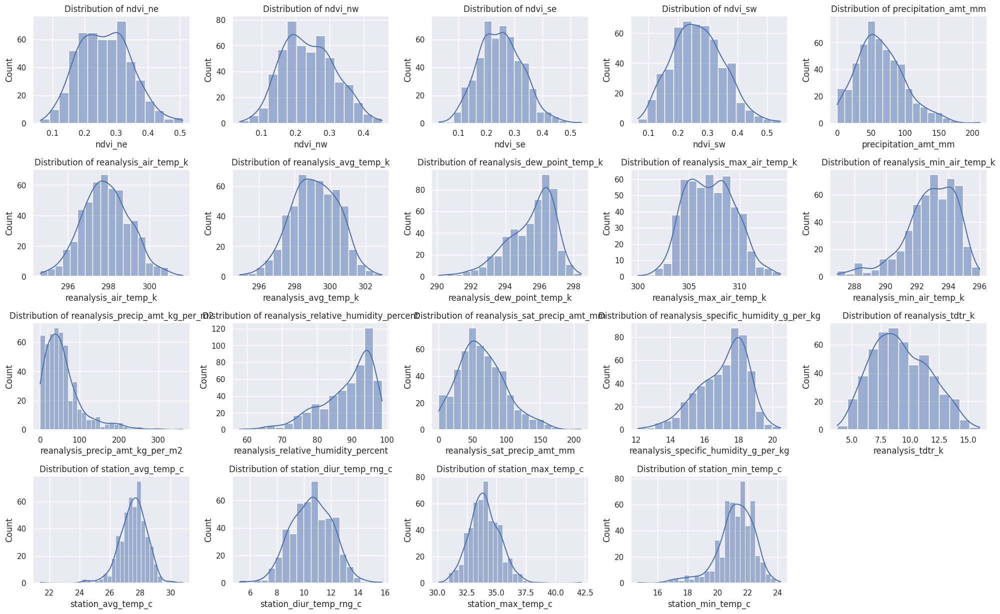

In [ ]:
iq_features_to_visualize = iq_df_feature.columns[4:-1]

n_rows = 5
n_cols = 5

plt.figure(figsize=(20, 15))
for i, feature in enumerate(iq_features_to_visualize, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.histplot(iq_df_feature[feature], kde=True)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()

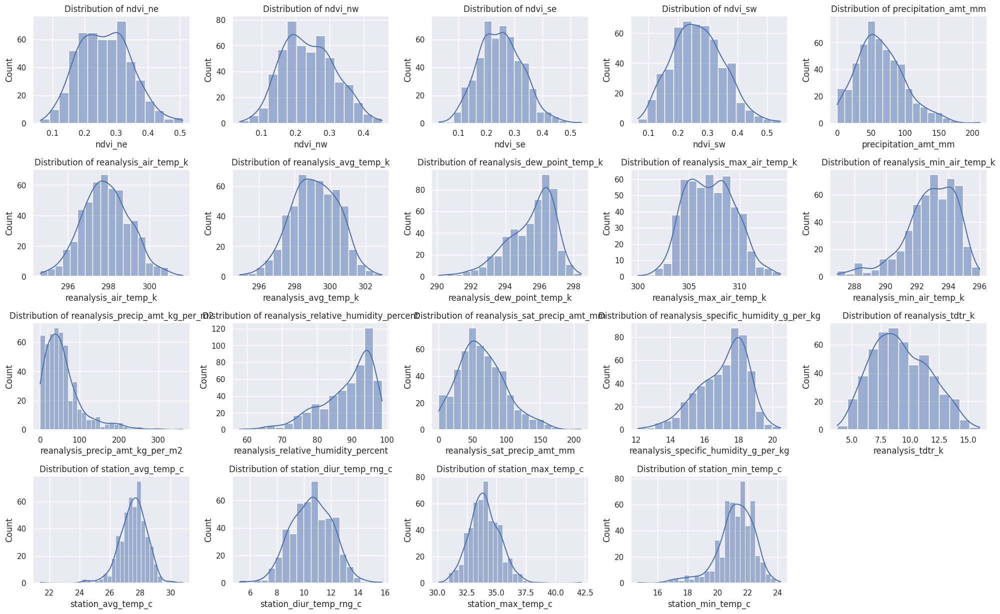

In [ ]:
sj_features_to_visualize = sj_df_feature.columns[4:-1]

n_rows = 5
n_cols = 5

plt.figure(figsize=(20, 15))
for i, feature in enumerate(sj_features_to_visualize, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.histplot(iq_df_feature[feature], kde=True)
    plt.title(f'Distribution of {feature}')

plt.tight_layout()
plt.show()

#### Find possible outliers
Use boxplots to find possible outliers.  
For some features (like station_max_temp_c and precipitation_amt_mm) it may have some outliers

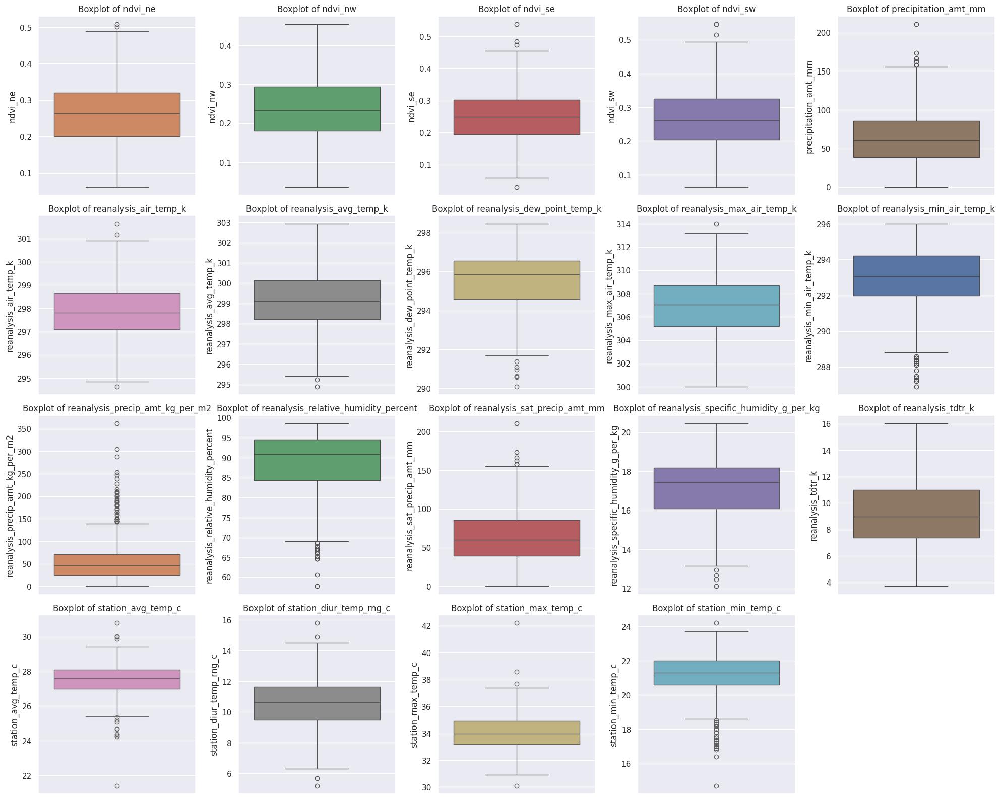

In [ ]:
plt.figure(figsize=(20, 20))

# Get a random colour
palette = sns.color_palette()

for i, feature in enumerate(iq_features_to_visualize, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(y=iq_df_feature[feature], color=palette[i % len(palette)])
    plt.title(f'Boxplot of {feature}')

plt.tight_layout()
plt.show()

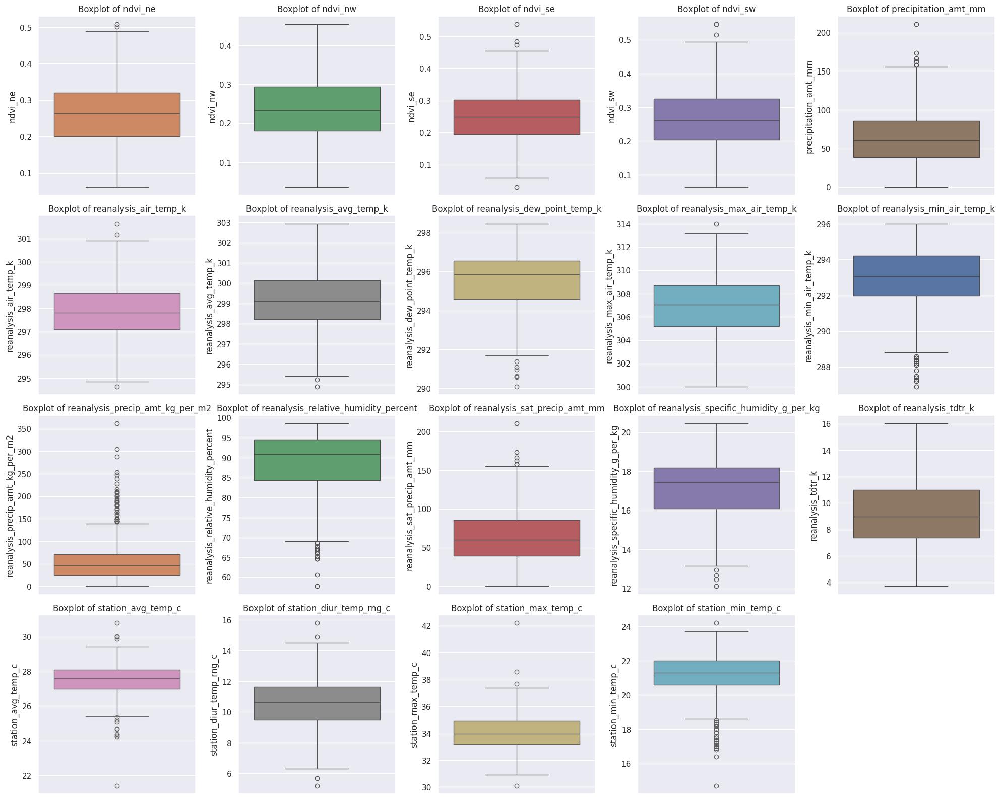

In [ ]:
plt.figure(figsize=(20, 20))

# Get a random colour
palette = sns.color_palette()

for i, feature in enumerate(sj_features_to_visualize, 1):
    plt.subplot(n_rows, n_cols, i)
    sns.boxplot(y=iq_df_feature[feature], color=palette[i % len(palette)])
    plt.title(f'Boxplot of {feature}')

plt.tight_layout()
plt.show()

#### Correlation analysis
Draw a heat map of the correlation between features

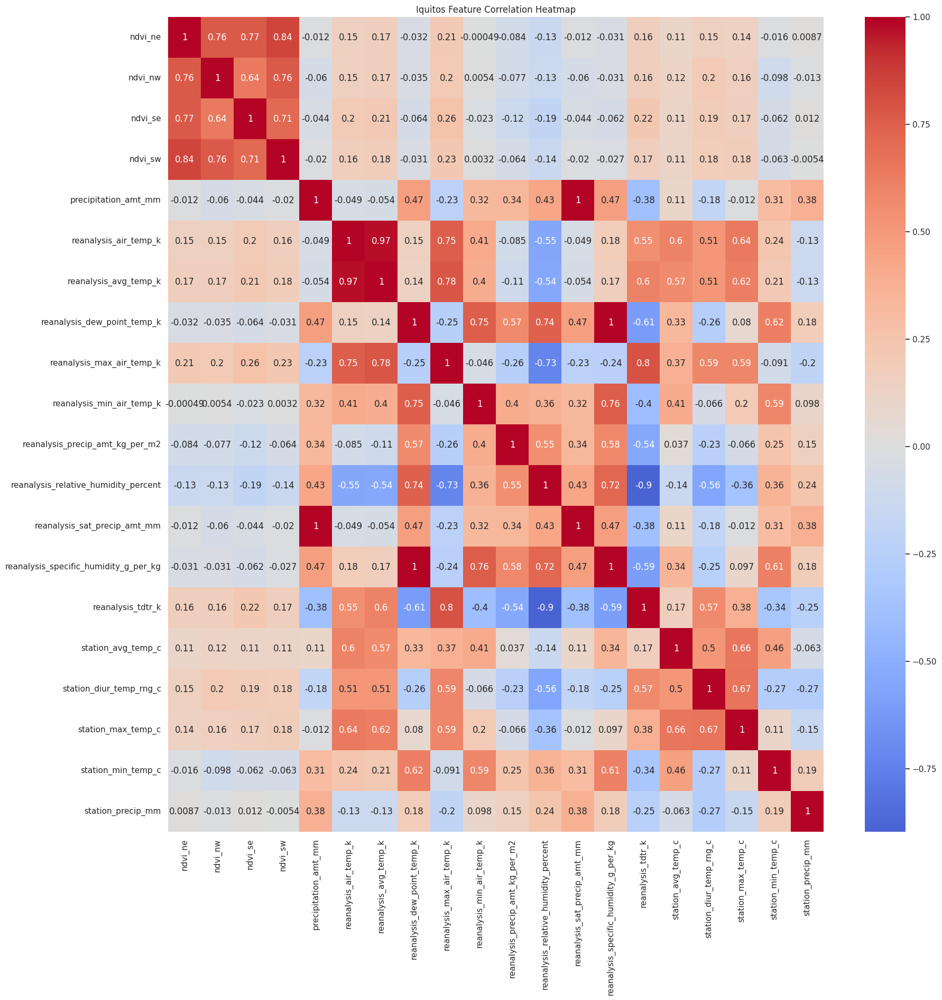

In [ ]:
iq_df_feature_without_time = iq_df_feature.drop(['year', 'weekofyear','week_start_date','city'], axis=1)
iq_df_feature
corr_iq = iq_df_feature_without_time.corr()
plt.figure(figsize=(20,20))
sns.heatmap(corr_iq, annot=True, cmap='coolwarm', center=0)
plt.title('Iquitos Feature Correlation Heatmap')
plt.show()

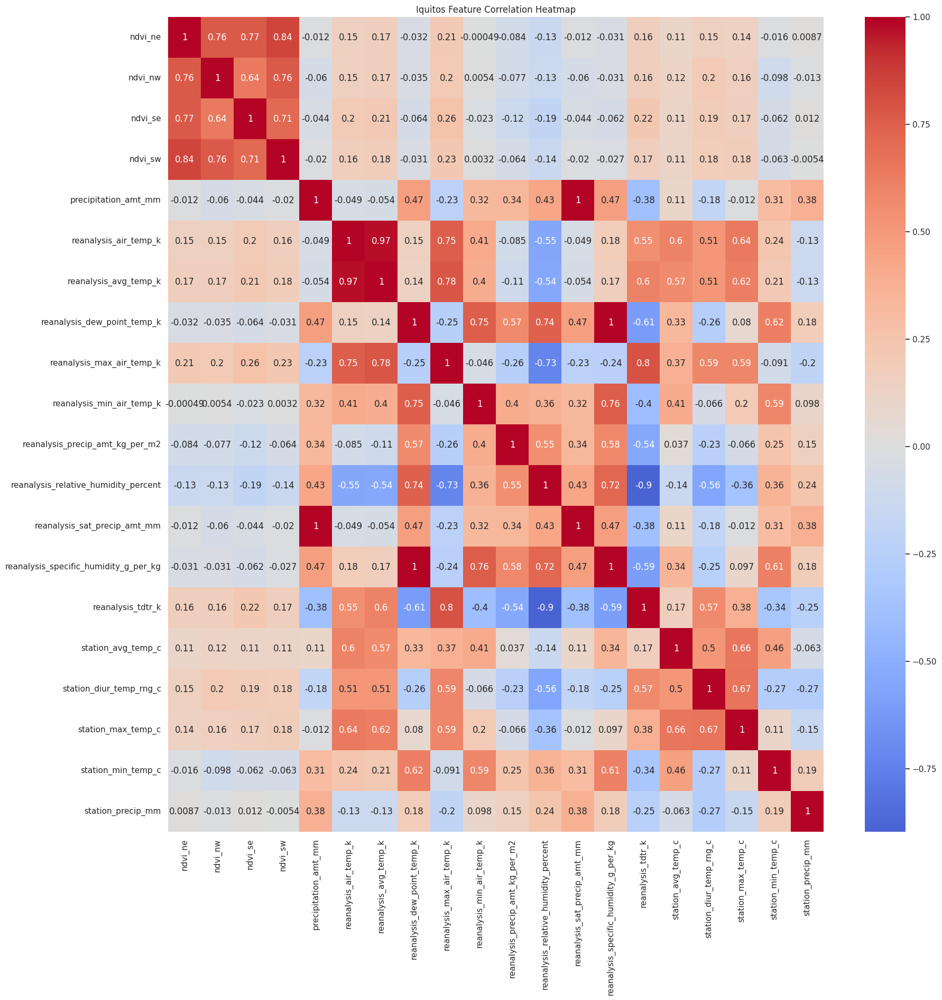

In [ ]:
sj_df_feature_without_time = sj_df_feature.drop(['year', 'weekofyear','week_start_date','city'], axis=1)
sj_df_feature
corr_sj = sj_df_feature_without_time.corr()
plt.figure(figsize=(20,20))
sns.heatmap(corr_iq, annot=True, cmap='coolwarm', center=0)
plt.title('Iquitos Feature Correlation Heatmap')
plt.show()

After the preparation of data, we started working based on our ideas

======================================================================================================================================================================================================================================

In this experiment, the negative binomial regression model is used first because the total case of this dataset belongs to the negative binomial distribution, therefore the negative binomial regression model is selected for training. Secondly, Support Vector Regression(SVR) is chosen, as it has a good performance in solving regression problems. Thirdly, the main reason for selecting eXtreme Gradient Boosting (eXtreme Gradient Boosting) as the third model is that it performs excellently in the robustness to outliers in the prediction accuracy.

three different feature engineering methods are applied before training our models three times each. The first feature engineering is using the original data after being filled. The second feature engineering is to use an average sliding window of 2 units to modify the original data. The purpose of this is to make the data smoother and reduce the error of the data. The third feature engineering is to fill the data of the current week with the data of the previous two weeks. The reason for using this is that environmental factors can affect the growth cycle of mosquitoes with a time lag, which may subsequently influence dengue outbreaks. Moreover, before each training using SVR, it is necessary to scale the feature to avoid the impact of differing scales among features.

## 2. Data Pre-processing


According to what was mentioned before in the city part of 1.1 in this task, iq and sj will be used as two parts for data preprocessing and modeling separately

define fuction to fill miss data

The fill_missing_with_neighbors function fills in missing values in a DataFrame by interpolating between adjacent rows. It replaces missing values by averaging the nearest available values before and after the missing value, using the nearest available value if only one neighbor is present.

In [ ]:
def fill_missing_with_neighbors(df):

    for column in df.columns:
        for i in range(len(df)):
            if pd.isnull(df.iloc[i][column]):
                prev_val = df.iloc[i-1][column] if i-1 >= 0 else np.nan
                next_val = df.iloc[i+1][column] if i+1 < len(df) else np.nan
                if pd.notnull(prev_val) and pd.notnull(next_val):
                    df.iloc[i, df.columns.get_loc(column)] = (prev_val + next_val) / 2
                elif pd.notnull(prev_val):
                    df.iloc[i, df.columns.get_loc(column)] = prev_val
                elif pd.notnull(next_val):
                    df.iloc[i, df.columns.get_loc(column)] = next_val

    return df

Define an individual's work dataframe  
  
  
all_df_train_feature_tan: training set
  
all_df_train_label_tan: training set label
  
all_df_test_tan: test set
  

In [ ]:
all_df_train_feature_tan = all_df_feature.copy()
all_df_train_feature_tan = all_df_train_feature_tan.set_index(['city', 'year', 'weekofyear','week_start_date'])

all_df_train_label_tan = all_df_label.copy()
all_df_train_label_tan = all_df_train_label_tan.set_index(['city', 'year', 'weekofyear'])

all_df_test_tan = all_df_test.copy()
all_df_test_tan = all_df_test_tan.set_index(['city', 'year', 'weekofyear','week_start_date'])

Split cities and merge labels

In [ ]:
# Seperate data for San Juan
sj_train_features_tan = all_df_train_feature_tan.loc['sj']
sj_train_labels_tan = all_df_train_label_tan.loc['sj']
sj_test_tan = all_df_test_tan.loc['sj']
# Separate data for Iquitos
iq_train_features_tan = all_df_train_feature_tan.loc['iq']
iq_train_labels_tan = all_df_train_label_tan.loc['iq']
iq_test_tan = all_df_test_tan.loc['iq']


Merge labels into the dataset of features

In [ ]:
sj_train_features_tan = sj_train_features_tan.copy()
iq_train_features_tan = iq_train_features_tan.copy()

sj_train_features_tan['total_cases'] = sj_train_labels_tan['total_cases'].values
iq_train_features_tan['total_cases'] = iq_train_labels_tan['total_cases'].values

using fill_missing_with_neighbors function to fill miss data which were missed on train test and test set

In [ ]:
sj_train_filled_tan = fill_missing_with_neighbors(sj_train_features_tan.copy())
iq_train_filled_tan = fill_missing_with_neighbors(iq_train_features_tan.copy())
sj_test_filled_tan = fill_missing_with_neighbors(sj_test_tan.copy())
iq_test_filled_tan = fill_missing_with_neighbors(iq_test_tan.copy())


Define a line chart that depicts the relationship between the model training data and the actual data.Used to see if the model is overfitting

In [ ]:
def plot_train_predictions_vs_actual(model, train_X, train_y, title):
    predictions = model.predict(train_X)

    dates = train_y.index.get_level_values('week_start_date')

    dates = pd.to_datetime(dates)

    if len(predictions) != len(train_y):
        raise ValueError("Predictions and actual values must have the same length.")

    plt.figure(figsize=(15, 6))
    plt.plot(dates, train_y.values, label='Actual', color='orange', linewidth=2)
    plt.plot(dates, predictions, label='Predictions', color='blue', linestyle='dashed', linewidth=2)
    plt.xlabel('Date')
    plt.ylabel('Total Cases')
    plt.title(title)
    plt.legend()
    plt.grid(True)


    ax = plt.gca()
    ax.xaxis.set_major_locator(mdates.MonthLocator(bymonth=(1, 7)))
    ax.xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

    plt.xticks(rotation=45)
    plt.show()


## 3. First time feature engineering and modelling


In this part I will perform feature selection on the raw data, train the model, and generate predictions.

The main model I use is Negative Binomial Regression，Support Vector Regression(SVR),eXtreme Gradient Boosting(XGBoost)

### 3.1 Feature selection  
  


The approach for this analysis involves two steps.  
The general idea of this part is to first select correlated features to the label, and then conduct correlation analysis between features.

In [ ]:
corr_iq_tan = iq_train_filled_tan.corr()
coor_sj_tan = sj_train_filled_tan.corr()

Generate a correlation graph about total case(iq) with all other columns

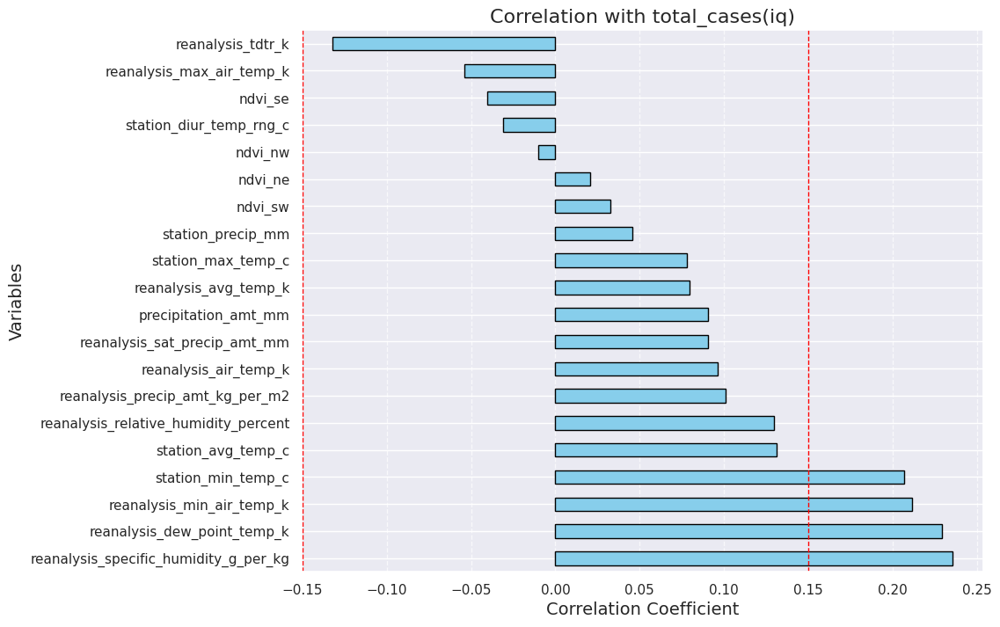

In [ ]:
# Sorting correlations
sorted_corr_iq_tan= corr_iq_tan['total_cases'].drop('total_cases').sort_values(ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
ax = sorted_corr_iq_tan.plot(kind='barh', color='skyblue', edgecolor='black')
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Variables', fontsize=14)
plt.title('Correlation with total_cases(iq)', fontsize=16)
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Add horizontal lines at 0.1 and -0.1
plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)
plt.axvline(x=-0.15, color='red', linestyle='--', linewidth=1)

plt.show()

Generate a correlation graph about total case(sj) with all other columns

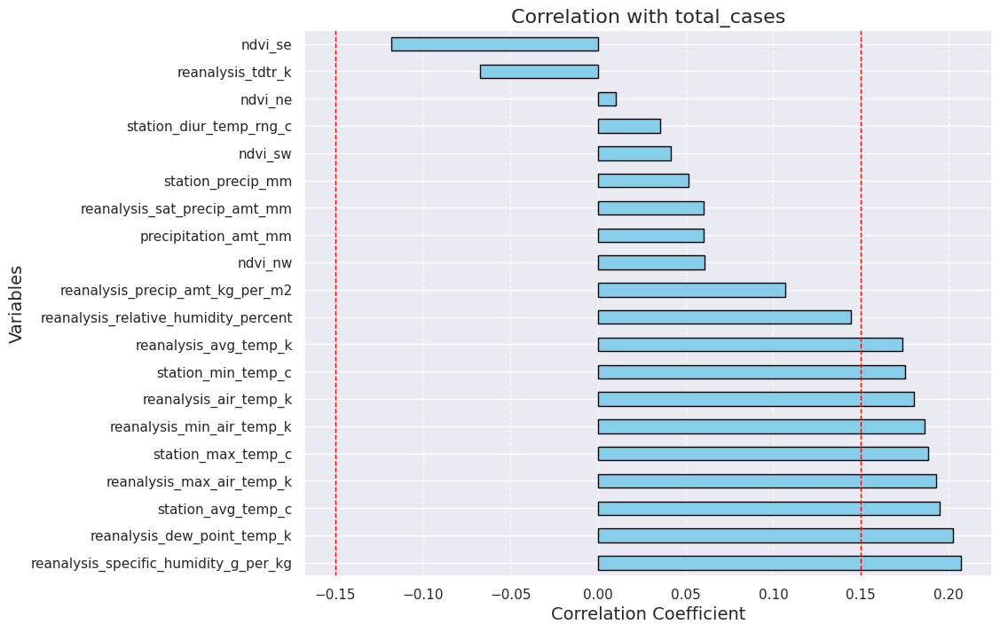

In [ ]:
# Sorting correlations
sorted_coor_sj_tan= coor_sj_tan['total_cases'].drop('total_cases').sort_values(ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
ax = sorted_coor_sj_tan.plot(kind='barh', color='skyblue', edgecolor='black')
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Variables', fontsize=14)
plt.title('Correlation with total_cases', fontsize=16)
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Add horizontal lines at 0.1 and -0.1
plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)
plt.axvline(x=-0.15, color='red', linestyle='--', linewidth=1)

plt.show()

In [ ]:
sorted_coor_sj_tan

reanalysis_specific_humidity_g_per_kg    0.206942
reanalysis_dew_point_temp_k              0.202807
station_avg_temp_c                       0.194823
reanalysis_max_air_temp_k                0.193233
station_max_temp_c                       0.188447
reanalysis_min_air_temp_k                0.186539
reanalysis_air_temp_k                    0.180311
station_min_temp_c                       0.175248
reanalysis_avg_temp_k                    0.173670
reanalysis_relative_humidity_percent     0.144404
reanalysis_precip_amt_kg_per_m2          0.106939
ndvi_nw                                  0.060824
precipitation_amt_mm                     0.060296
reanalysis_sat_precip_amt_mm             0.060296
station_precip_mm                        0.051883
ndvi_sw                                  0.041482
station_diur_temp_rng_c                  0.035303
ndvi_ne                                  0.010153
reanalysis_tdtr_k                       -0.067623
ndvi_se                                 -0.117986


In [ ]:
sorted_corr_iq_tan

reanalysis_specific_humidity_g_per_kg    0.235218
reanalysis_dew_point_temp_k              0.229183
reanalysis_min_air_temp_k                0.211679
station_min_temp_c                       0.206817
station_avg_temp_c                       0.131336
reanalysis_relative_humidity_percent     0.129486
reanalysis_precip_amt_kg_per_m2          0.101150
reanalysis_air_temp_k                    0.096327
reanalysis_sat_precip_amt_mm             0.090628
precipitation_amt_mm                     0.090628
reanalysis_avg_temp_k                    0.079515
station_max_temp_c                       0.078162
station_precip_mm                        0.045723
ndvi_sw                                  0.032812
ndvi_ne                                  0.020794
ndvi_nw                                 -0.009952
station_diur_temp_rng_c                 -0.030883
ndvi_se                                 -0.040643
reanalysis_max_air_temp_k               -0.054175
reanalysis_tdtr_k                       -0.132191


The definition selection targets the different characteristics of the two cities



The columns were selected based on the cases in each city as well as the correlation between the environmental indicators

By correlation analysis, reanalysis_air_temp_k and reanalysis_avg_temp_k represent the same thing, so one is dropped


In [ ]:
first_selection_sj_tan = [
    'reanalysis_specific_humidity_g_per_kg',
    'station_avg_temp_c','reanalysis_max_air_temp_k','station_max_temp_c','reanalysis_min_air_temp_k','reanalysis_air_temp_k','station_min_temp_c'
]
first_selection_iq_tan = [
    'reanalysis_specific_humidity_g_per_kg','reanalysis_min_air_temp_k','station_min_temp_c'
]

The data sets of the two cities are divided into training set and validation set

In [ ]:
sj_first_train_tan = sj_train_filled_tan.copy()
iq_first_train_tan = iq_train_filled_tan.copy()

# San Juan
sj_train_size = int(0.85 * sj_first_train_tan.shape[0])
sj_first_train_subtrain_tan = sj_first_train_tan.head(sj_train_size)
sj_first_train_subtest_tan = sj_first_train_tan.tail(sj_first_train_tan.shape[0] - sj_train_size)

# Iquitos
iq_train_size = int(0.85 * iq_first_train_tan.shape[0])
iq_first_train_subtrain_tan = iq_first_train_tan.head(iq_train_size)
iq_first_train_subtest_tan = iq_first_train_tan.tail(iq_first_train_tan.shape[0] - iq_train_size)
sj_first_train_subtrain_tan

ndvi_ne   ndvi_nw   ndvi_se   ndvi_sw  \
year weekofyear week_start_date                                           
1990 18         1990-04-30       0.122600  0.103725  0.198483  0.177617   
     19         1990-05-07       0.169900  0.142175  0.162357  0.155486   
     20         1990-05-14       0.032250  0.172967  0.157200  0.170843   
     21         1990-05-21       0.128633  0.245067  0.227557  0.235886   
     22         1990-05-28       0.196200  0.262200  0.251200  0.247340   
...                                   ...       ...       ...       ...   
2005 27         2005-07-09       0.085400  0.246675  0.171786  0.238100   
     28         2005-07-16       0.051400  0.051625  0.112257  0.137014   
     29         2005-07-23      -0.066500 -0.021000  0.235829  0.233343   
     30         2005-07-30      -0.108700 -0.009450  0.256443  0.215371   
     31         2005-08-06      -0.064750 -0.026700  0.140400  0.121200   

                                 precipitation_amt_mm  reanalysis_air_temp_k  \
year weekofyear week_start_date                                                
1990 18         1990-04-30                      12.42             297.572857   
     19         1990-05-07                      22.82             298.211429   
     20         1990-05-14                      34.54             298.781429   
     21         1990-05-21                      15.36             298.987143   
     22         1990-05-28                       7.52             299.518571   
...                                               ...                    ...   
2005 27         2005-07-09                      42.06             301.281429   
     28         2005-07-16                      92.52             300.667143   
     29         2005-07-23                      39.49             300.871429   
     30         2005-07-30                      64.25             300.852857   
     31         2005-08-06                      80.34             301.158571   

                                 reanalysis_avg_temp_k  \
year weekofyear week_start_date                          
1990 18         1990-04-30                  297.742857   
     19         1990-05-07                  298.442857   
     20         1990-05-14                  298.878571   
     21         1990-05-21                  299.228571   
     22         1990-05-28                  299.664286   
...                                                ...   
2005 27         2005-07-09                  301.285714   
     28         2005-07-16                  300.621429   
     29         2005-07-23                  300.892857   
     30         2005-07-30                  300.921429   
     31         2005-08-06                  301.107143   

                                 reanalysis_dew_point_temp_k  \
year weekofyear week_start_date                                
1990 18         1990-04-30                        292.414286   
     19         1990-05-07                        293.951429   
     20         1990-05-14                        295.434286   
     21         1990-05-21                        295.310000   
     22         1990-05-28                        295.821429   
...                                                      ...   
2005 27         2005-07-09                        297.364286   
     28         2005-07-16                        297.000000   
     29         2005-07-23                        296.981429   
     30         2005-07-30                        297.580000   
     31         2005-08-06                        297.291429   

                                 reanalysis_max_air_temp_k  \
year weekofyear week_start_date                              
1990 18         1990-04-30                           299.8   
     19         1990-05-07                           300.9   
     20         1990-05-14                           300.5   
     21         1990-05-21                           301.4   
     22         1990-05-28                           301.

### 3.2 First time negative binomial regression modelling

The negative binomial regression model was chosen because it was concluded in the data exploration section that the dataset obeds negative binomial regression, trained on the confirmed features.

In [ ]:
from statsmodels.tools import eval_measures
import statsmodels.formula.api as smf
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
from statsmodels.genmod.families import NegativeBinomial
from time import time
sj_first_model_formula = (
    "total_cases ~ 1 + "
    "reanalysis_specific_humidity_g_per_kg + "
    "station_avg_temp_c + "
    "reanalysis_max_air_temp_k + "
    "station_max_temp_c + "
    "reanalysis_min_air_temp_k + "
    "reanalysis_air_temp_k + "
    "station_min_temp_c "
)

iq_first_model_formula = (
    "total_cases ~ 1 + "
    "reanalysis_specific_humidity_g_per_kg + "
    "reanalysis_min_air_temp_k + "
    "station_min_temp_c"
)

def negative_binomial_regression_model(train, test, formula, alpha=1.0):
    grid = 10 ** np.arange(-8, -3, dtype=np.float64)

    best_alpha = None
    best_score = np.inf

    start_time = time()
    for penalty in grid:
        model = smf.glm(formula=formula, data=train, family=NegativeBinomial(alpha=alpha))

        results = model.fit()
        predictions = results.predict(test).astype(int)
        score = eval_measures.meanabs(predictions, test.total_cases)

        if score < best_score:
            best_alpha = penalty
            best_score = score
    end_time = time()
    elapsed_time = end_time - start_time

    print('MAE:', best_score)
    print('alpha:', best_alpha)
    print('Training time: {:.2f} seconds'.format(elapsed_time))

    full_dataset = pd.concat([train, test])
    model = smf.glm(formula=formula, data=full_dataset, family=NegativeBinomial(alpha=alpha))
    fitted_model = model.fit()
    return fitted_model

first_sj_best_model = negative_binomial_regression_model(sj_first_train_subtrain_tan, sj_first_train_subtest_tan, sj_first_model_formula)
first_iq_best_model = negative_binomial_regression_model(iq_first_train_subtrain_tan, iq_first_train_subtest_tan, iq_first_model_formula)

MAE: 23.81560283687943
alpha: 1e-08
Training time: 0.20 seconds
MAE: 5.243589743589744
alpha: 1e-08
Training time: 0.10 seconds


Plot the predictions versus the actual results from the trained model

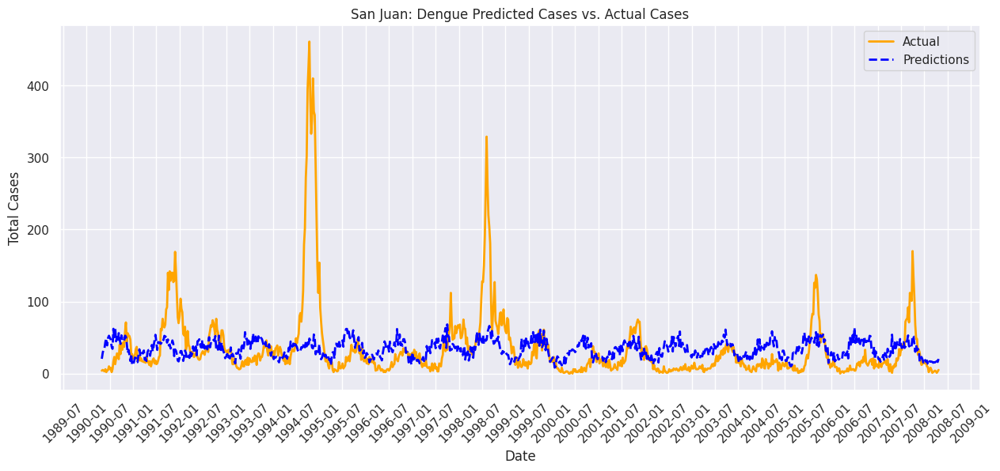

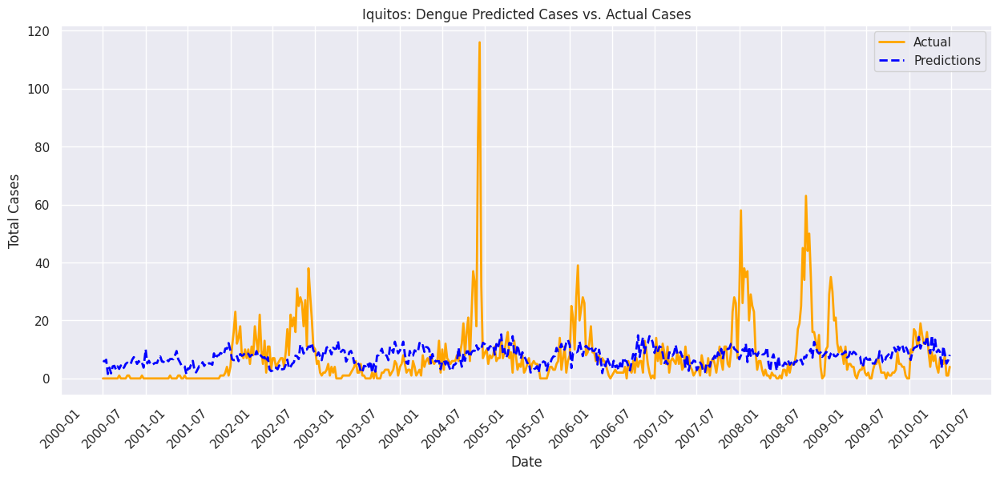

In [ ]:

sj_train_X = sj_first_train_tan.drop(columns='total_cases')
sj_train_y = sj_first_train_tan['total_cases']

iq_train_X = iq_first_train_tan.drop(columns='total_cases')
iq_train_y = iq_first_train_tan['total_cases']

plot_train_predictions_vs_actual(first_sj_best_model, sj_train_X, sj_train_y, 'San Juan: Dengue Predicted Cases vs. Actual Cases')

plot_train_predictions_vs_actual(first_iq_best_model, iq_train_X, iq_train_y, 'Iquitos: Dengue Predicted Cases vs. Actual Cases')

Generating prediction files

In [ ]:
first_sj_best_model_predictions = first_sj_best_model.predict(sj_test_filled_tan).astype(int)
first_iq_best_model_predictions = first_iq_best_model.predict(iq_test_filled_tan).astype(int)

submission = pd.read_csv("submission_format.csv",index_col=[0, 1, 2])

submission.total_cases = np.concatenate([first_sj_best_model_predictions, first_iq_best_model_predictions])
submission.to_csv("first_negative_binomial_regression.csv")

WOW It was submitted on the official website with a score of 26.1250

### 3.3 First time SVR modelling

Next, the svr model is used for training

get_first_svr_best_params_sj(),get_first_svr_best_params_iq()were used to define the optimal parameters of the svr model for the grid search to find sj and iq

In [ ]:

# function to perform a grid search and return the best parameters
def get_first_svr_best_params_sj(X_train, y_train):
    svr = SVR()
    svr_first_grid_sj_tan = {
    'C': [0.1, 0.05, 0.01],
    'epsilon': [ 0.05, 0.08],
    'kernel': ['linear']}
    grid = GridSearchCV(svr, svr_first_grid_sj_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

def get_first_svr_best_params_iq(X_train, y_train):
    svr = SVR()
    svr_first_grid_iq_tan = {
    'C': [ 120, 130, 140],
    'epsilon': [0.01, 0.02, 0.03],
    'kernel': ['linear']}
    grid = GridSearchCV(svr, svr_first_grid_iq_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_




Define the method of svr model for reuse

In [ ]:

# Define functions to train, evaluate, and retrain the model
def svr_regression_model(train_X, train_y, test_X, test_y, model_params):

    model = SVR(**model_params)
    model.fit(train_X, train_y)

    predictions = model.predict(test_X)

    mae = mean_absolute_error(test_y, predictions)
    mse = mean_squared_error(test_y, predictions)

    print(f'MAE: {mae:.4f}')


    full_X = pd.concat([pd.DataFrame(train_X), pd.DataFrame(test_X)], axis=0)
    full_y = pd.concat([pd.Series(train_y), pd.Series(test_y)], axis=0)

    final_model = SVR(**model_params)
    final_model.fit(full_X, full_y)

    return final_model

Define the parameters used to train the svr model

In [ ]:
target = 'total_cases'
# Extract features and target variables
X_first_svr_sj_train_tan = sj_first_train_subtrain_tan[first_selection_sj_tan]
y_first_svr_sj_train_tan = sj_first_train_subtrain_tan[target]
X_first_svr_sj_test_tan = sj_first_train_subtest_tan[first_selection_sj_tan]
y_first_svr_sj_test_tan = sj_first_train_subtest_tan[target]

X_first_svr_iq_train_tan = iq_first_train_subtrain_tan[first_selection_iq_tan]
y_first_svr_iq_train_tan = iq_first_train_subtrain_tan[target]
X_first_svr_iq_test_tan = iq_first_train_subtest_tan[first_selection_iq_tan]
y_first_svr_iq_test_tan = iq_first_train_subtest_tan[target]


sj_svr_first_test =  sj_test_filled_tan[first_selection_sj_tan]
iq_svr_first_test =  iq_test_filled_tan[first_selection_iq_tan]

Because the svr model is sensitive to data, the numerical difference of some features is large, so the features need to be scaled

In [ ]:

first_svr_scaler_sj_tan = StandardScaler()
first_svr_scaler_iq_tan = StandardScaler()

X_first_svr_sj_train_scaled_tan = first_svr_scaler_sj_tan.fit_transform(X_first_svr_sj_train_tan)
X_first_svr_sj_test_scaled_tan = first_svr_scaler_sj_tan.transform(X_first_svr_sj_test_tan)

X_first_svr_iq_train_scaled_tan = first_svr_scaler_iq_tan.fit_transform(X_first_svr_iq_train_tan)
X_first_svr_iq_test_scaled_tan = first_svr_scaler_iq_tan.transform(X_first_svr_iq_test_tan)

sj_svr_first_test_scaled = first_svr_scaler_sj_tan.transform(sj_svr_first_test)
iq_svr_first_test_scaled = first_svr_scaler_iq_tan.transform(iq_svr_first_test)


The best parameters are obtained after grid training

In [ ]:
sj_best_params = get_first_svr_best_params_sj(X_first_svr_sj_train_scaled_tan, y_first_svr_sj_train_tan)
iq_best_params = get_first_svr_best_params_iq(X_first_svr_iq_train_scaled_tan, y_first_svr_iq_train_tan)

print("SJ best param:", sj_best_params)
print("IQ best param:", iq_best_params)


SJ best param: {'C': 0.01, 'epsilon': 0.05, 'kernel': 'linear'}
IQ best param: {'C': 130, 'epsilon': 0.03, 'kernel': 'linear'}


Use the above function to evaluate and retrain the model

In [ ]:
sj_svr_first_model = svr_regression_model(X_first_svr_sj_train_scaled_tan, y_first_svr_sj_train_tan,
                                      X_first_svr_sj_test_scaled_tan, y_first_svr_sj_test_tan,
                                      sj_best_params)

iq_svr_first_model = svr_regression_model(X_first_svr_iq_train_scaled_tan, y_first_svr_iq_train_tan,
                                      X_first_svr_iq_test_scaled_tan, y_first_svr_iq_test_tan,
                                      iq_best_params)

MAE: 20.8359
MAE: 4.5465


The svr model is called to predict, and the prediction file is generated

In [ ]:

svr_first_sj_predictions = sj_svr_first_model.predict(sj_svr_first_test_scaled).astype(int)
svr_first_iq_predictions = iq_svr_first_model.predict(iq_svr_first_test_scaled).astype(int)

submission = pd.read_csv("submission_format.csv", index_col=[0, 1, 2])

submission.total_cases = np.concatenate([svr_first_sj_predictions, svr_first_iq_predictions])

submission.to_csv("first_svr.csv")

In [ ]:
pd.concat([y_first_svr_sj_train_tan, y_first_svr_sj_test_tan])
# X_first_svr_sj_train_scaled_tan

year  weekofyear  week_start_date
1990  18          1990-04-30         4
      19          1990-05-07         5
      20          1990-05-14         4
      21          1990-05-21         3
      22          1990-05-28         6
                                    ..
2008  13          2008-03-25         4
      14          2008-04-01         3
      15          2008-04-08         1
      16          2008-04-15         3
      17          2008-04-22         5
Name: total_cases, Length: 936, dtype: int64

Plot the predictions versus the actual results from the trained model

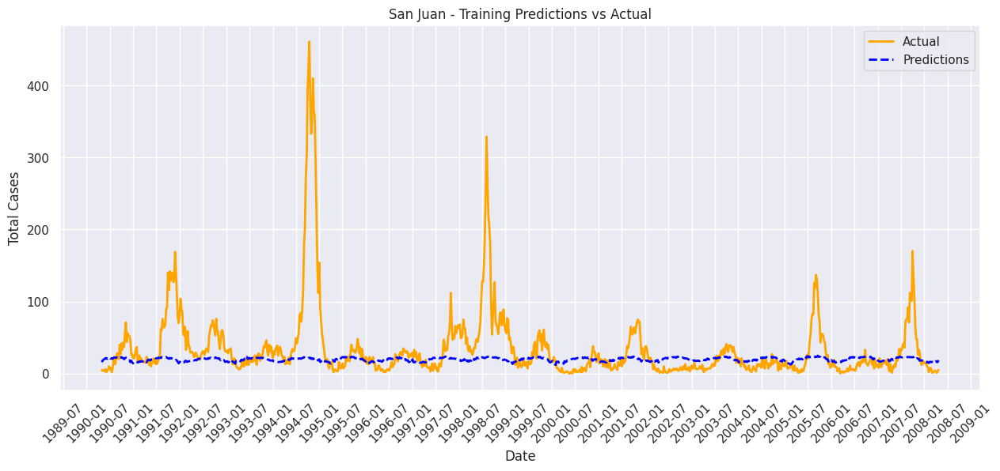

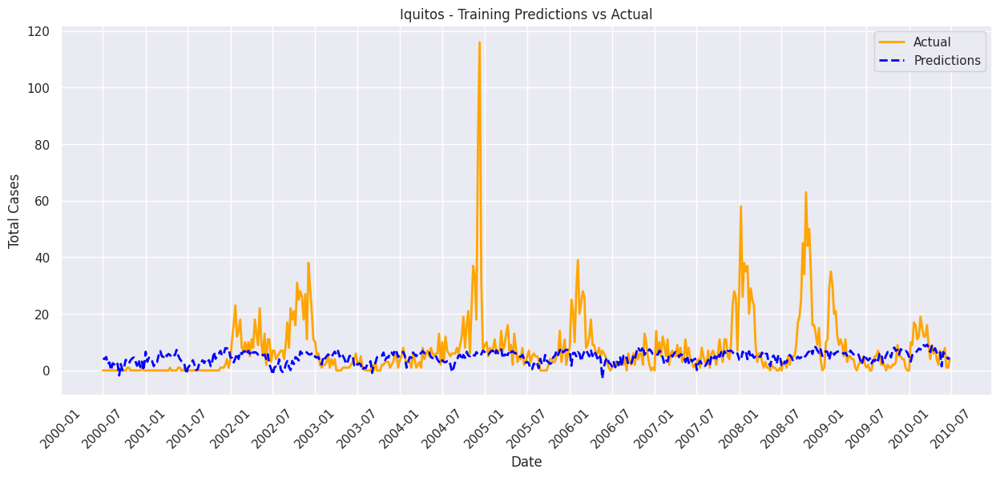

In [ ]:
plot_train_predictions_vs_actual(sj_svr_first_model, pd.concat([pd.DataFrame(X_first_svr_sj_train_scaled_tan), pd.DataFrame(X_first_svr_sj_test_scaled_tan)]),
                                 pd.concat([y_first_svr_sj_train_tan, y_first_svr_sj_test_tan]).astype(int),
                                 "San Juan - Training Predictions vs Actual")

plot_train_predictions_vs_actual(iq_svr_first_model,  pd.concat([pd.DataFrame(X_first_svr_iq_train_scaled_tan), pd.DataFrame(X_first_svr_iq_test_scaled_tan)]),
                                 pd.concat([y_first_svr_iq_train_tan, y_first_svr_iq_test_tan]).astype(int),
                                 "Iquitos - Training Predictions vs Actual")

WOW It was submitted on the official website with a score of 28.3918

### 3.4 First time XGboost modelling

get_first_xgb_best_params_sj(),get_first_xgb_best_params_iq() is performed on the models corresponding to sj and iq to find the best parameters,

In [ ]:
def get_first_xgb_best_params_sj(X_train, y_train):
    xgb = XGBRegressor()
    xgb_first_grid_sj_tan = {
        'learning_rate': [0.01, 0.05, 0.03],
        'n_estimators': [100, 80, 90],
        'max_depth': [3, 4, 5]
    }
    grid = GridSearchCV(xgb, xgb_first_grid_sj_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

def get_first_xgb_best_params_iq(X_train, y_train):
    xgb = XGBRegressor()
    xgb_first_grid_iq_tan = {
        'learning_rate': [0.01, 0.05, 0.03],
        'n_estimators': [100, 80, 90],
        'max_depth': [3, 4, 5]
    }
    grid = GridSearchCV(xgb, xgb_first_grid_iq_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

xgb methods are defined for reuse

In [ ]:
def xgb_regression_model(train_X, train_y, test_X, test_y, model_params):
    model = XGBRegressor(**model_params)
    model.fit(train_X, train_y)
    predictions = model.predict(test_X)
    mae = mean_absolute_error(test_y, predictions)
    mse = mean_squared_error(test_y, predictions)
    print(f'MAE: {mae:.4f}')
    full_X = np.concatenate([train_X, test_X], axis=0)
    full_y = np.concatenate([train_y, test_y], axis=0)
    final_model = XGBRegressor(**model_params)
    final_model.fit(full_X, full_y)
    return final_model




Define the parameters used to train the xgb model

In [ ]:

X_first_xgb_sj_train = sj_first_train_subtrain_tan[first_selection_sj_tan]
y_first_xgb_sj_train = sj_first_train_subtrain_tan[target]
X_first_xgb_sj_test = sj_first_train_subtest_tan[first_selection_sj_tan]
y_first_xgb_sj_test = sj_first_train_subtest_tan[target]

X_first_xgb_iq_train = iq_first_train_subtrain_tan[first_selection_iq_tan]
y_first_xgb_iq_train = iq_first_train_subtrain_tan[target]
X_first_xgb_iq_test = iq_first_train_subtest_tan[first_selection_iq_tan]
y_first_xgb_iq_test = iq_first_train_subtest_tan[target]


Call a grid search to find the best parameters

In [ ]:

sj_first_xbg_best_params = get_first_xgb_best_params_sj(X_first_xgb_sj_train, y_first_xgb_sj_train)
iq_first_xbg_best_params = get_first_xgb_best_params_iq(X_first_xgb_iq_train, y_first_xgb_iq_train)

print("SJ best param:", sj_first_xbg_best_params)
print("IQ best param:", iq_first_xbg_best_params)


SJ best param: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 80}
IQ best param: {'learning_rate': 0.01, 'max_depth': 3, 'n_estimators': 80}


Predictions are made using the best parameters as well as the training and test sets

In [ ]:

sj_xgb_model = xgb_regression_model(X_first_xgb_sj_train, y_first_xgb_sj_train,X_first_xgb_sj_test, y_first_xgb_sj_test,
                                          sj_first_xbg_best_params)

iq_xgb_model = xgb_regression_model(X_first_xgb_iq_train, y_first_xgb_iq_train,X_first_xgb_iq_test, y_first_xgb_iq_test,
                                          iq_first_xbg_best_params)


MAE: 25.5798
MAE: 5.2482


WOW It was submitted on the official website with a score of 26.1851

Generate files that use xgb prediction

In [ ]:

sj_predictions = sj_xgb_model.predict(sj_svr_first_test).astype(int)
iq_predictions = iq_xgb_model.predict(iq_svr_first_test).astype(int)

submission = pd.read_csv("submission_format.csv", index_col=[0, 1, 2])
submission.total_cases = np.concatenate([sj_predictions, iq_predictions])

submission.to_csv("first_xgb_predictions.csv")

Plot the predictions versus the actual results from the trained model

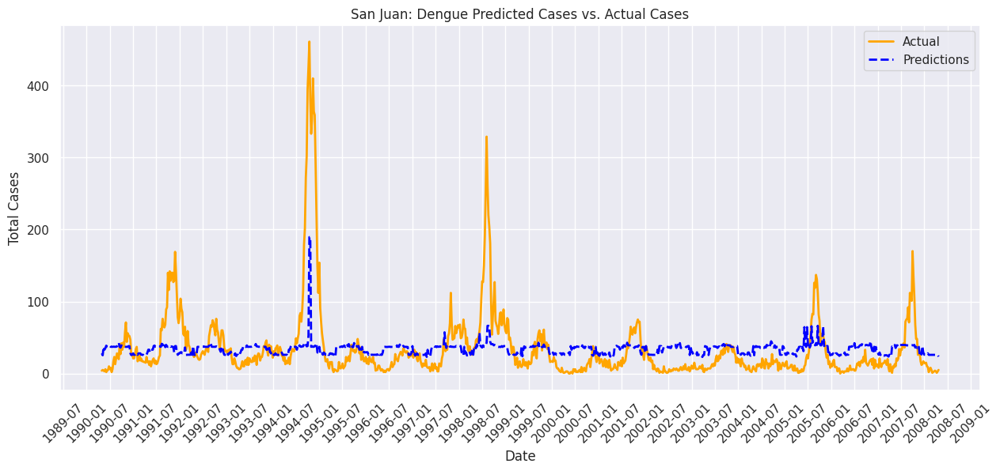

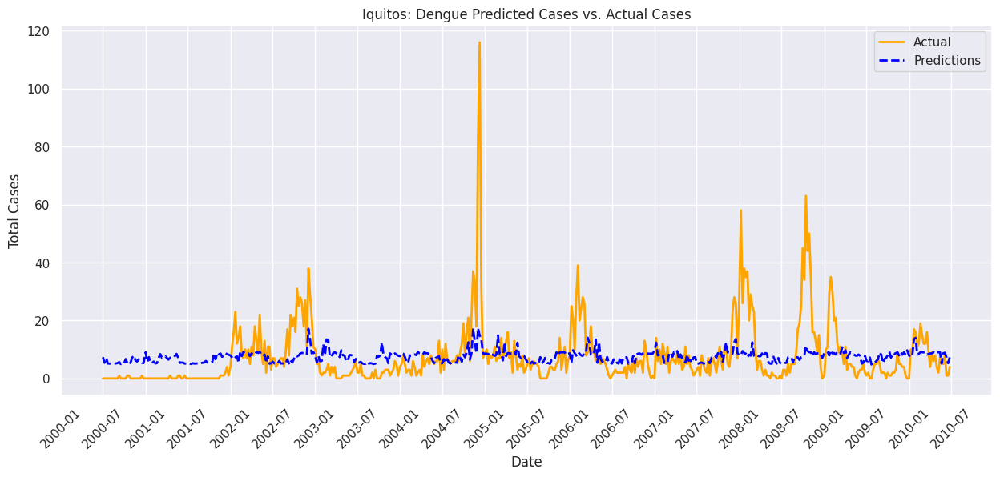

In [ ]:


plot_train_predictions_vs_actual(sj_xgb_model, pd.concat([X_first_xgb_sj_train, X_first_xgb_sj_test]), pd.concat([y_first_xgb_sj_train, y_first_xgb_sj_test]), 'San Juan: Dengue Predicted Cases vs. Actual Cases')
plot_train_predictions_vs_actual(iq_xgb_model, pd.concat([X_first_xgb_iq_train, X_first_xgb_iq_test]), pd.concat([y_first_xgb_iq_train, y_first_xgb_iq_test]), 'Iquitos: Dengue Predicted Cases vs. Actual Cases')

## 4. Second time feature engineering and modelling

This is the second training where each column is preprocessed using the sliding window average to derive new columns, which are then used for feature selection

### 4.1 Feature engineering


This method is used to take a rolling average of the original data with a sliding window of =2

In [ ]:
# Function to calculate rolling averages
def add_rolling_average(df, columns, window=2):
    rolled_df = pd.DataFrame(index=df.index)
    if 'total_cases' in df.columns:
        rolled_df['total_cases'] = df['total_cases']

    for col in columns:
        if col != 'total_cases':
            rolled_df['roll_avg_' + col] = df[col].rolling(window=window, min_periods=1).mean()
    return rolled_df

Define the columns that will be used for the rolling average summation.

We also define a training set and a validation set for the second training

In [ ]:

# Define the columns to be processed
columns_to_roll = [
    'ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw', 'precipitation_amt_mm',
    'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_dew_point_temp_k',
    'reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k',
    'reanalysis_relative_humidity_percent', 'reanalysis_sat_precip_amt_mm',
    'reanalysis_specific_humidity_g_per_kg', 'reanalysis_tdtr_k',
    'station_avg_temp_c', 'station_diur_temp_rng_c', 'station_max_temp_c',
    'station_min_temp_c', 'station_precip_mm','total_cases'
]

# Copying the original data to new DataFrames
sj_train_filled_roll_avg_tan = add_rolling_average(sj_train_filled_tan, columns_to_roll)
iq_train_filled_roll_avg_tan = add_rolling_average(iq_train_filled_tan, columns_to_roll)
sj_test_filled_roll_avg_tan = add_rolling_average(sj_test_filled_tan, columns_to_roll)
iq_test_filled_roll_avg_tan = add_rolling_average(iq_test_filled_tan, columns_to_roll)



sj_train_size = int(0.85 * sj_train_filled_roll_avg_tan.shape[0])
sj_second_train_subtrain_tan = sj_train_filled_roll_avg_tan.head(sj_train_size)
sj_second_train_subtest_tan = sj_train_filled_roll_avg_tan.tail(sj_train_filled_roll_avg_tan.shape[0] - sj_train_size)


iq_train_size = int(0.85 * iq_train_filled_roll_avg_tan.shape[0])
iq_second_train_subtrain_tan = iq_train_filled_roll_avg_tan.head(iq_train_size)
iq_second_train_subtest_tan = iq_train_filled_roll_avg_tan.tail(iq_train_filled_roll_avg_tan.shape[0] - iq_train_size)



In [ ]:
corr_sj_roll_avg_tan = sj_train_filled_roll_avg_tan.corr()
corr_iq_roll_avg_tan = iq_train_filled_roll_avg_tan.corr()

Find the correlation between the total case and the individual columns(sj)


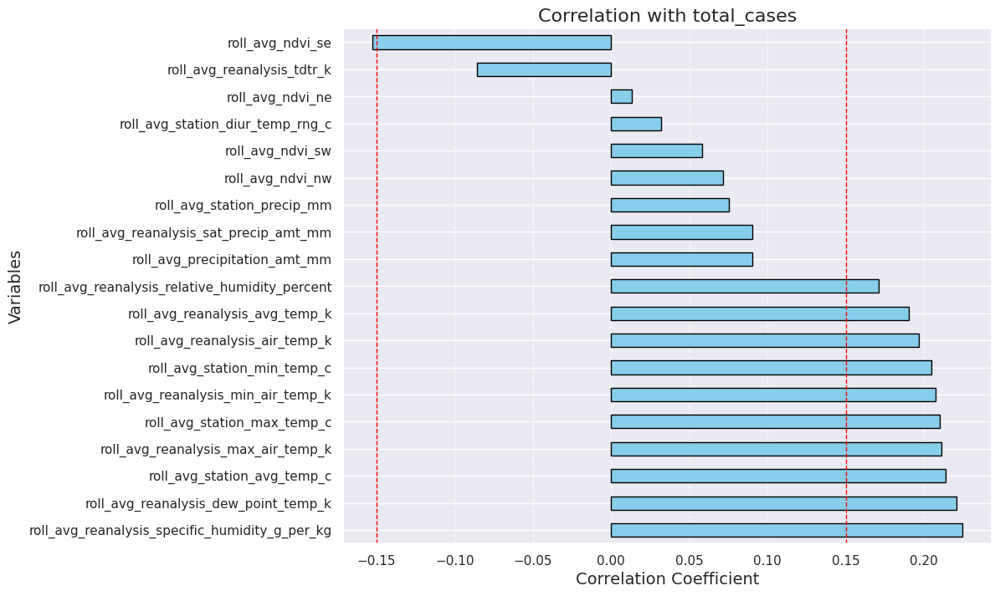

In [ ]:
# Sorting correlations
sorted_corr_sj_roll_avg_tan= corr_sj_roll_avg_tan['total_cases'].drop('total_cases').sort_values(ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
ax = sorted_corr_sj_roll_avg_tan.plot(kind='barh', color='skyblue', edgecolor='black')
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Variables', fontsize=14)
plt.title('Correlation with total_cases', fontsize=16)
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)
plt.axvline(x=-0.15, color='red', linestyle='--', linewidth=1)

plt.show()

Find the correlation between the total case and the individual columns(iq)

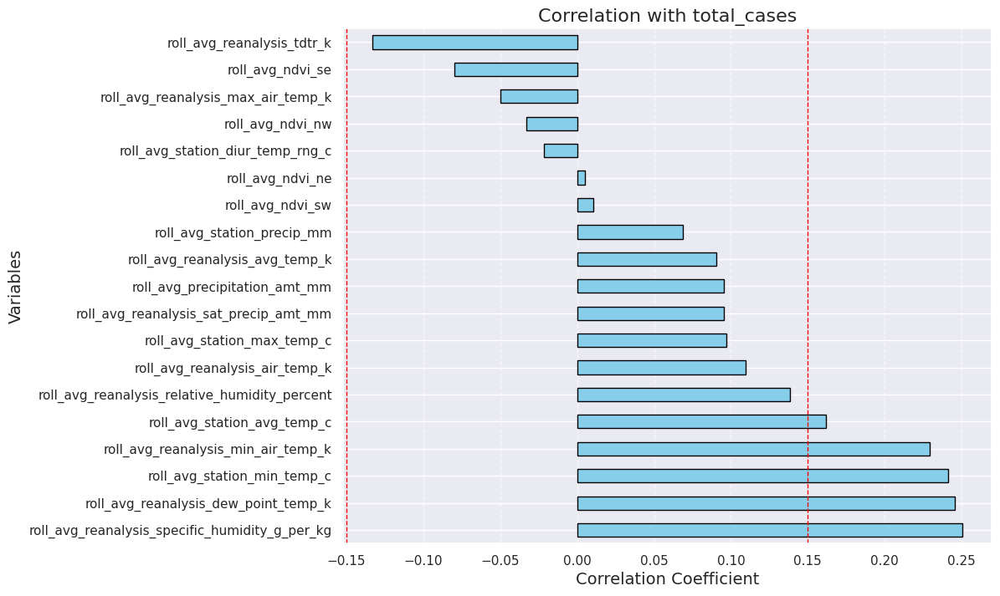

In [ ]:
# Sorting correlations
sorted_corr_iq_roll_avg_tan= corr_iq_roll_avg_tan['total_cases'].drop('total_cases').sort_values(ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
ax = sorted_corr_iq_roll_avg_tan.plot(kind='barh', color='skyblue', edgecolor='black')
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Variables', fontsize=14)
plt.title('Correlation with total_cases', fontsize=16)
plt.grid(axis='x', linestyle='--', alpha=0.7)

# Add horizontal lines at 0.1 and -0.1
plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)
plt.axvline(x=-0.15, color='red', linestyle='--', linewidth=1)

plt.show()

### 4.2 Feature selection


Based on the above relationship between total case and each column and the previous heatmap, if the correlation between two columns is too high, one column is deleted.



In [ ]:
second_selection_sj_tan = [
    'roll_avg_reanalysis_specific_humidity_g_per_kg','roll_avg_station_avg_temp_c','roll_avg_station_max_temp_c','roll_avg_station_min_temp_c','roll_avg_reanalysis_min_air_temp_k',
    'roll_avg_reanalysis_max_air_temp_k','roll_avg_reanalysis_avg_temp_k','roll_avg_reanalysis_relative_humidity_percent'
]
second_selection_iq_tan = [
    'roll_avg_station_min_temp_c','roll_avg_reanalysis_dew_point_temp_k','roll_avg_reanalysis_min_air_temp_k','roll_avg_station_avg_temp_c'
]
sj_second_model_formula = (
    "total_cases ~ 1 + "
    "roll_avg_reanalysis_dew_point_temp_k + "
    "roll_avg_station_avg_temp_c + "
    "roll_avg_station_max_temp_c + "
    "roll_avg_station_min_temp_c + "
    "roll_avg_reanalysis_min_air_temp_k + "
    "roll_avg_reanalysis_max_air_temp_k + "
    "roll_avg_reanalysis_avg_temp_k + "
    "roll_avg_reanalysis_specific_humidity_g_per_kg + "
    "roll_avg_reanalysis_relative_humidity_percent"
)

iq_second_model_formula = (
    "total_cases ~ 1 + "
    "roll_avg_reanalysis_dew_point_temp_k + "
    "roll_avg_reanalysis_min_air_temp_k + "
    "roll_avg_station_avg_temp_c + "
    "roll_avg_station_min_temp_c"
)

sj_second_test = sj_test_filled_roll_avg_tan[second_selection_sj_tan]
iq_second_test = iq_test_filled_roll_avg_tan[second_selection_iq_tan]


### 4.3 Second negative binomial regression modelling

In [ ]:
second_sj_best_model = negative_binomial_regression_model(sj_second_train_subtrain_tan, sj_second_train_subtest_tan, sj_second_model_formula)
second_iq_best_model = negative_binomial_regression_model(iq_second_train_subtrain_tan, iq_second_train_subtest_tan, iq_second_model_formula)

MAE: 21.326241134751772
alpha: 1e-08
Training time: 0.25 seconds
MAE: 5.384615384615385
alpha: 1e-08
Training time: 0.16 seconds


Plot the predictions versus the actual results from the trained model

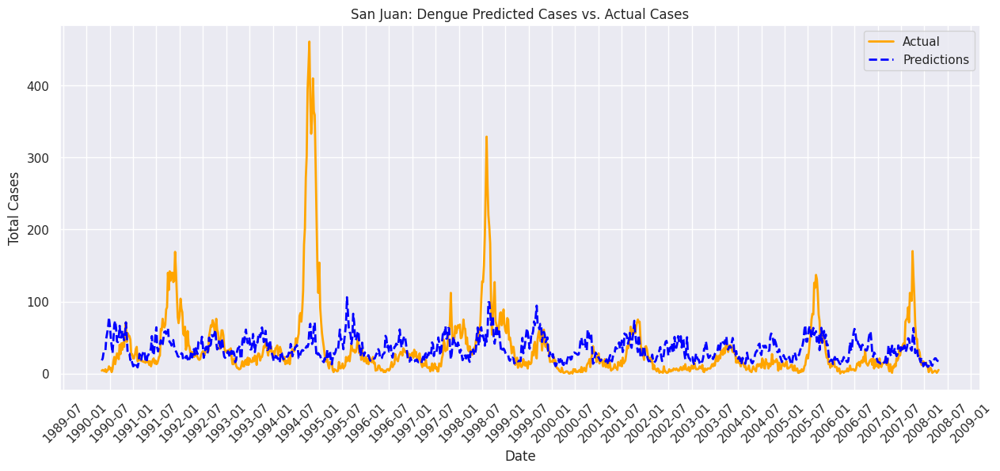

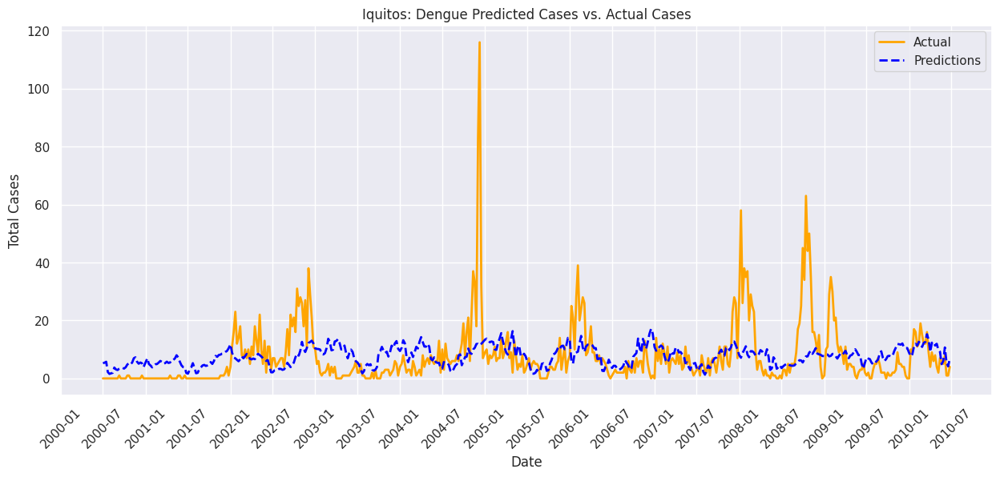

In [ ]:

plot_train_predictions_vs_actual(second_sj_best_model, sj_train_filled_roll_avg_tan.drop(columns='total_cases'),
                                 sj_train_filled_roll_avg_tan['total_cases'],
                                 'San Juan: Dengue Predicted Cases vs. Actual Cases')


plot_train_predictions_vs_actual(second_iq_best_model, iq_train_filled_roll_avg_tan.drop(columns='total_cases'),
                                 iq_train_filled_roll_avg_tan['total_cases'],
                                 'Iquitos: Dengue Predicted Cases vs. Actual Cases')

Generating prediction files

In [ ]:
second_sj_best_model_predictions = second_sj_best_model.predict(sj_test_filled_roll_avg_tan).astype(int)
second_iq_best_model_predictions = second_iq_best_model.predict(iq_test_filled_roll_avg_tan).astype(int)

submission = pd.read_csv("submission_format.csv",index_col=[0, 1, 2])

submission.total_cases = np.concatenate([second_sj_best_model_predictions, second_iq_best_model_predictions])
submission.to_csv("second_negative_binomial_regression.csv")

The score from the official website was 26.43

### 4.4 Second time SVR modelling

In [ ]:

def get_second_svr_best_params_sj(X_train, y_train):
    svr = SVR()
    svr_first_grid_sj_tan = {
    'C': [0.05, 0.002, 0.01],
    'epsilon': [ 0.3, 0.2,0.15],
    'kernel': ['linear']}
    grid = GridSearchCV(svr, svr_first_grid_sj_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

def get_second_svr_best_params_iq(X_train, y_train):
    svr = SVR()
    svr_first_grid_iq_tan = {
    'C': [ 120, 130, 140],
    'epsilon': [0.01, 0.02, 0.03],
    'kernel': ['linear']}
    grid = GridSearchCV(svr, svr_first_grid_iq_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

In [ ]:
# Extract features and target variables
X_second_svr_sj_train_tan = sj_second_train_subtrain_tan[second_selection_sj_tan]
y_second_svr_sj_train_tan = sj_second_train_subtrain_tan[target]
X_second_svr_sj_test_tan = sj_second_train_subtest_tan[second_selection_sj_tan]
y_second_svr_sj_test_tan = sj_second_train_subtest_tan[target]

X_second_svr_iq_train_tan = iq_second_train_subtrain_tan[second_selection_iq_tan]
y_second_svr_iq_train_tan = iq_second_train_subtrain_tan[target]
X_second_svr_iq_test_tan = iq_second_train_subtest_tan[second_selection_iq_tan]
y_second_svr_iq_test_tan = iq_second_train_subtest_tan[target]

sj_second_test = sj_test_filled_roll_avg_tan[second_selection_sj_tan]
iq_second_test = iq_test_filled_roll_avg_tan[second_selection_iq_tan]

# Scale features
second_svr_scaler_sj_tan = StandardScaler()
second_svr_scaler_iq_tan = StandardScaler()

X_second_svr_sj_train_scaled_tan = second_svr_scaler_sj_tan.fit_transform(X_second_svr_sj_train_tan)
X_second_svr_sj_test_scaled_tan = second_svr_scaler_sj_tan.transform(X_second_svr_sj_test_tan)

X_second_svr_iq_train_scaled_tan = second_svr_scaler_iq_tan.fit_transform(X_second_svr_iq_train_tan)
X_second_svr_iq_test_scaled_tan = second_svr_scaler_iq_tan.transform(X_second_svr_iq_test_tan)

sj_svr_second_test_scaled = second_svr_scaler_sj_tan.transform(sj_second_test)
iq_svr_second_test_scaled = second_svr_scaler_iq_tan.transform(iq_second_test)

In [ ]:
sj_best_params = get_second_svr_best_params_sj(X_second_svr_sj_train_scaled_tan, y_second_svr_sj_train_tan)
iq_best_params = get_second_svr_best_params_iq(X_second_svr_iq_train_scaled_tan, y_second_svr_iq_train_tan)

print("SJ best param:", sj_best_params)
print("IQ best param:", iq_best_params)


SJ best param: {'C': 0.05, 'epsilon': 0.3, 'kernel': 'linear'}
IQ best param: {'C': 130, 'epsilon': 0.03, 'kernel': 'linear'}


In [ ]:
# Use the function to evaluate and retrain the model
sj_svr_second_model = svr_regression_model(X_second_svr_sj_train_scaled_tan, y_second_svr_sj_train_tan,
                                           X_second_svr_sj_test_scaled_tan, y_second_svr_sj_test_tan,
                                           sj_best_params)

iq_svr_second_model = svr_regression_model(X_second_svr_iq_train_scaled_tan, y_second_svr_iq_train_tan,
                                           X_second_svr_iq_test_scaled_tan, y_second_svr_iq_test_tan,
                                           iq_best_params)

MAE: 20.2487
MAE: 4.6366


Plot the predictions versus the actual results from the trained model

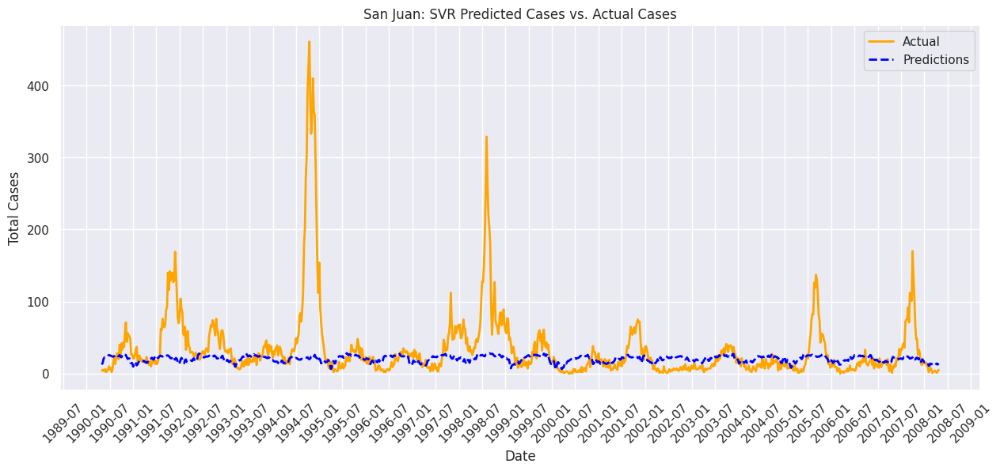

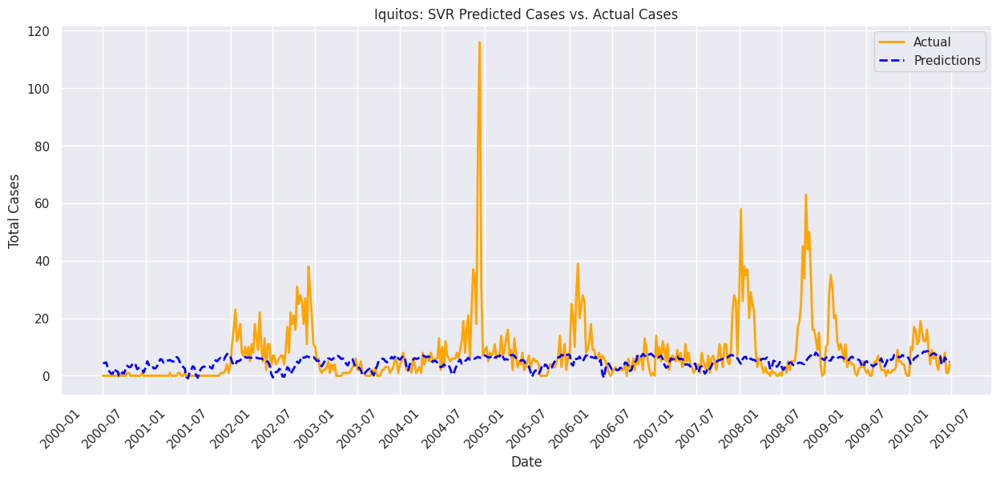

In [ ]:

plot_train_predictions_vs_actual(sj_svr_second_model,  pd.concat([pd.DataFrame(X_second_svr_sj_train_scaled_tan), pd.DataFrame(X_second_svr_sj_test_scaled_tan)]),
                                 pd.concat([pd.DataFrame(y_second_svr_sj_train_tan), pd.DataFrame(y_second_svr_sj_test_tan)]),
                                 'San Juan: SVR Predicted Cases vs. Actual Cases')

plot_train_predictions_vs_actual(iq_svr_second_model, pd.concat([pd.DataFrame(X_second_svr_iq_train_scaled_tan), pd.DataFrame(X_second_svr_iq_test_scaled_tan)]),
                                 pd.concat([pd.DataFrame(y_second_svr_iq_train_tan), pd.DataFrame(y_second_svr_iq_test_tan)]),
                                 'Iquitos: SVR Predicted Cases vs. Actual Cases')

Generating prediction files

In [ ]:

svr_second_sj_predictions = sj_svr_second_model.predict(sj_svr_second_test_scaled).astype(int)
svr_second_iq_predictions = iq_svr_second_model.predict(iq_svr_second_test_scaled).astype(int)
submission = pd.read_csv("submission_format.csv", index_col=[0, 1, 2])

submission.total_cases = np.concatenate([svr_second_sj_predictions, svr_second_iq_predictions])

submission.to_csv("second_svr.csv")

The score from the official website was 28.23

### 4.5 Second time XGboost modelling for

In [ ]:
# Function to execute grid search and return the best parameters for San Juan
def get_second_xgb_best_params_sj(X_train, y_train):
    xgb = XGBRegressor()
    xgb_second_grid_sj_tan = {
        'learning_rate': [0.01, 0.05, 0.03],
        'n_estimators': [100, 80, 90],
        'max_depth': [3, 1, 2]
    }
    grid = GridSearchCV(xgb, xgb_second_grid_sj_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

# Function to execute grid search and return the best parameters for Iquitos
def get_second_xgb_best_params_iq(X_train, y_train):
    xgb = XGBRegressor()
    xgb_second_grid_iq_tan = {
        'learning_rate': [0.01, 0.05, 0.03],
        'n_estimators': [100, 80, 90],
        'max_depth': [3, 1, 2]
    }
    grid = GridSearchCV(xgb, xgb_second_grid_iq_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_


In [ ]:
# Extract features and target variables for San Juan
X_second_xgb_sj_train = sj_second_train_subtrain_tan[second_selection_sj_tan]
y_second_xgb_sj_train = sj_second_train_subtrain_tan[target]
X_second_xgb_sj_test = sj_second_train_subtest_tan[second_selection_sj_tan]
y_second_xgb_sj_test = sj_second_train_subtest_tan[target]

# Extract features and target variables for Iquitos
X_second_xgb_iq_train = iq_second_train_subtrain_tan[second_selection_iq_tan]
y_second_xgb_iq_train = iq_second_train_subtrain_tan[target]
X_second_xgb_iq_test = iq_second_train_subtest_tan[second_selection_iq_tan]
y_second_xgb_iq_test = iq_second_train_subtest_tan[target]

# Get the best parameters for San Juan and Iquitos using the updated functions
sj_second_xbg_best_params = get_second_xgb_best_params_sj(X_second_xgb_sj_train, y_second_xgb_sj_train)
iq_second_xbg_best_params = get_second_xgb_best_params_iq(X_second_xgb_iq_train, y_second_xgb_iq_train)

print("SJ best param:", sj_second_xbg_best_params)
print("IQ best param:", iq_second_xbg_best_params)

SJ best param: {'learning_rate': 0.01, 'max_depth': 1, 'n_estimators': 80}
IQ best param: {'learning_rate': 0.01, 'max_depth': 2, 'n_estimators': 100}


In [ ]:
sj_xgb_second_model = xgb_regression_model(X_second_xgb_sj_train, y_second_xgb_sj_train,
                                    X_second_xgb_sj_test, y_second_xgb_sj_test,
                                    sj_second_xbg_best_params)

iq_xgb_second_model = xgb_regression_model(X_second_xgb_iq_train, y_second_xgb_iq_train,
                                    X_second_xgb_iq_test, y_second_xgb_iq_test,
                                    iq_second_xbg_best_params)

MAE: 26.6305
MAE: 5.3409


Plot the predictions versus the actual results from the trained model

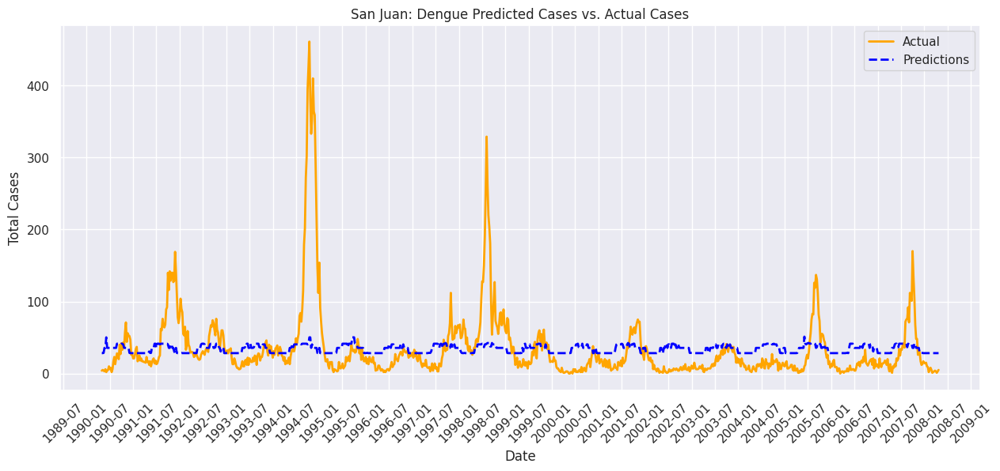

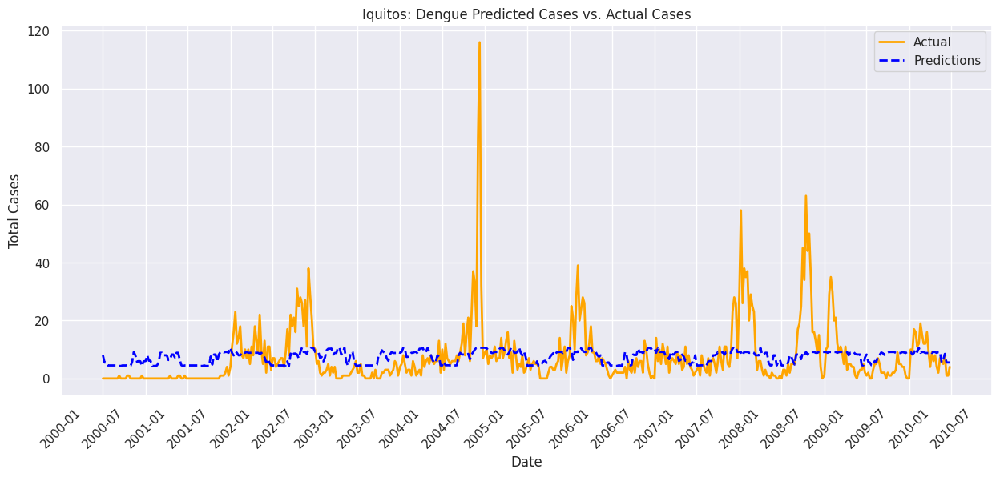

In [ ]:
plot_train_predictions_vs_actual(sj_xgb_second_model, pd.concat([X_second_xgb_sj_train, X_second_xgb_sj_test]), pd.concat([y_second_xgb_sj_train, y_second_xgb_sj_test]), 'San Juan: Dengue Predicted Cases vs. Actual Cases')
plot_train_predictions_vs_actual(iq_xgb_second_model, pd.concat([X_second_xgb_iq_train, X_second_xgb_iq_test]), pd.concat([y_second_xgb_iq_train, y_second_xgb_iq_test]), 'Iquitos: Dengue Predicted Cases vs. Actual Cases')


Generating prediction files

In [ ]:
sj_xgb_second_predictions = sj_xgb_second_model.predict(sj_second_test).astype(int)
iq_xgb_second_predictions = iq_xgb_second_model.predict(iq_second_test).astype(int)

submission = pd.read_csv("submission_format.csv", index_col=[0, 1, 2])

submission.total_cases = np.concatenate([sj_xgb_second_predictions, iq_xgb_second_predictions])

submission.to_csv("second_xgb_predictions.csv")

The score from the official website was 26.46

## 5. Third time feature engineering and modelling





Since there may be a lag between environmental data and case outbreaks, the original data will be lagged for two weeks to observe whether the three models are improved

### 5.1 Feature engineering

Define a function that applies a lag to a column

In [ ]:
def add_lagged_values(df, columns, lag=2):
    lagged_df = pd.DataFrame(index=df.index)

    no_lag_columns = ['year', 'weekofyear', 'week_start_date', 'city', 'total_cases']

    for col in no_lag_columns:
        if col in df.columns:
            lagged_df[col] = df[col]
    for col in columns:
        if col not in no_lag_columns:
            lagged_df['lag_' + col] = df[col].shift(lag, fill_value=df[col].iloc[0])

    return lagged_df


Call the add lagged values method to lag the columns

Split the data into a training set and a test machine


In [ ]:
# Define the columns to be processed
columns_to_lag = [
    'ndvi_ne', 'ndvi_nw', 'ndvi_se', 'ndvi_sw', 'precipitation_amt_mm',
    'reanalysis_air_temp_k', 'reanalysis_avg_temp_k', 'reanalysis_dew_point_temp_k',
    'reanalysis_max_air_temp_k', 'reanalysis_min_air_temp_k',
    'reanalysis_relative_humidity_percent', 'reanalysis_sat_precip_amt_mm',
    'reanalysis_specific_humidity_g_per_kg', 'reanalysis_tdtr_k',
    'station_avg_temp_c', 'station_diur_temp_rng_c', 'station_max_temp_c',
    'station_min_temp_c', 'station_precip_mm'
]

# Copying the original data to new DataFrames
sj_train_filled_lag_tan = add_lagged_values(sj_train_filled_tan, columns_to_lag)
iq_train_filled_lag_tan = add_lagged_values(iq_train_filled_tan, columns_to_lag)
sj_test_filled_lag_tan = add_lagged_values(sj_test_filled_tan, columns_to_lag)
iq_test_filled_lag_tan = add_lagged_values(iq_test_filled_tan, columns_to_lag)

sj_train_size = int(0.85 * sj_train_filled_lag_tan.shape[0])
sj_third_train_subtrain_tan = sj_train_filled_lag_tan.head(sj_train_size)
sj_third_train_subtest_tan = sj_train_filled_lag_tan.tail(sj_train_filled_lag_tan.shape[0] - sj_train_size)

iq_train_size = int(0.85 * iq_train_filled_roll_avg_tan.shape[0])
iq_third_train_subtrain_tan = iq_train_filled_lag_tan.head(iq_train_size)
iq_third_train_subtest_tan = iq_train_filled_lag_tan.tail(iq_train_filled_lag_tan.shape[0] - iq_train_size)


A correlation plot between lagged columns and total cases is generated


In [ ]:
corr_sj_lag_tan = sj_train_filled_lag_tan.corr()
corr_iq_lag_tan = iq_train_filled_lag_tan.corr()

Find the correlation between the total case and the individual columns(iq)

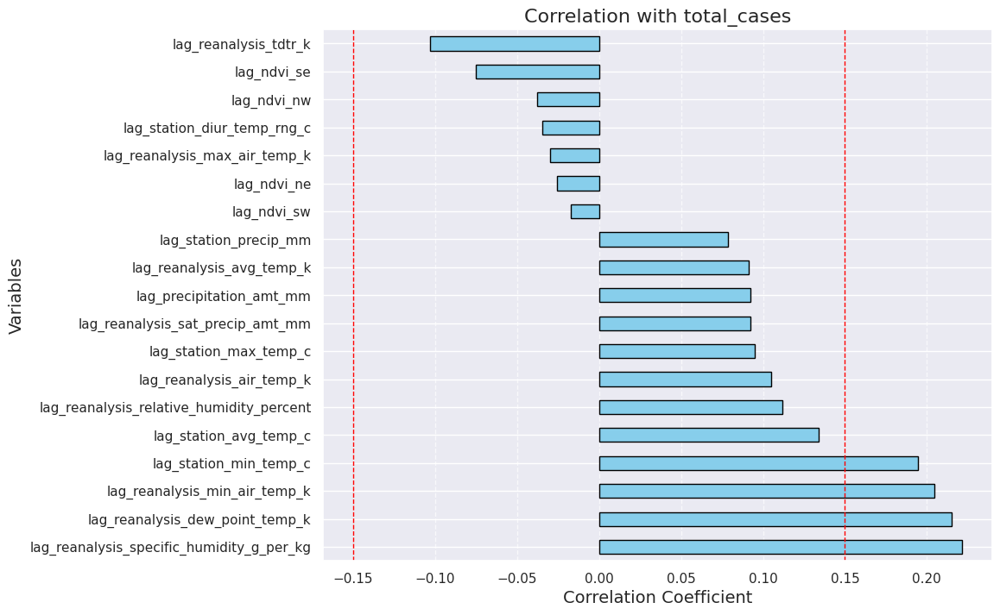

In [ ]:
# Sorting correlations
sorted_corr_iq_lag_tan= corr_iq_lag_tan['total_cases'].drop('total_cases').sort_values(ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
ax = sorted_corr_iq_lag_tan.plot(kind='barh', color='skyblue', edgecolor='black')
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Variables', fontsize=14)
plt.title('Correlation with total_cases', fontsize=16)
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)
plt.axvline(x=-0.15, color='red', linestyle='--', linewidth=1)

plt.show()

Find the correlation between the total case and the individual columns(sj)

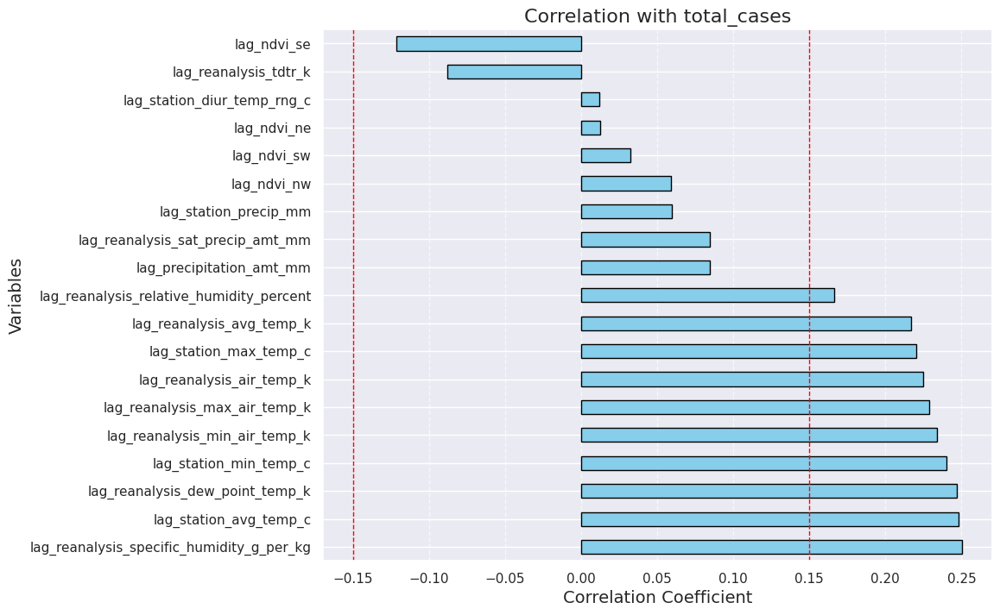

In [ ]:
# Sorting correlations
sorted_corr_sj_lag_tan= corr_sj_lag_tan['total_cases'].drop('total_cases').sort_values(ascending=False)

# Plotting
plt.figure(figsize=(10, 8))
ax = sorted_corr_sj_lag_tan.plot(kind='barh', color='skyblue', edgecolor='black')
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Variables', fontsize=14)
plt.title('Correlation with total_cases', fontsize=16)
plt.grid(axis='x', linestyle='--', alpha=0.7)

plt.axvline(x=0.15, color='red', linestyle='--', linewidth=1)
plt.axvline(x=-0.15, color='red', linestyle='--', linewidth=1)

plt.show()

In [ ]:
sorted_corr_iq_lag_tan

lag_reanalysis_specific_humidity_g_per_kg    0.221177
lag_reanalysis_dew_point_temp_k              0.215354
lag_reanalysis_min_air_temp_k                0.204610
lag_station_min_temp_c                       0.194558
lag_station_avg_temp_c                       0.133885
lag_reanalysis_relative_humidity_percent     0.111976
lag_reanalysis_air_temp_k                    0.104767
lag_station_max_temp_c                       0.095005
lag_reanalysis_sat_precip_amt_mm             0.092514
lag_precipitation_amt_mm                     0.092514
lag_reanalysis_avg_temp_k                    0.091520
lag_station_precip_mm                        0.078704
lag_ndvi_sw                                 -0.017176
lag_ndvi_ne                                 -0.025590
lag_reanalysis_max_air_temp_k               -0.029705
lag_station_diur_temp_rng_c                 -0.034578
lag_ndvi_nw                                 -0.037948
lag_ndvi_se                                 -0.075161
lag_reanalysis_tdtr_k       

### 5.2 Feature selection

Select a correlation between total and the lagged column greater than 0.15, and remove columns with high correlation between columns

In [ ]:
third_selection_sj_tan = [
    'lag_reanalysis_specific_humidity_g_per_kg',
    'lag_station_avg_temp_c','lag_reanalysis_dew_point_temp_k','lag_station_min_temp_c','lag_reanalysis_min_air_temp_k','lag_reanalysis_max_air_temp_k',
    'lag_reanalysis_air_temp_k','lag_station_max_temp_c','lag_reanalysis_avg_temp_k','lag_reanalysis_relative_humidity_percent'
]
third_selection_iq_tan = [
    'lag_reanalysis_specific_humidity_g_per_kg','lag_reanalysis_dew_point_temp_k','lag_reanalysis_min_air_temp_k','lag_station_min_temp_c',
]
sj_third_model_formula = (
    "total_cases ~ 1 + "
    "lag_reanalysis_specific_humidity_g_per_kg + "
    "lag_station_avg_temp_c + "
    "lag_reanalysis_dew_point_temp_k + "
    "lag_station_min_temp_c + "
    "lag_reanalysis_min_air_temp_k + "
    "lag_reanalysis_max_air_temp_k + "
    "lag_reanalysis_air_temp_k + "
    "lag_station_max_temp_c + "
    "lag_reanalysis_avg_temp_k + "
    "lag_reanalysis_relative_humidity_percent"
)

iq_third_model_formula = (
    "total_cases ~ 1 + "
    "lag_reanalysis_specific_humidity_g_per_kg + "
    "lag_reanalysis_dew_point_temp_k + "
    "lag_reanalysis_min_air_temp_k + "
    "lag_station_min_temp_c"
)

sj_third_test = sj_test_filled_lag_tan[third_selection_sj_tan]
iq_third_test = iq_test_filled_lag_tan[third_selection_iq_tan]


### 5.3 Third time negative binomial regression modelling

In [ ]:
third_sj_best_model = negative_binomial_regression_model(sj_third_train_subtrain_tan, sj_third_train_subtest_tan, sj_third_model_formula)
third_iq_best_model = negative_binomial_regression_model(iq_third_train_subtrain_tan, iq_third_train_subtest_tan, iq_third_model_formula)

MAE: 21.75886524822695
alpha: 1e-08
Training time: 0.34 seconds
MAE: 6.4743589743589745
alpha: 1e-08
Training time: 0.18 seconds


Plot the predictions versus the actual results from the trained model

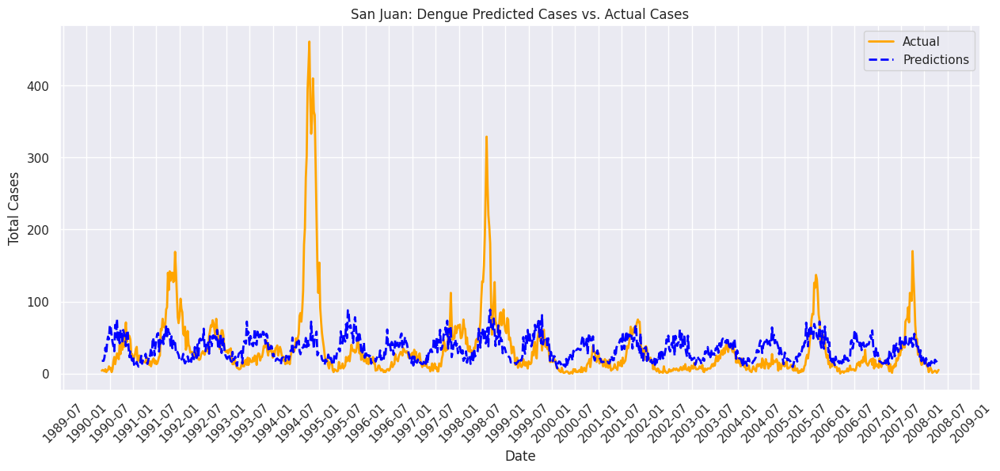

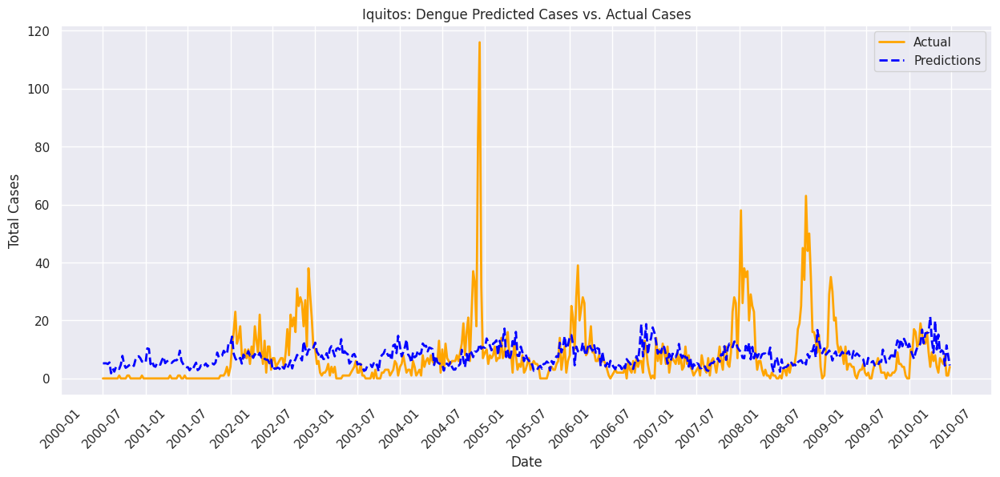

In [ ]:

plot_train_predictions_vs_actual(third_sj_best_model, sj_train_filled_lag_tan.drop(columns='total_cases'),
                                 sj_train_filled_lag_tan['total_cases'],
                                 'San Juan: Dengue Predicted Cases vs. Actual Cases')

plot_train_predictions_vs_actual(third_iq_best_model, iq_train_filled_lag_tan.drop(columns='total_cases'),
                                 iq_train_filled_lag_tan['total_cases'],
                                 'Iquitos: Dengue Predicted Cases vs. Actual Cases')

Generate a file for prediction results

In [ ]:
third_sj_best_model_predictions = third_sj_best_model.predict(sj_third_test).astype(int)
third_iq_best_model_predictions = third_iq_best_model.predict(iq_third_test).astype(int)

submission = pd.read_csv("submission_format.csv",index_col=[0, 1, 2])

submission.total_cases = np.concatenate([third_sj_best_model_predictions, third_iq_best_model_predictions])
submission.to_csv("thrid_negative_binomial_regression.csv")

The score from the official website was 25.90

### 5.4 The third SVR modelling

In [ ]:
# Function to perform a grid search and return the best parameters
def get_third_svr_best_params_sj(X_train, y_train):
    svr = SVR()
    svr_third_grid_sj_tan = {
    'C': [0.05,0.02, 0.01],
    'epsilon': [ 0.3, 0.05,0.15],
    'kernel': ['linear']}
    grid = GridSearchCV(svr, svr_third_grid_sj_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

def get_third_svr_best_params_iq(X_train, y_train):
    svr = SVR()
    svr_third_grid_iq_tan = {
    'C': [ 120, 130, 140],
    'epsilon': [0.01, 0.02, 0.03],
    'kernel': ['linear']}
    grid = GridSearchCV(svr, svr_third_grid_iq_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

In [ ]:
# Extract features and target variables
X_third_svr_sj_train_tan = sj_third_train_subtrain_tan[third_selection_sj_tan]
y_third_svr_sj_train_tan = sj_third_train_subtrain_tan[target]
X_third_svr_sj_test_tan = sj_third_train_subtest_tan[third_selection_sj_tan]
y_third_svr_sj_test_tan = sj_third_train_subtest_tan[target]

X_third_svr_iq_train_tan = iq_third_train_subtrain_tan[third_selection_iq_tan]
y_third_svr_iq_train_tan = iq_third_train_subtrain_tan[target]
X_third_svr_iq_test_tan = iq_third_train_subtest_tan[third_selection_iq_tan]
y_third_svr_iq_test_tan = iq_third_train_subtest_tan[target]

sj_third_test = sj_test_filled_lag_tan[third_selection_sj_tan]
iq_third_test = iq_test_filled_lag_tan[third_selection_iq_tan]

# Scale features
third_svr_scaler_sj_tan = StandardScaler()
third_svr_scaler_iq_tan = StandardScaler()

X_third_svr_sj_train_scaled_tan = third_svr_scaler_sj_tan.fit_transform(X_third_svr_sj_train_tan)
X_third_svr_sj_test_scaled_tan = third_svr_scaler_sj_tan.transform(X_third_svr_sj_test_tan)

X_third_svr_iq_train_scaled_tan = third_svr_scaler_iq_tan.fit_transform(X_third_svr_iq_train_tan)
X_third_svr_iq_test_scaled_tan = third_svr_scaler_iq_tan.transform(X_third_svr_iq_test_tan)

sj_svr_third_test_scaled = third_svr_scaler_sj_tan.transform(sj_third_test)
iq_svr_third_test_scaled = third_svr_scaler_iq_tan.transform(iq_third_test)

In [ ]:
sj_best_params = get_second_svr_best_params_sj(X_second_svr_sj_train_scaled_tan, y_second_svr_sj_train_tan)
iq_best_params = get_second_svr_best_params_iq(X_second_svr_iq_train_scaled_tan, y_second_svr_iq_train_tan)

print("SJ best param:", sj_best_params)
print("IQ best param:", iq_best_params)

SJ best param: {'C': 0.05, 'epsilon': 0.3, 'kernel': 'linear'}
IQ best param: {'C': 130, 'epsilon': 0.03, 'kernel': 'linear'}


In [ ]:
sj_svr_third_model = svr_regression_model(X_third_svr_sj_train_scaled_tan, y_third_svr_sj_train_tan,
                                          X_third_svr_sj_test_scaled_tan, y_third_svr_sj_test_tan,
                                          sj_best_params)

iq_svr_third_model = svr_regression_model(X_third_svr_iq_train_scaled_tan, y_third_svr_iq_train_tan,
                                          X_third_svr_iq_test_scaled_tan, y_third_svr_iq_test_tan,
                                          iq_best_params)

MAE: 19.4187
MAE: 4.8281


Plot the predictions versus the actual results from the trained model

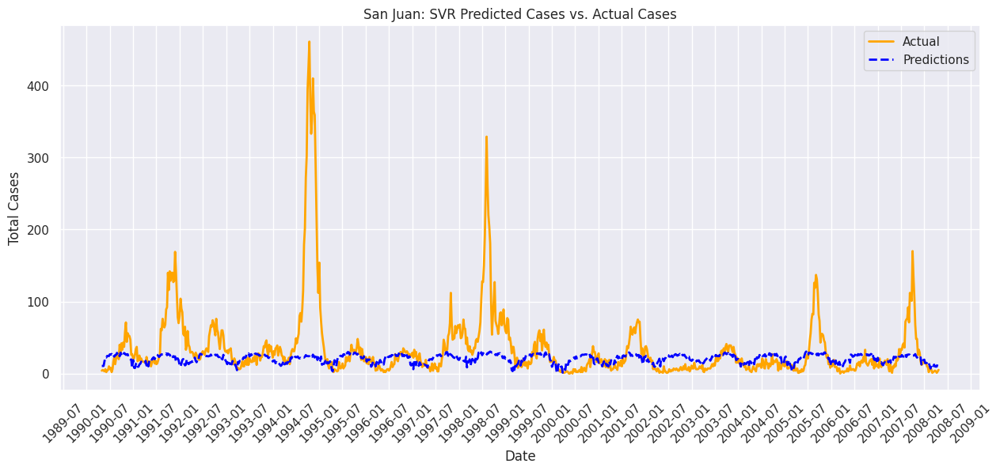

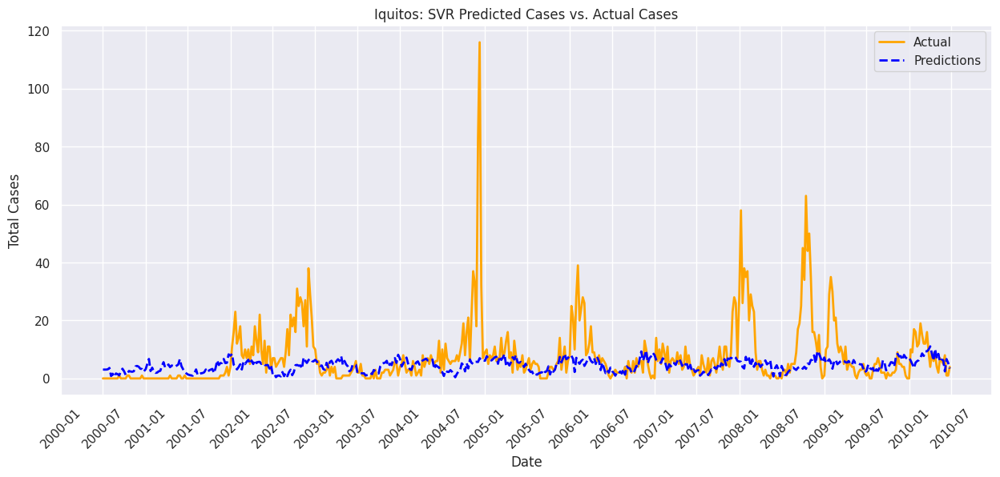

In [ ]:

plot_train_predictions_vs_actual(sj_svr_third_model,  pd.concat([pd.DataFrame(X_third_svr_sj_train_scaled_tan), pd.DataFrame(X_third_svr_sj_test_scaled_tan)]),
                                 pd.concat([pd.DataFrame(y_third_svr_sj_train_tan), pd.DataFrame(y_third_svr_sj_test_tan)]),
                                 'San Juan: SVR Predicted Cases vs. Actual Cases')

plot_train_predictions_vs_actual(iq_svr_third_model, pd.concat([pd.DataFrame(X_third_svr_iq_train_scaled_tan), pd.DataFrame(X_third_svr_iq_test_scaled_tan)]),
                                 pd.concat([pd.DataFrame(y_third_svr_iq_train_tan), pd.DataFrame(y_third_svr_iq_test_tan)]),
                                 'Iquitos: SVR Predicted Cases vs. Actual Cases')


Generate a file for prediction results

In [ ]:

svr_third_sj_predictions = sj_svr_third_model.predict(sj_svr_third_test_scaled).astype(int)
svr_third_iq_predictions = iq_svr_third_model.predict(iq_svr_third_test_scaled).astype(int)

submission = pd.read_csv("submission_format.csv", index_col=[0, 1, 2])

submission.total_cases = np.concatenate([svr_third_sj_predictions, svr_third_iq_predictions])

submission.to_csv("third_svr.csv")

The score from the official website was 27.61

### 5.5 The third XGboost modelling

In [ ]:
# Function to execute grid search and return the best parameters for San Juan
def get_third_xgb_best_params_sj(X_train, y_train):
    xgb = XGBRegressor()
    xgb_third_grid_sj_tan = {
        'learning_rate': [0.01, 0.05, 0.03],
        'n_estimators': [100, 80, 90],
        'max_depth': [3, 1, 2]
    }
    grid = GridSearchCV(xgb, xgb_third_grid_sj_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_

# Function to execute grid search and return the best parameters for Iquitos
def get_third_xgb_best_params_iq(X_train, y_train):
    xgb = XGBRegressor()
    xgb_third_grid_iq_tan = {
        'learning_rate': [0.01, 0.05, 0.03],
        'n_estimators': [100, 80, 90],
        'max_depth': [3, 1, 2]
    }
    grid = GridSearchCV(xgb, xgb_third_grid_iq_tan, cv=5, scoring='neg_mean_squared_error')
    grid.fit(X_train, y_train)
    return grid.best_params_


In [ ]:
# Extract features and target variables for San Juan
X_third_xgb_sj_train = sj_third_train_subtrain_tan[third_selection_sj_tan]
y_third_xgb_sj_train = sj_third_train_subtrain_tan[target]
X_third_xgb_sj_test = sj_third_train_subtest_tan[third_selection_sj_tan]
y_third_xgb_sj_test = sj_third_train_subtest_tan[target]

# Extract features and target variables for Iquitos
X_third_xgb_iq_train = iq_third_train_subtrain_tan[third_selection_iq_tan]
y_third_xgb_iq_train = iq_third_train_subtrain_tan[target]
X_third_xgb_iq_test = iq_third_train_subtest_tan[third_selection_iq_tan]
y_third_xgb_iq_test = iq_third_train_subtest_tan[target]

# Get the best parameters for San Juan and Iquitos using the updated functions
sj_third_xbg_best_params = get_third_xgb_best_params_sj(X_third_xgb_sj_train, y_third_xgb_sj_train)
iq_third_xbg_best_params = get_third_xgb_best_params_iq(X_third_xgb_iq_train, y_third_xgb_iq_train)

print("SJ best:parameters", sj_third_xbg_best_params)
print("IQ best:parameters:", iq_third_xbg_best_params)

SJ best:parameters {'learning_rate': 0.01, 'max_depth': 1, 'n_estimators': 80}
IQ best:parameters: {'learning_rate': 0.01, 'max_depth': 1, 'n_estimators': 100}


In [ ]:
# Assuming the function `xgb_regression_model` is defined elsewhere
sj_xgb_third_model = xgb_regression_model(X_third_xgb_sj_train, y_third_xgb_sj_train,
                                    X_third_xgb_sj_test, y_third_xgb_sj_test,
                                    sj_third_xbg_best_params)

iq_xgb_third_model = xgb_regression_model(X_third_xgb_iq_train, y_third_xgb_iq_train,
                                    X_third_xgb_iq_test, y_third_xgb_iq_test,
                                    iq_third_xbg_best_params)

MAE: 25.7524
MAE: 5.4824


Plot the predictions versus the actual results from the trained model

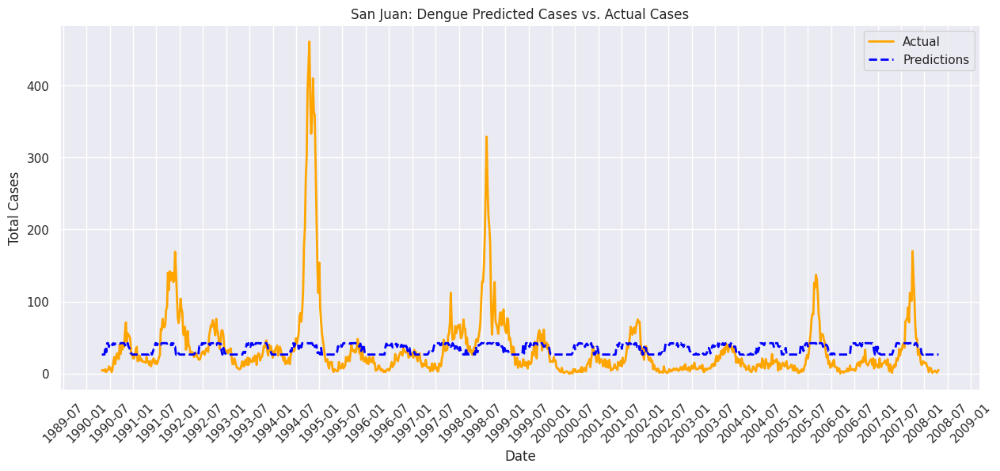

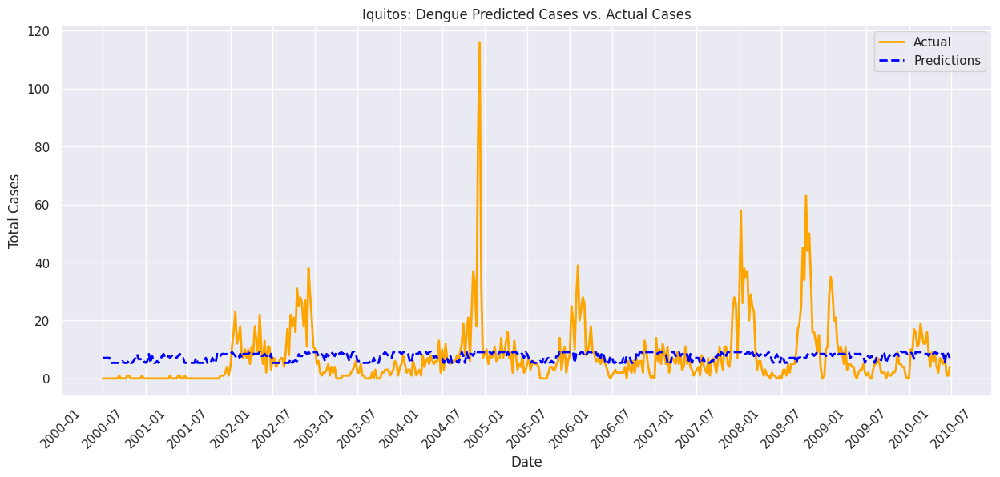

In [ ]:
plot_train_predictions_vs_actual(sj_xgb_third_model, pd.concat([X_third_xgb_sj_train, X_third_xgb_sj_test]), pd.concat([y_third_xgb_sj_train, y_third_xgb_sj_test]), 'San Juan: Dengue Predicted Cases vs. Actual Cases')
plot_train_predictions_vs_actual(iq_xgb_third_model, pd.concat([X_third_xgb_iq_train, X_third_xgb_iq_test]), pd.concat([y_third_xgb_iq_train, y_third_xgb_iq_test]), 'Iquitos: Dengue Predicted Cases vs. Actual Cases')



Generate a file for prediction results

In [ ]:

sj_xgb_third_predictions = sj_xgb_third_model.predict(sj_third_test).astype(int)
iq_xgb_third_predictions = iq_xgb_third_model.predict(iq_third_test).astype(int)

submission = pd.read_csv("submission_format.csv", index_col=[0, 1, 2])

submission.total_cases = np.concatenate([sj_xgb_third_predictions, iq_xgb_third_predictions])

submission.to_csv("third_xgb_predictions.csv")

The score from the official website was 26.4

## 6. conclusion



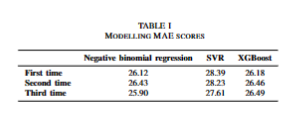

Through three times of feature engineering training for three models, the following **conclusions** are found:

(1)The ranking of the three models in terms of performance from best to worst is negative binomial regression, XGboost, SVR.

(2)Taking a rolling average of each column is not very refreshing or even counterproductive to the model

(3)Lagging the environmental data by two weeks has a large improvement in the accuracy of case prediction.


**problem and future work**:The current experiments lack research on the outbreak period and non-outbreak period, resulting in underfitting in the outbreak period of each training. Therefore, future work needs to increase the study of this step.

======================================================================================================================================================================================================================================

## 2. Data Pre-processing
According to what was mentioned before in the city part of 1.1 in this task, iq and sj will be used as two parts for data preprocessing and modeling separately

### For Iquitos (iq)


#### 2.1.1 Clean the data:


#### (Dealing with Missing Value)

In the dataset for Iquitos, the feature with the highest number of missing values has 37 missing entries. Given this relatively small number.


So, **replace data** rather than outright deletion is preferred.  
Given that the weather data is time-related, the adopted strategy for replacing missing values linearly.

In [ ]:
def fill_missing_values_with_interpolation(df, feature_columns):
    """
    This is a custom function that uses the time series interpolation method to
    fill in missing values for the specified feature column.

    Parameters:
    - df: target dataset
    - feature_columns: Features want to replace missing value
    """
    for feature in feature_columns:
        if feature in df.columns:
            df[feature] = df[feature].interpolate(method='linear', limit_direction='both')
    return df

In [ ]:
features_to_fill = [
    'station_diur_temp_rng_c', 'station_avg_temp_c', 'station_precip_mm',
    'station_max_temp_c', 'station_min_temp_c', 'reanalysis_min_air_temp_k',
    'reanalysis_tdtr_k', 'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_sat_precip_amt_mm', 'reanalysis_relative_humidity_percent',
    'reanalysis_precip_amt_kg_per_m2', 'reanalysis_max_air_temp_k',
    'reanalysis_dew_point_temp_k', 'reanalysis_avg_temp_k',
    'reanalysis_air_temp_k', 'precipitation_amt_mm', 'ndvi_sw',
    'ndvi_se', 'ndvi_nw', 'ndvi_ne'
]

# Call functions
iq_df_feature_yufeng = iq_df_feature.copy()
iq_df_feature_yufeng.sort_values(by='week_start_date', inplace=True)
fill_missing_values_with_interpolation(iq_df_feature_yufeng, features_to_fill)

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
936,iq,2000,26,2000-07-01,0.192886,0.132257,0.340886,0.247200,25.41,296.740000,...,43.19,92.418571,25.41,16.651429,8.928571,26.400000,10.775000,32.5,20.7,3.0
937,iq,2000,27,2000-07-08,0.216833,0.276100,0.289457,0.241657,60.61,296.634286,...,46.00,93.581429,60.61,16.862857,10.314286,26.900000,11.566667,34.0,20.8,55.6
938,iq,2000,28,2000-07-15,0.176757,0.173129,0.204114,0.128014,55.52,296.415714,...,64.77,95.848571,55.52,17.120000,7.385714,26.800000,11.466667,33.0,20.7,38.1
939,iq,2000,29,2000-07-22,0.227729,0.145429,0.254200,0.200314,5.60,295.357143,...,23.96,87.234286,5.60,14.431429,9.114286,25.766667,10.533333,31.5,14.7,30.0
940,iq,2000,30,2000-07-29,0.328643,0.322129,0.254371,0.361043,62.76,296.432857,...,31.80,88.161429,62.76,15.444286,9.500000,26.600000,11.480000,33.3,19.1,4.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,iq,2010,21,2010-05-28,0.342750,0.318900,0.256343,0.292514,55.30,299.334286,...,45.00,88.765714,55.30,18.485714,9.800000,28.633333,11.933333,35.4,22.4,27.0
1452,iq,2010,22,2010-06-04,0.160157,0.160371,0.136043,0.225657,86.47,298.330000,...,207.10,91.600000,86.47,18.070000,7.471429,27.433333,10.500000,34.7,21.7,36.6
1453,iq,2010,23,2010-06-11,0.247057,0.146057,0.250357,0.233714,58.94,296.598571,...,50.60,94.280000,58.94,17.008571,7.500000,24.400000,6.900000,32.2,19.2,7.4
1454,iq,2010,24,2010-06-18,0.333914,0.245771,0.278886,0.325486,59.67,296.345714,...,62.33,94.660000,59.67,16.815714,7.871429,25.433333,8.733333,31.2,21.0,16.0


Check whether missing values after replacement.  

And there are **no more missing values** in the IQ dataset.

In [ ]:
missing_values_rows = iq_df_feature_yufeng[features_to_fill].isnull().any(axis=1)
rows_with_missing_values = iq_df_feature_yufeng[missing_values_rows]
rows_with_missing_values

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm


#### Fix Feature (Year)   
In the original data, I found that the maximum value of the weekofyear feature is different in each year.  
Further verification revealed that this is because the data set sometimes divides the first week of the year into the last week of the year.  
By displaying the first and last three weeks of these years with 53 weeks, **week 52 is missing,** not means the first week of next year




In [ ]:
data_2005 = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2005]
data_2006 = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2006]
max_weekofyear_2005 = data_2005['weekofyear'].max()
max_weekofyear_2006 = data_2006['weekofyear'].max()

min_weekofyear_2005 = data_2005['weekofyear'].min()
min_weekofyear_2006 = data_2006['weekofyear'].min()
print("Max value of 'weekofyear'in 2005 is:", max_weekofyear_2005)
print("Min value of 'weekofyear'in 2005 is:", min_weekofyear_2005)
print("============================================")
print("Max value of 'weekofyear'in 2006 is:", max_weekofyear_2006)
print("Min value of 'weekofyear'in 2006 is:", min_weekofyear_2006)

Max value of 'weekofyear'in 2005 is: 53
Min value of 'weekofyear'in 2005 is: 1
Max value of 'weekofyear'in 2006 is: 52
Min value of 'weekofyear'in 2006 is: 1


In [ ]:
# Find Max_min weekofyear of each year
max_min_rows = pd.DataFrame()

for year in iq_df_feature_yufeng['year'].unique():
    year_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == year]
    max_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].max()].iloc[:, :4]
    min_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].min()].iloc[:, :4]
    max_min_rows = pd.concat([max_min_rows, max_row, min_row])

max_min_rows.reset_index(drop=True, inplace=True)

max_min_rows.sort_values(by=['year', 'weekofyear'], inplace=True)

max_min_rows

,city,year,weekofyear,week_start_date
1,iq,2000,26,2000-07-01
0,iq,2000,51,2000-12-23
3,iq,2001,1,2001-01-01
2,iq,2001,52,2001-12-24
5,iq,2002,1,2002-01-01
4,iq,2002,52,2002-12-24
7,iq,2003,1,2003-01-01
6,iq,2003,52,2003-12-24
9,iq,2004,1,2004-01-01
8,iq,2004,52,2004-12-23


Display the first and last three weeks of the abnormal year

In [ ]:
year_2005_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2005]
display_data = pd.concat([year_2005_data.head(3), year_2005_data.tail(3)])
display_data

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
1170,iq,2005,53,2005-01-01,0.339853,0.256614,0.353206,0.293300,90.215,298.283571,...,45.70,93.129286,90.215,18.612857,8.992857,28.15,8.80,33.25,22.8,87.85
1171,iq,2005,1,2005-01-08,0.314843,0.186629,0.303300,0.270400,70.600,298.162857,...,61.61,93.005714,70.600,18.370000,9.757143,28.50,9.10,33.20,23.0,74.90
1172,iq,2005,2,2005-01-15,0.304414,0.361257,0.312600,0.315629,93.730,297.662857,...,96.21,95.530000,93.730,18.408571,7.228571,28.40,10.40,34.20,22.5,232.10
1219,iq,2005,49,2005-12-10,0.358586,0.219486,0.257914,0.299271,60.500,299.217143,...,71.80,87.721429,60.500,18.364286,9.100000,28.10,12.50,34.80,21.5,54.10
1220,iq,2005,50,2005-12-17,0.198443,0.194100,0.193014,0.247000,46.910,298.574286,...,46.90,92.957143,46.910,18.945714,8.200000,28.10,11.55,34.00,22.3,6.00
1221,iq,2005,51,2005-12-24,0.180575,0.141333,0.255283,0.138371,151.000,298.021429,...,113.36,95.674286,151.000,18.915714,6.485714,28.30,9.90,33.60,22.9,81.10


In [ ]:
year_2006_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2006]
display_data = pd.concat([year_2006_data.head(3), year_2006_data.tail(3)])
display_data

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
1222,iq,2006,52,2006-01-01,0.354600,0.219950,0.322517,0.256333,114.58,298.181429,...,210.50,93.821429,114.58,18.584286,7.385714,27.450,9.700000,32.7,22.40,273.500000
1223,iq,2006,1,2006-01-08,0.199514,0.239343,0.227657,0.215500,38.78,298.832857,...,15.20,73.161429,38.78,14.524286,12.314286,27.615,10.350000,34.5,19.70,70.100000
1224,iq,2006,2,2006-01-15,0.228400,0.202071,0.194750,0.230350,138.46,298.728571,...,47.60,88.335714,138.46,18.165714,9.885714,27.780,11.000000,34.5,21.40,60.100000
1271,iq,2006,49,2006-12-10,0.447083,0.301514,0.340571,0.427600,99.89,298.202857,...,95.02,96.795714,99.89,19.425714,6.914286,28.400,8.800000,33.7,23.20,10.900000
1272,iq,2006,50,2006-12-17,0.378500,0.302033,0.349229,0.414786,157.75,298.158571,...,63.00,95.875714,157.75,19.111429,6.400000,27.800,8.516667,33.8,23.35,51.733333
1273,iq,2006,51,2006-12-24,0.327820,0.261920,0.381467,0.352950,111.48,297.680000,...,80.20,95.078571,111.48,18.358571,6.542857,27.200,8.233333,32.9,23.50,92.566667


**After manual confirmation, I found that the abnormal year is the year that has week 53 and its next year**  
And 2006 was effected by year 2005, the 52 week of 2006 was the first week of 2006.

In [ ]:
for year in iq_df_feature_yufeng['year'].unique():
    if iq_df_feature_yufeng[(iq_df_feature_yufeng['year'] == year) & (iq_df_feature_yufeng['weekofyear'] == 53)].any().any():
        iq_df_feature_yufeng.loc[iq_df_feature_yufeng['year'] == year, 'weekofyear'] += 1
        iq_df_feature_yufeng.loc[(iq_df_feature_yufeng['year'] == year) & (iq_df_feature_yufeng['weekofyear'] == 54), 'weekofyear'] = 1
    # Because 2006 was effected by year 2005, the 52 week of 2006 was the first week of 2006
    elif year == 2006:
        iq_df_feature_yufeng.loc[iq_df_feature_yufeng['year'] == year, 'weekofyear'] += 1
        iq_df_feature_yufeng.loc[(iq_df_feature_yufeng['year'] == year) & (iq_df_feature_yufeng['weekofyear'] == 53), 'weekofyear'] = 1
iq_df_feature_yufeng.sort_values(by=['year', 'weekofyear'], inplace=True)

Check Feature Year was fixed.  
And other year was not changed.

In [ ]:
year_2006_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2006]
display_data = pd.concat([year_2006_data.head(3), year_2006_data.tail(3)])
display_data

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
1222,iq,2006,1,2006-01-01,0.354600,0.219950,0.322517,0.256333,114.58,298.181429,...,210.50,93.821429,114.58,18.584286,7.385714,27.450,9.700000,32.7,22.40,273.500000
1223,iq,2006,2,2006-01-08,0.199514,0.239343,0.227657,0.215500,38.78,298.832857,...,15.20,73.161429,38.78,14.524286,12.314286,27.615,10.350000,34.5,19.70,70.100000
1224,iq,2006,3,2006-01-15,0.228400,0.202071,0.194750,0.230350,138.46,298.728571,...,47.60,88.335714,138.46,18.165714,9.885714,27.780,11.000000,34.5,21.40,60.100000
1271,iq,2006,50,2006-12-10,0.447083,0.301514,0.340571,0.427600,99.89,298.202857,...,95.02,96.795714,99.89,19.425714,6.914286,28.400,8.800000,33.7,23.20,10.900000
1272,iq,2006,51,2006-12-17,0.378500,0.302033,0.349229,0.414786,157.75,298.158571,...,63.00,95.875714,157.75,19.111429,6.400000,27.800,8.516667,33.8,23.35,51.733333
1273,iq,2006,52,2006-12-24,0.327820,0.261920,0.381467,0.352950,111.48,297.680000,...,80.20,95.078571,111.48,18.358571,6.542857,27.200,8.233333,32.9,23.50,92.566667


In [ ]:
year_2004_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2004]
display_data = pd.concat([year_2004_data.head(3), year_2004_data.tail(3)])
display_data

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
1118,iq,2004,1,2004-01-01,0.202571,0.198967,0.244557,0.187957,63.975,296.867143,...,68.99,96.365714,63.975,17.714286,5.192857,27.366667,9.133333,33.65,22.35,161.45
1119,iq,2004,2,2004-01-08,0.249420,0.308850,0.208629,0.259014,78.530,297.437143,...,55.30,95.794286,78.530,18.255714,6.200000,27.433333,8.666667,34.20,22.40,137.20
1120,iq,2004,3,2004-01-15,0.327860,0.298440,0.306720,0.340240,63.470,297.752857,...,62.50,96.128571,63.470,18.712857,6.828571,28.700000,9.900000,34.10,23.10,68.10
1167,iq,2004,50,2004-12-09,0.323429,0.309514,0.275829,0.335900,70.040,297.787143,...,91.00,93.938571,70.040,18.207143,6.500000,28.137500,10.325000,34.05,22.50,9.90
1168,iq,2004,51,2004-12-16,0.261143,0.203314,0.243743,0.236357,49.560,298.701429,...,38.00,88.780000,49.560,18.040000,10.214286,28.375000,9.650000,34.00,22.60,128.30
1169,iq,2004,52,2004-12-23,0.364862,0.326600,0.403112,0.316200,109.830,298.404286,...,29.79,93.252857,109.830,18.855714,8.228571,27.800000,8.500000,33.30,22.60,100.80


In [ ]:
year_2005_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == 2005]
display_data = pd.concat([year_2005_data.head(3), year_2005_data.tail(3)])
display_data

,city,year,weekofyear,week_start_date,ndvi_ne,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm
1170,iq,2005,1,2005-01-01,0.339853,0.256614,0.353206,0.293300,90.215,298.283571,...,45.70,93.129286,90.215,18.612857,8.992857,28.15,8.80,33.25,22.8,87.85
1171,iq,2005,2,2005-01-08,0.314843,0.186629,0.303300,0.270400,70.600,298.162857,...,61.61,93.005714,70.600,18.370000,9.757143,28.50,9.10,33.20,23.0,74.90
1172,iq,2005,3,2005-01-15,0.304414,0.361257,0.312600,0.315629,93.730,297.662857,...,96.21,95.530000,93.730,18.408571,7.228571,28.40,10.40,34.20,22.5,232.10
1219,iq,2005,50,2005-12-10,0.358586,0.219486,0.257914,0.299271,60.500,299.217143,...,71.80,87.721429,60.500,18.364286,9.100000,28.10,12.50,34.80,21.5,54.10
1220,iq,2005,51,2005-12-17,0.198443,0.194100,0.193014,0.247000,46.910,298.574286,...,46.90,92.957143,46.910,18.945714,8.200000,28.10,11.55,34.00,22.3,6.00
1221,iq,2005,52,2005-12-24,0.180575,0.141333,0.255283,0.138371,151.000,298.021429,...,113.36,95.674286,151.000,18.915714,6.485714,28.30,9.90,33.60,22.9,81.10


In [ ]:
max_min_rows = pd.DataFrame()

for year in iq_df_feature_yufeng['year'].unique():
    year_data = iq_df_feature_yufeng[iq_df_feature_yufeng['year'] == year]
    max_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].max()].iloc[:, :4]
    min_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].min()].iloc[:, :4]
    max_min_rows = pd.concat([max_min_rows, max_row, min_row])

max_min_rows.reset_index(drop=True, inplace=True)

max_min_rows.sort_values(by=['year', 'weekofyear'], inplace=True)

max_min_rows

,city,year,weekofyear,week_start_date
1,iq,2000,26,2000-07-01
0,iq,2000,51,2000-12-23
3,iq,2001,1,2001-01-01
2,iq,2001,52,2001-12-24
5,iq,2002,1,2002-01-01
4,iq,2002,52,2002-12-24
7,iq,2003,1,2003-01-01
6,iq,2003,52,2003-12-24
9,iq,2004,1,2004-01-01
8,iq,2004,52,2004-12-23


#### 2.1.2 Feature selection  
The approach for this analysis involves two steps.  
The general idea of this part is to first select correlated features to the label, and then conduct correlation analysis between features.   
As found here, the selected features are still relevant, especially in the temperature data. But directly selecting few of them may lose some information, so I decided to **generate new features based on these related temperature data** (See the process in the next part: 2.1.3:  **Feature engineering**)

**Correlation analysis between feature and label**  
Calculate and visualise the correlation between each feature in iq_df_feature_yufeng and iq_df_label ['total_cases']

<ipython-input-112-15eb27e5c9e2>:22: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='Correlation Strength')


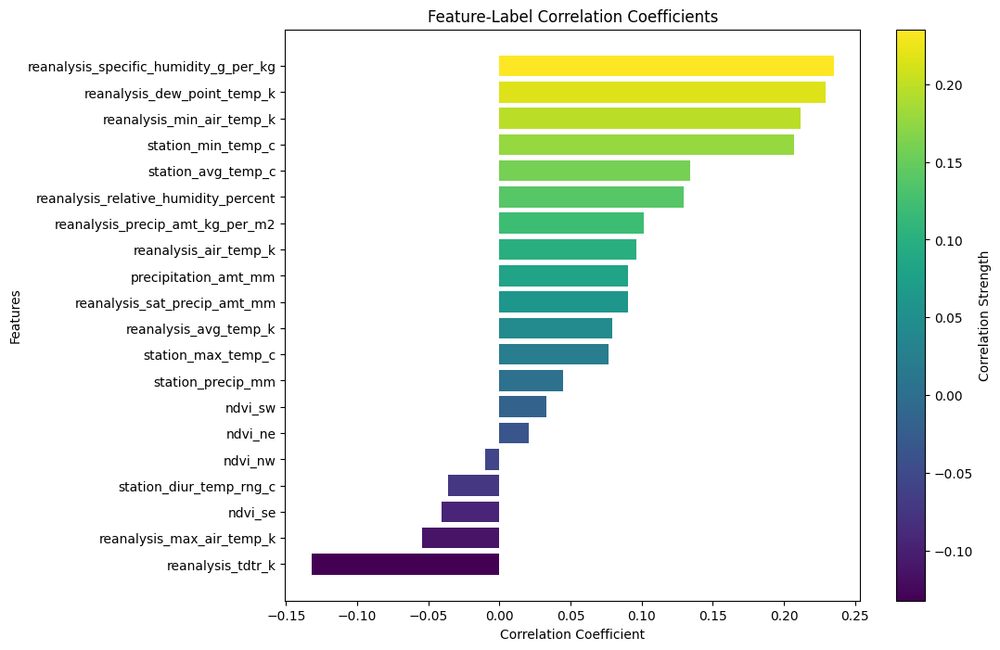

In [ ]:
# calculate correlation between features and label
plt.rcdefaults()
iq_df_feature_yufeng_selected = iq_df_feature_yufeng.drop(['year', 'weekofyear','week_start_date','city'], axis=1)
feature_label_correlation = iq_df_feature_yufeng_selected.corrwith(iq_df_label['total_cases'])

correlation_sorted = feature_label_correlation.sort_values()

colors = plt.cm.viridis(np.linspace(0, 1, len(correlation_sorted)))

fig = plt.subplots(figsize=(10, 8))

for idx, value in enumerate(correlation_sorted):
    plt.barh(idx, value, color=colors[idx])

plt.yticks(range(len(correlation_sorted)), correlation_sorted.index)
plt.title('Feature-Label Correlation Coefficients')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')

sm = plt.cm.ScalarMappable(cmap="viridis", norm=plt.Normalize(vmin=correlation_sorted.min(), vmax=correlation_sorted.max()))
sm.set_array([])
plt.colorbar(sm, label='Correlation Strength')

plt.show()

Sort correlation coefficients by absolute value.  
If the absolute value of the correlation coefficient is less than **0.1**, we consider it irrelevant and discard these features.

In [ ]:
correlation_sorted_abs = correlation_sorted.abs().sort_values(ascending=False)
correlation_sorted_by_abs = correlation_sorted[correlation_sorted_abs.index]
print(correlation_sorted_by_abs)

reanalysis_specific_humidity_g_per_kg    0.235218
reanalysis_dew_point_temp_k              0.229183
reanalysis_min_air_temp_k                0.211679
station_min_temp_c                       0.206817
station_avg_temp_c                       0.133989
reanalysis_tdtr_k                       -0.132191
reanalysis_relative_humidity_percent     0.129486
reanalysis_precip_amt_kg_per_m2          0.101150
reanalysis_air_temp_k                    0.096327
precipitation_amt_mm                     0.090628
reanalysis_sat_precip_amt_mm             0.090628
reanalysis_avg_temp_k                    0.079515
station_max_temp_c                       0.076665
reanalysis_max_air_temp_k               -0.054175
station_precip_mm                        0.044568
ndvi_se                                 -0.040643
station_diur_temp_rng_c                 -0.036134
ndvi_sw                                  0.032812
ndvi_ne                                  0.020794
ndvi_nw                                 -0.009952


**Visualize the selection process**

<ipython-input-114-d363bb742967>:25: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='Correlation Strength')


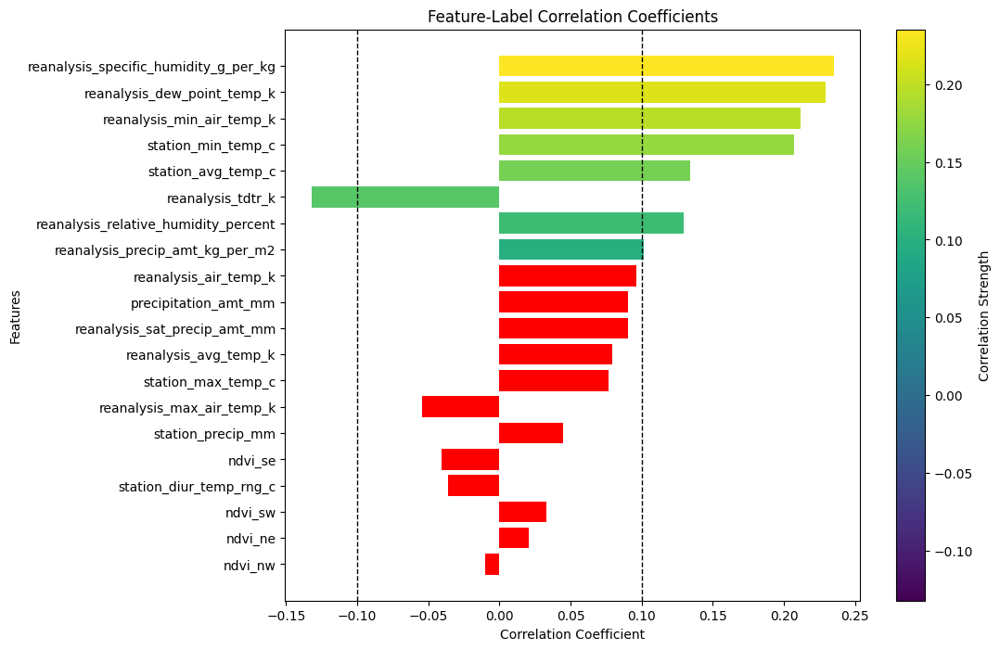

In [ ]:
# Sort by absolute value but still keep +/-
correlation_sorted_abs = correlation_sorted.abs().sort_values(ascending=True)

correlation_sorted_by_abs = correlation_sorted[correlation_sorted_abs.index]

plt.figure(figsize=(10, 8))

# We set a threshold of different colors
irrelevant_threshold = 0.1
for idx, (feature, value) in enumerate(correlation_sorted_by_abs.items()):
    color = 'red' if abs(value) < irrelevant_threshold else colors[idx]
    plt.barh(idx, value, color=color)

plt.yticks(range(len(correlation_sorted_by_abs)), correlation_sorted_by_abs.index)
plt.title('Feature-Label Correlation Coefficients')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')

# Add a threshold guide
plt.axvline(x=irrelevant_threshold, color='black', linestyle='--', lw=1)
plt.axvline(x=-irrelevant_threshold, color='black', linestyle='--', lw=1)

sm = plt.cm.ScalarMappable(cmap="viridis", norm=plt.Normalize(vmin=correlation_sorted_by_abs.min(), vmax=correlation_sorted_by_abs.max()))
sm.set_array([])
plt.colorbar(sm, label='Correlation Strength')

plt.show()

Before deleting the selected low-correlation features,  
first draw a scatter plot of these features and label, and try to fit a linear relationship line

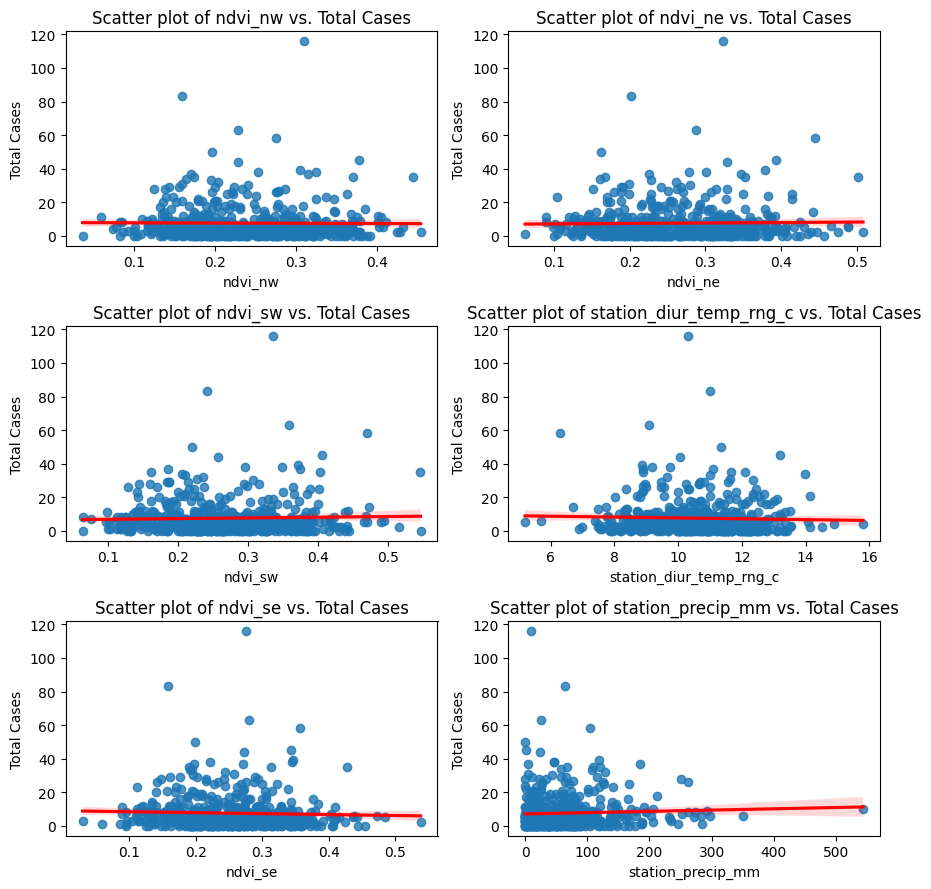

In [ ]:
lowest_correlation_features = correlation_sorted_by_abs.head(6).index
fig, axes = plt.subplots(3, 2, figsize=(9, 9))
axes = axes.flatten()


for i, feature in enumerate(lowest_correlation_features):
    sns.regplot(x=feature, y=iq_df_label['total_cases'], data=iq_df_feature_yufeng, ax=axes[i],
                line_kws={'color': 'red'})
    axes[i].set_title(f'Scatter plot of {feature} vs. Total Cases')
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Total Cases')

plt.tight_layout()
plt.show()

**These features have little information** according to this Visualization.  
So, we can drop them.  
(**The specific operation of selection will be done after generating a new general_temp.**)

Correlation analysis between temp features  

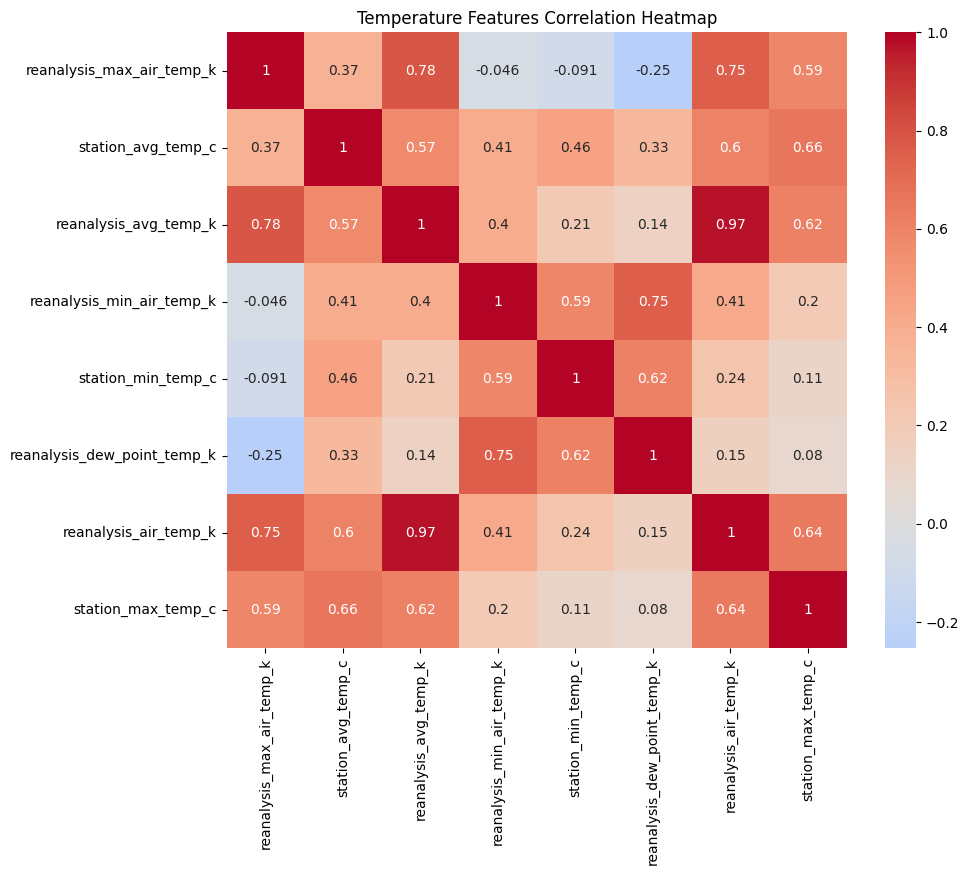

In [ ]:
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

temp_corr = iq_df_feature[temperature_features].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(temp_corr, annot=True, cmap='coolwarm', center=0)
plt.title('Temperature Features Correlation Heatmap')
plt.show()


#### 2.1.3: Feature Engineering
Based on the heat map of the selected features obtained in Section 2.1.2, this part will generate a new feature based on the current temperature features to summarize their information.  
Since temperature characteristics have different dimensions, I decided to normalize the data first and then calculate the average of their sum to generate a new feature column: **general_temp**

In [ ]:
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

for feature in temperature_features:
    min_value = iq_df_feature_yufeng_selected[feature].min()
    max_value = iq_df_feature_yufeng_selected[feature].max()
    iq_df_feature_yufeng_selected[feature] = (iq_df_feature_yufeng_selected[feature] - min_value) / (max_value - min_value)

iq_df_feature_yufeng_selected['general_temp'] = iq_df_feature_yufeng_selected[temperature_features].mean(axis=1)

#### 2.1.4: Final Features and Feature Scaling
From the earlier two steps in **2.1.2 and 2.1.3**, we decide that the features we will retain are those whose correlation with label is greater than 0.1.  
And do not belong to temperature features (temperature features have been all included in the newly generated general_temp)  


In [ ]:
selected_features = [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2'
]

iq_df_feature_yufeng_engineering = iq_df_feature_yufeng_selected[selected_features]

iq_df_feature_yufeng_engineering.head()

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2
936,0.489655,92.418571,16.651429,43.19
937,0.479777,93.581429,16.862857,46.00
938,0.452593,95.848571,17.120000,64.77
939,0.202175,87.234286,14.431429,23.96
940,0.418374,88.161429,15.444286,31.80


Feature Scaling before Modeling

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
iq_df_final_feature_yufeng = pd.DataFrame(scaler.fit_transform(iq_df_feature_yufeng_engineering),
                                                       columns=iq_df_feature_yufeng_engineering.columns,
                                                       index=iq_df_feature_yufeng_engineering.index)
iq_df_final_feature_yufeng.head()

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2
936,0.499484,0.848334,0.543713,0.119300
937,0.482323,0.876820,0.569033,0.127061
938,0.435091,0.932356,0.599829,0.178908
939,0.000000,0.721340,0.277844,0.066182
940,0.375637,0.744051,0.399145,0.087838


Now, the processed feature: **(iq_df_final_feature_yufeng)**   
is ready for training the model.

### For San Juan (sj)

**2.1.1 Clean the data:**

#### (Dealing with Missing Value)

In the dataset for sj, the feature with the highest number of missing values ndvi_ne has 191 missing entries.
This accounts for a certain proportion of the total data volume of sj, 936 rows, so we decided to discard this feature directly and fill in other features linearly

In [ ]:
sj_Missing_Value = sj_df_feature.isnull().sum()
sj_Missing_Value.sort_values(ascending=False)

ndvi_ne                                  191
ndvi_nw                                   49
ndvi_se                                   19
ndvi_sw                                   19
precipitation_amt_mm                       9
reanalysis_sat_precip_amt_mm               9
reanalysis_max_air_temp_k                  6
reanalysis_relative_humidity_percent       6
station_min_temp_c                         6
station_max_temp_c                         6
station_diur_temp_rng_c                    6
station_avg_temp_c                         6
reanalysis_tdtr_k                          6
reanalysis_specific_humidity_g_per_kg      6
station_precip_mm                          6
reanalysis_precip_amt_kg_per_m2            6
reanalysis_min_air_temp_k                  6
reanalysis_dew_point_temp_k                6
reanalysis_avg_temp_k                      6
reanalysis_air_temp_k                      6
year                                       0
week_start_date                            0
weekofyear

In [ ]:
def fill_missing_values_with_interpolation(df, feature_columns):
    """
    This is a custom function that uses the time series interpolation method to
    fill in missing values for the specified feature column.

    Parameters:
    - df: target dataset
    - feature_columns: Features want to replace missing value
    """
    for feature in feature_columns:
        if feature in df.columns:
            df[feature] = df[feature].interpolate(method='linear', limit_direction='both')
    # return df

In [ ]:
features_to_fill = [
    'station_diur_temp_rng_c', 'station_avg_temp_c', 'station_precip_mm',
    'station_max_temp_c', 'station_min_temp_c', 'reanalysis_min_air_temp_k',
    'reanalysis_tdtr_k', 'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_sat_precip_amt_mm', 'reanalysis_relative_humidity_percent',
    'reanalysis_precip_amt_kg_per_m2', 'reanalysis_max_air_temp_k',
    'reanalysis_dew_point_temp_k', 'reanalysis_avg_temp_k',
    'reanalysis_air_temp_k', 'precipitation_amt_mm', 'ndvi_sw',
    'ndvi_se', 'ndvi_nw'
]

# Call functions
sj_df_feature_yufeng = sj_df_feature.copy()
sj_df_feature_yufeng = sj_df_feature_yufeng.drop('ndvi_ne', axis=1)
sj_df_feature_yufeng.sort_values(by='week_start_date', inplace=True)
fill_missing_values_with_interpolation(sj_df_feature_yufeng, features_to_fill)

Check whether missing values after replacement.  

And there are **no more missing values** in the sj dataset.

In [ ]:
missing_values_rows = sj_df_feature_yufeng[features_to_fill].isnull().any(axis=1)
rows_with_missing_values = sj_df_feature_yufeng[missing_values_rows]
rows_with_missing_values

,city,year,weekofyear,week_start_date,ndvi_nw,ndvi_se,ndvi_sw,precipitation_amt_mm,reanalysis_air_temp_k,reanalysis_avg_temp_k,...,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_sat_precip_amt_mm,reanalysis_specific_humidity_g_per_kg,reanalysis_tdtr_k,station_avg_temp_c,station_diur_temp_rng_c,station_max_temp_c,station_min_temp_c,station_precip_mm


#### Fix Feature (Year)   
The year problem that previously appeared in the iq data also appeared in the sj data set, so we use the same method to deal with it. I won’t explain much here. The specific explanation is in the previous iq section.  
This time, error year was [1993, 1994, 1995, 1999, 2000, 2005, 2006] through identification by myself


In [ ]:
# Find Max_min weekofyear of each year
max_min_rows = pd.DataFrame()

for year in sj_df_feature_yufeng['year'].unique():
    year_data = sj_df_feature_yufeng[sj_df_feature_yufeng['year'] == year]
    max_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].max()].iloc[:, :4]
    min_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].min()].iloc[:, :4]
    max_min_rows = pd.concat([max_min_rows, max_row, min_row])

max_min_rows.reset_index(drop=True, inplace=True)

max_min_rows.sort_values(by=['year', 'weekofyear'], inplace=True)

max_min_rows

,city,year,weekofyear,week_start_date
1,sj,1990,18,1990-04-30
0,sj,1990,52,1990-12-24
3,sj,1991,1,1991-01-01
2,sj,1991,52,1991-12-24
5,sj,1992,1,1992-01-01
4,sj,1992,52,1992-12-23
7,sj,1993,1,1993-01-08
6,sj,1993,53,1993-01-01
9,sj,1994,1,1994-01-08
8,sj,1994,52,1994-01-01


In [ ]:

years_to_adjust = [1993, 1994, 1995, 1999, 2000, 2005, 2006]

sj_df_feature_yufeng['weekofyear'] = np.where(sj_df_feature_yufeng['year'].isin(years_to_adjust),
                                              sj_df_feature_yufeng['weekofyear'] + 1, sj_df_feature_yufeng['weekofyear'])

sj_df_feature_yufeng['weekofyear'] = np.where(sj_df_feature_yufeng['weekofyear'] > 52,
                                              1, sj_df_feature_yufeng['weekofyear'])



Check years_to_adjust was fixed.  
And other year was not changed.

In [ ]:
# Find Max_min weekofyear of each year
max_min_rows = pd.DataFrame()

for year in sj_df_feature_yufeng['year'].unique():
    year_data = sj_df_feature_yufeng[sj_df_feature_yufeng['year'] == year]
    max_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].max()].iloc[:, :4]
    min_row = year_data[year_data['weekofyear'] == year_data['weekofyear'].min()].iloc[:, :4]
    max_min_rows = pd.concat([max_min_rows, max_row, min_row])

max_min_rows.reset_index(drop=True, inplace=True)

max_min_rows.sort_values(by=['year', 'weekofyear'], inplace=True)

max_min_rows

,city,year,weekofyear,week_start_date
1,sj,1990,18,1990-04-30
0,sj,1990,52,1990-12-24
3,sj,1991,1,1991-01-01
2,sj,1991,52,1991-12-24
5,sj,1992,1,1992-01-01
4,sj,1992,52,1992-12-23
7,sj,1993,1,1993-01-01
6,sj,1993,52,1993-12-24
9,sj,1994,1,1994-01-01
8,sj,1994,52,1994-12-24


#### 2.1.2 Feature selection  
The approach for this analysis involves two steps.  
The general idea of this part is to first select correlated features to the label, and then conduct correlation analysis between features.   
As found here, the selected features are still relevant, especially in the temperature data. But directly selecting few of them may lose some information, so I decided to **generate new features based on these related temperature data** (See the process in the next part: 2.1.3:  **Feature engineering**)

**Correlation analysis between feature and label**  
Calculate and visualise the correlation between each feature in sj_df_feature_yufeng and sj_df_label ['total_cases']

<ipython-input-127-e8c75fcef191>:22: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='Correlation Strength')


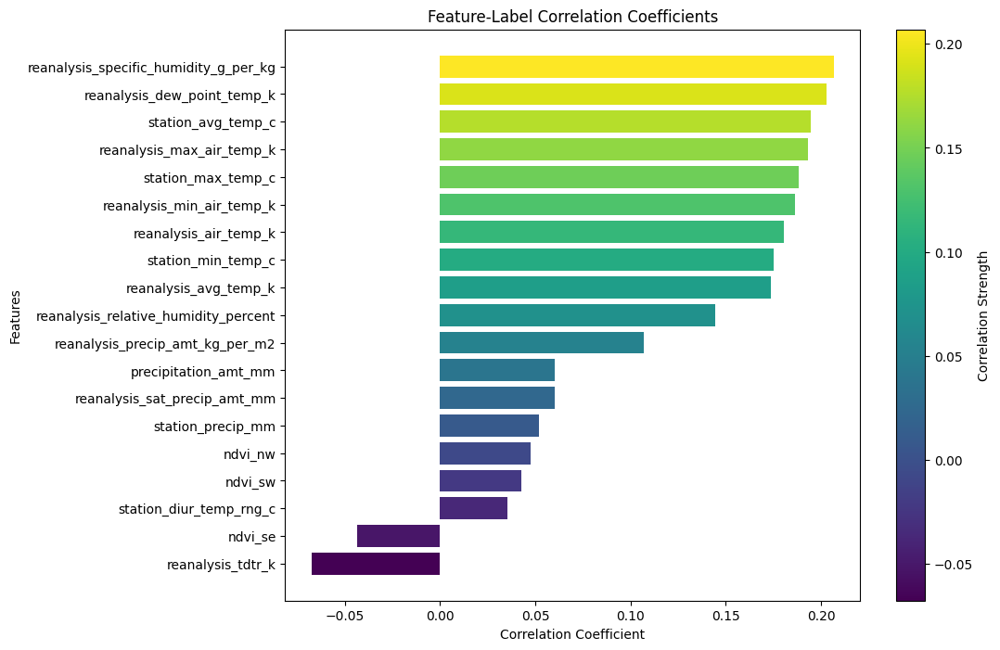

In [ ]:
# calculate correlation between features and label
plt.rcdefaults()
sj_df_feature_yufeng_selected = sj_df_feature_yufeng.drop(['year', 'weekofyear','week_start_date','city'], axis=1)
feature_label_correlation = sj_df_feature_yufeng_selected.corrwith(sj_df_label['total_cases'])

correlation_sorted = feature_label_correlation.sort_values()

colors = plt.cm.viridis(np.linspace(0, 1, len(correlation_sorted)))

fig = plt.subplots(figsize=(10, 8))

for idx, value in enumerate(correlation_sorted):
    plt.barh(idx, value, color=colors[idx])

plt.yticks(range(len(correlation_sorted)), correlation_sorted.index)
plt.title('Feature-Label Correlation Coefficients')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')

sm = plt.cm.ScalarMappable(cmap="viridis", norm=plt.Normalize(vmin=correlation_sorted.min(), vmax=correlation_sorted.max()))
sm.set_array([])
plt.colorbar(sm, label='Correlation Strength')

plt.show()

Sort correlation coefficients by absolute value.  
If the absolute value of the correlation coefficient is less than **0.1**, we consider it irrelevant and discard these features.

In [ ]:
correlation_sorted_abs = correlation_sorted.abs().sort_values(ascending=False)
correlation_sorted_by_abs = correlation_sorted[correlation_sorted_abs.index]
print(correlation_sorted_by_abs)

reanalysis_specific_humidity_g_per_kg    0.206942
reanalysis_dew_point_temp_k              0.202807
station_avg_temp_c                       0.194823
reanalysis_max_air_temp_k                0.193233
station_max_temp_c                       0.188447
reanalysis_min_air_temp_k                0.186539
reanalysis_air_temp_k                    0.180311
station_min_temp_c                       0.175248
reanalysis_avg_temp_k                    0.173670
reanalysis_relative_humidity_percent     0.144404
reanalysis_precip_amt_kg_per_m2          0.106939
reanalysis_tdtr_k                       -0.067623
precipitation_amt_mm                     0.060296
reanalysis_sat_precip_amt_mm             0.060296
station_precip_mm                        0.051883
ndvi_nw                                  0.047403
ndvi_se                                 -0.043680
ndvi_sw                                  0.042670
station_diur_temp_rng_c                  0.035303
dtype: float64


**Visualize the selection process**

<ipython-input-129-d363bb742967>:25: MatplotlibDeprecationWarning: Unable to determine Axes to steal space for Colorbar. Using gca(), but will raise in the future. Either provide the *cax* argument to use as the Axes for the Colorbar, provide the *ax* argument to steal space from it, or add *mappable* to an Axes.
  plt.colorbar(sm, label='Correlation Strength')


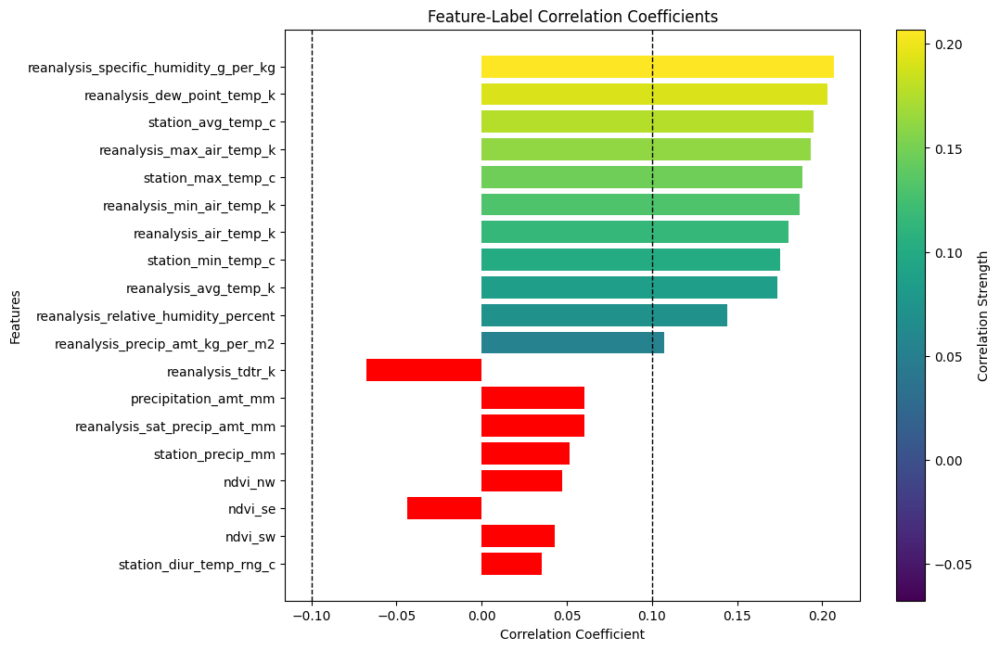

In [ ]:
# Sort by absolute value but still keep +/-
correlation_sorted_abs = correlation_sorted.abs().sort_values(ascending=True)

correlation_sorted_by_abs = correlation_sorted[correlation_sorted_abs.index]

plt.figure(figsize=(10, 8))

# We set a threshold of different colors
irrelevant_threshold = 0.1
for idx, (feature, value) in enumerate(correlation_sorted_by_abs.items()):
    color = 'red' if abs(value) < irrelevant_threshold else colors[idx]
    plt.barh(idx, value, color=color)

plt.yticks(range(len(correlation_sorted_by_abs)), correlation_sorted_by_abs.index)
plt.title('Feature-Label Correlation Coefficients')
plt.xlabel('Correlation Coefficient')
plt.ylabel('Features')

# Add a threshold guide
plt.axvline(x=irrelevant_threshold, color='black', linestyle='--', lw=1)
plt.axvline(x=-irrelevant_threshold, color='black', linestyle='--', lw=1)

sm = plt.cm.ScalarMappable(cmap="viridis", norm=plt.Normalize(vmin=correlation_sorted_by_abs.min(), vmax=correlation_sorted_by_abs.max()))
sm.set_array([])
plt.colorbar(sm, label='Correlation Strength')

plt.show()

Before deleting the selected low-correlation features,  
first draw a scatter plot of last 6 features and label, and try to fit a linear relationship line

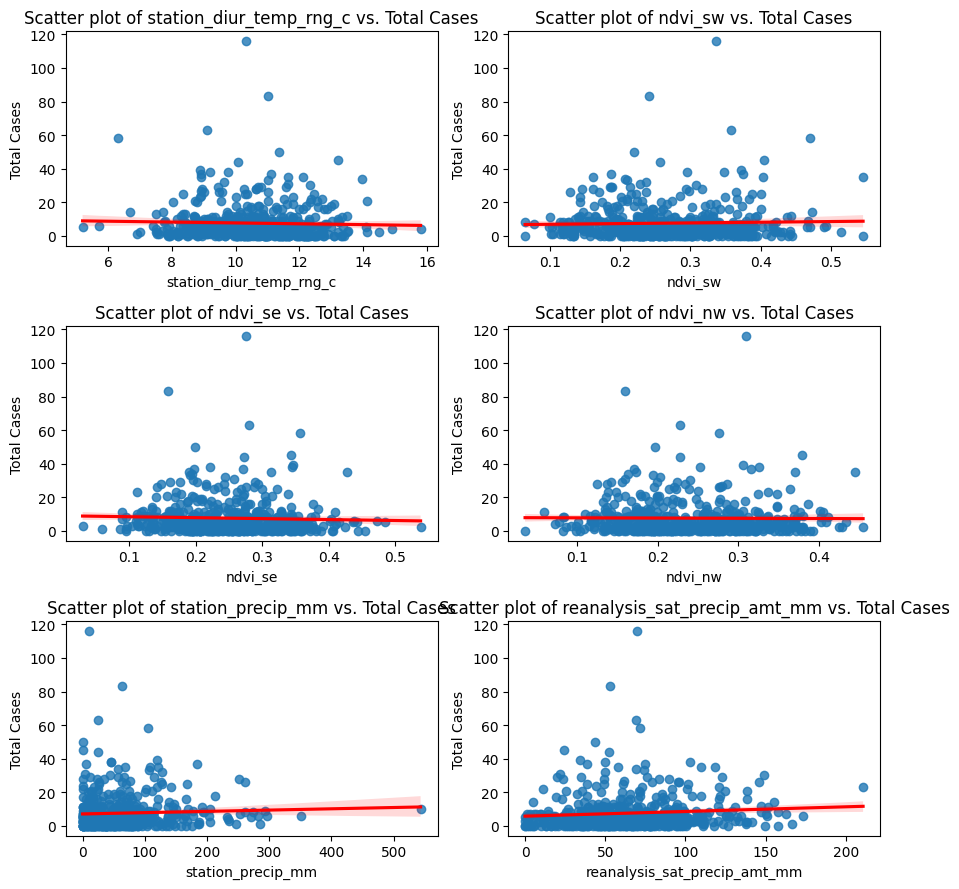

In [ ]:
lowest_correlation_features = correlation_sorted_by_abs.head(6).index
fig, axes = plt.subplots(3, 2, figsize=(9, 9))
axes = axes.flatten()


for i, feature in enumerate(lowest_correlation_features):
    sns.regplot(x=feature, y=iq_df_label['total_cases'], data=iq_df_feature_yufeng, ax=axes[i],
                line_kws={'color': 'red'})
    axes[i].set_title(f'Scatter plot of {feature} vs. Total Cases')
    axes[i].set_xlabel(feature)
    axes[i].set_ylabel('Total Cases')

plt.tight_layout()
plt.show()

**These features have little information** according to this Visualization.  
So, we can drop them.  
(**The specific operation of selection will be done after generating a new general_temp.**)

Correlation analysis between temp features  

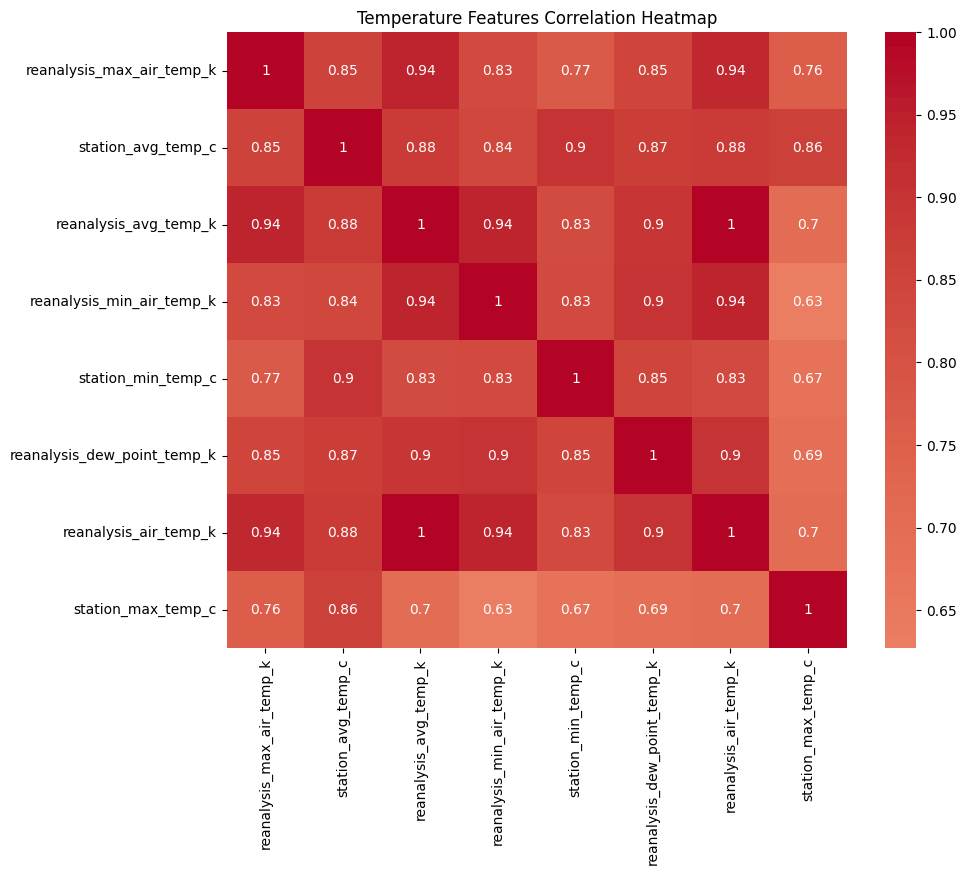

In [ ]:
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

temp_corr = sj_df_feature[temperature_features].corr()

plt.figure(figsize=(10, 8))
sns.heatmap(temp_corr, annot=True, cmap='coolwarm', center=0)
plt.title('Temperature Features Correlation Heatmap')
plt.show()


**They are even more high correlated with each other than iq !!!**

#### 2.1.3: Feature Engineering
Based on the heat map of the selected features obtained in Section 2.1.2, this part will generate a new feature based on the current temperature features to summarize their information.  
Since temperature characteristics have different dimensions, I decided to normalize the data first and then calculate the sum of their average to generate a new feature column: **general_temp**

In [ ]:
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

for feature in temperature_features:
    min_value = sj_df_feature_yufeng_selected[feature].min()
    max_value = sj_df_feature_yufeng_selected[feature].max()
    sj_df_feature_yufeng_selected[feature] = (sj_df_feature_yufeng_selected[feature] - min_value) / (max_value - min_value)

sj_df_feature_yufeng_selected['general_temp'] = sj_df_feature_yufeng_selected[temperature_features].mean(axis=1)

#### 2.1.4: Final Features and Feature Scaling
From the earlier two steps in **2.1.2 and 2.1.3**, we decide that the features we will retain are those whose correlation with label is greater than 0.1.  
And do not belong to temperature features (temperature features have been all included in the newly generated general_temp)   
So they are [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2'
]


In [ ]:
selected_features = [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2'
]

sj_df_feature_yufeng_engineering = sj_df_feature_yufeng_selected[selected_features]

sj_df_feature_yufeng_engineering.head()

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2
0,0.321873,73.365714,14.012857,32.00
1,0.491912,77.368571,15.372857,17.94
2,0.559386,82.052857,16.848571,26.10
3,0.617544,80.337143,16.672857,13.90
4,0.722110,80.460000,17.210000,12.20


Feature Scaling before Modeling

In [ ]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
sj_df_final_feature_yufeng = pd.DataFrame(scaler.fit_transform(sj_df_feature_yufeng_engineering),
                                                       columns=sj_df_feature_yufeng_engineering.columns,
                                                       index=sj_df_feature_yufeng_engineering.index)
sj_df_final_feature_yufeng.head()

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2
0,0.297955,0.318138,0.297392,0.056091
1,0.490281,0.510214,0.473460,0.031446
2,0.566598,0.734988,0.664509,0.045749
3,0.632380,0.652660,0.641761,0.024365
4,0.750651,0.658555,0.711300,0.021385


Now, the processed feature: **(sj_df_final_feature_yufeng)**   
is ready for training the model.

## 3. First time Modeling
In this section, I will directly analyze performance and shortcomings of the model after training and improve it. Therefore, I combined the modeling and evaluation parts into one part.  


**About evaluation metrics:** As mentioned in the part 1, this task comes from a competition. The competition organizer has chosen the Mean absolute error (**MAE**) as evaluation matric, and I will follow it.


### 3.1 Deep Neural Network(DNN)
Got MAE: 27.2197 in the competition, Ranked #4193.

#### 3.1.1 Extra Feature engineering (PCA) in DNN

In [ ]:
print(iq_df_final_feature_yufeng.shape)
from sklearn.decomposition import PCA

pca = PCA(n_components=4)

iq_features_pca_yufeng = pca.fit_transform(iq_df_final_feature_yufeng)

print('pca.explained_variance_ratio_:', pca.explained_variance_ratio_)

(520, 4)
pca.explained_variance_ratio_: [0.57818906 0.32498518 0.09097609 0.00584968]


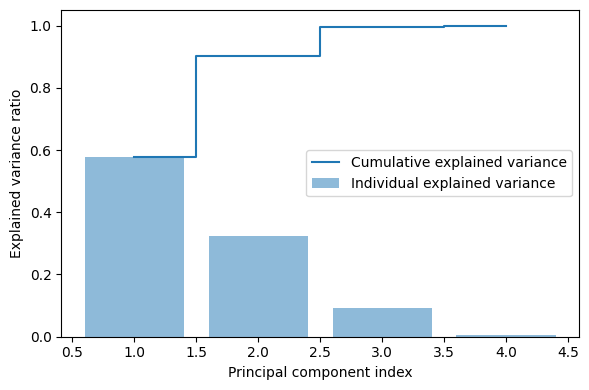

In [ ]:
import matplotlib.pyplot as plt

cumulative_explained_variance = np.cumsum(pca.explained_variance_ratio_)

plt.figure(figsize=(6, 4))
plt.bar(range(1, len(pca.explained_variance_ratio_) + 1), pca.explained_variance_ratio_, alpha=0.5, align='center', label='Individual explained variance')
plt.step(range(1, len(cumulative_explained_variance) + 1), cumulative_explained_variance, where='mid', label='Cumulative explained variance')
plt.ylabel('Explained variance ratio')
plt.xlabel('Principal component index')
plt.legend(loc='best')
plt.tight_layout()
plt.show()

So, we can reduce the feature to three dimensions and retain 99.5% of the information to further reduce the amount of calculation

In [ ]:
pca3 = PCA(n_components=3)
iq_features_pca_yufeng = pca3.fit_transform(iq_df_final_feature_yufeng)

In [ ]:
iq_features_pca_yufeng.shape

(520, 3)

#### 3.2 Training the DNN model for **iq** city
i): Since the organizers of the competition stipulate the use of MAE as an indicator, we also apply MAE as evaluation metrics.  
ii): Since the **test set has been reserved by the competition organizer**, we will not distribute an additional test set. The rankings and scores obtained by the official submission will be used as the performance of the model on the test set.  
iii): In this training, K-flod (K = 5) was used for the validation set to verify the generalization performance of the model, and early stopping was used to avoid overfitting. When the model does not improve on the validation set loss for more than 10 rounds, it will stop early.

Fold 1, MSE: 86.09778594970703, MAE: 6.839188098907471
Fold 2, MSE: 199.05770874023438, MAE: 7.730023384094238
Fold 3, MSE: 65.73249816894531, MAE: 5.339293479919434
Fold 4, MSE: 168.52267456054688, MAE: 7.874172687530518
Fold 5, MSE: 49.22602844238281, MAE: 5.389793395996094
17/17 [==============================] - 0s 2ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


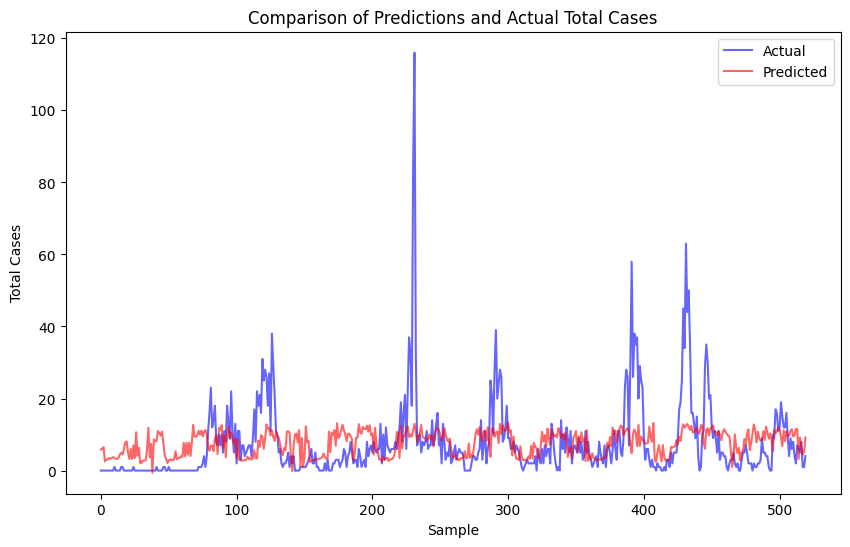

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import KFold
from tensorflow.keras.models import Sequential, load_model
from tensorflow.keras.layers import Dense
import matplotlib.pyplot as plt

def create_model(input_shape):
    model = Sequential([
        Dense(128, activation='relu', input_shape=(input_shape,)),
        Dense(64, activation='relu'),
        Dense(32, activation='relu'),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse', metrics=['mae'])
    return model

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=10, verbose=1, mode='min', restore_best_weights=True)

# K-fold
kfold = KFold(n_splits=5, shuffle=True, random_state=42)

# Prepare the data
X = iq_features_pca_yufeng
y = iq_df_label['total_cases'].values

scores = []
for train, test in kfold.split(X, y):
    model = create_model(X.shape[1])
    model.fit(X[train], y[train], epochs=100, batch_size=32, verbose=0, validation_data=(X[test], y[test]), callbacks=[early_stopping])
    scores.append(model.evaluate(X[test], y[test], verbose=0))

for i, score in enumerate(scores, 1):
    print(f"Fold {i}, MSE: {score[0]}, MAE: {score[1]}")

final_model = create_model(X.shape[1])
final_model.fit(X, y, epochs=100, batch_size=32, verbose=0, callbacks=[early_stopping])

# save model
final_model.save('DNN_model_iq.h5')

predictions = final_model.predict(X)

# Comparison of Predictions and Actual Total Cases
plt.figure(figsize=(10, 6))
plt.plot(y, label='Actual', color='blue', alpha=0.6)
plt.plot(predictions.flatten(), label='Predicted', color='red', alpha=0.6)
plt.title('Comparison of Predictions and Actual Total Cases')
plt.xlabel('Sample')
plt.ylabel('Total Cases')
plt.legend()
plt.show()


#### 3.3 Same steps of DNN for sj city

In [ ]:
print(sj_df_final_feature_yufeng.shape)
from sklearn.decomposition import PCA

pca = PCA(n_components=4)

sj_features_pca_yufeng = pca.fit_transform(sj_df_final_feature_yufeng)

print('pca.explained_variance_ratio_:', pca.explained_variance_ratio_)

(936, 4)
pca.explained_variance_ratio_: [0.80408858 0.17022878 0.02009264 0.00559   ]


In [ ]:
pca3 = PCA(n_components=3)
sj_features_pca_yufeng = pca3.fit_transform(sj_df_final_feature_yufeng)

Restoring model weights from the end of the best epoch: 33.
Epoch 43: early stopping
Restoring model weights from the end of the best epoch: 44.
Epoch 54: early stopping
Restoring model weights from the end of the best epoch: 34.
Epoch 44: early stopping
Fold 1, MSE: 2478.5263671875, MAE: 28.77770233154297
Fold 2, MSE: 2638.06494140625, MAE: 28.153549194335938
Fold 3, MSE: 3044.68310546875, MAE: 28.307159423828125
Fold 4, MSE: 2907.51171875, MAE: 28.68666648864746
Fold 5, MSE: 1651.1689453125, MAE: 23.10775375366211
30/30 [==============================] - 0s 1ms/step


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


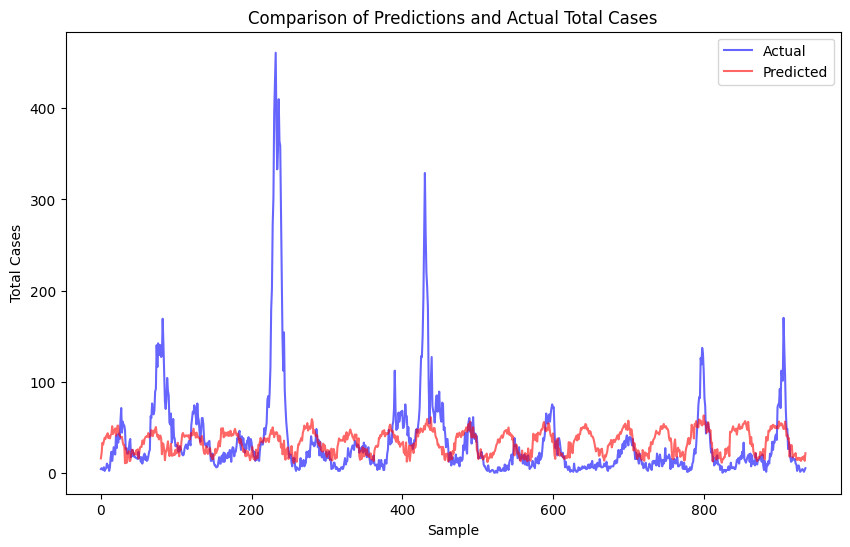

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping
from sklearn.model_selection import KFold
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Create the model
def create_model(input_shape):
    model = Sequential([
        Dense(128, activation='relu', input_shape=(input_shape,)),
        Dense(64, activation='relu'),
        Dense(32, activation='relu'),
        Dense(1)
    ])
    model.compile(optimizer='adam', loss='mse', metrics=['mae'])
    return model

# Early stopping callback
early_stopping = EarlyStopping(monitor='loss', patience=10, verbose=1, mode='min', restore_best_weights=True)

# K-fold
#
kfold = KFold(n_splits=5, shuffle=True, random_state=42)

# Prepare the data
X = sj_features_pca_yufeng
y = sj_df_label['total_cases'].values

scores = []
for train, test in kfold.split(X, y):
    model = create_model(X.shape[1])
    model.fit(X[train], y[train], epochs=100, batch_size=32, verbose=0, validation_data=(X[test], y[test]), callbacks=[early_stopping])
    scores.append(model.evaluate(X[test], y[test], verbose=0))

for i, score in enumerate(scores, 1):
    print(f"Fold {i}, MSE: {score[0]}, MAE: {score[1]}")

final_model = create_model(X.shape[1])
final_model.fit(X, y, epochs=100, batch_size=32, verbose=0, callbacks=[early_stopping])

# save model
final_model.save('DNN_model_sj.h5')

predictions = model.predict(X)

# Visualize prediction results comparing actual labels
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(y, label='Actual', color='blue', alpha=0.6)
plt.plot(predictions.flatten(), label='Predicted', color='red', alpha=0.6)
plt.title('Comparison of Predictions and Actual Total Cases')
plt.xlabel('Sample')
plt.ylabel('Total Cases')
plt.legend()
plt.show()

#### 3.4 Submission and Performance on test set

The features in test set also need Data preprocessing  

For iq

In [ ]:
features_to_fill = [
    'station_diur_temp_rng_c', 'station_avg_temp_c', 'station_precip_mm',
    'station_max_temp_c', 'station_min_temp_c', 'reanalysis_min_air_temp_k',
    'reanalysis_tdtr_k', 'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_sat_precip_amt_mm', 'reanalysis_relative_humidity_percent',
    'reanalysis_precip_amt_kg_per_m2', 'reanalysis_max_air_temp_k',
    'reanalysis_dew_point_temp_k', 'reanalysis_avg_temp_k',
    'reanalysis_air_temp_k', 'precipitation_amt_mm', 'ndvi_sw',
    'ndvi_se', 'ndvi_nw', 'ndvi_ne'
]

# Call functions
iq_df_test_yufeng = iq_test_df.copy()
iq_df_test_yufeng.sort_values(by='week_start_date', inplace=True)
fill_missing_values_with_interpolation(iq_df_test_yufeng, features_to_fill)

# Correct weekofyear in testset
years_to_adjust = [2011, 2012]

iq_df_test_yufeng['weekofyear'] = np.where(iq_df_test_yufeng['year'].isin(years_to_adjust),
                                              iq_df_test_yufeng['weekofyear'] + 1, iq_df_test_yufeng['weekofyear'])

iq_df_test_yufeng['weekofyear'] = np.where(iq_df_test_yufeng['weekofyear'] > 52,
                                              1, iq_df_test_yufeng['weekofyear'])

# Generate general_temp for testset
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

for feature in temperature_features:
    min_value = iq_df_test_yufeng[feature].min()
    max_value = iq_df_test_yufeng[feature].max()
    iq_df_test_yufeng[feature] = (iq_df_test_yufeng[feature] - min_value) / (max_value - min_value)

iq_df_test_yufeng['general_temp'] = iq_df_test_yufeng[temperature_features].mean(axis=1)

# Selection
selected_features = [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2'
]

iq_df_test_yufeng_engineering = iq_df_test_yufeng[selected_features]

# get Final_test for iq
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
iq_df_final_test_yufeng = pd.DataFrame(scaler.fit_transform(iq_df_test_yufeng_engineering),
                                                       columns=iq_df_test_yufeng_engineering.columns,
                                                       index=iq_df_test_yufeng_engineering.index)

# Extra Feature engineering for DNN
pca3 = PCA(n_components=3)
iq_test_pca_yufeng = pca3.fit_transform(iq_df_final_test_yufeng)


In [ ]:
iq_test_pca_yufeng.shape

(156, 3)

**For sj**

In [ ]:
features_to_fill = [
    'station_diur_temp_rng_c', 'station_avg_temp_c', 'station_precip_mm',
    'station_max_temp_c', 'station_min_temp_c', 'reanalysis_min_air_temp_k',
    'reanalysis_tdtr_k', 'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_sat_precip_amt_mm', 'reanalysis_relative_humidity_percent',
    'reanalysis_precip_amt_kg_per_m2', 'reanalysis_max_air_temp_k',
    'reanalysis_dew_point_temp_k', 'reanalysis_avg_temp_k',
    'reanalysis_air_temp_k', 'precipitation_amt_mm', 'ndvi_sw',
    'ndvi_se', 'ndvi_nw', 'ndvi_ne'
]

# Call functions
sj_df_test_yufeng = sj_test_df.copy()
sj_df_test_yufeng.sort_values(by='week_start_date', inplace=True)
fill_missing_values_with_interpolation(sj_df_test_yufeng, features_to_fill)

# Correct weekofyear in testset
years_to_adjust = [2010,2011, 2012]

sj_df_test_yufeng['weekofyear'] = np.where(sj_df_test_yufeng['year'].isin(years_to_adjust),
                                              sj_df_test_yufeng['weekofyear'] + 1, sj_df_test_yufeng['weekofyear'])

sj_df_test_yufeng['weekofyear'] = np.where(sj_df_test_yufeng['weekofyear'] > 52,
                                              1, sj_df_test_yufeng['weekofyear'])

# Generate general_temp for testset
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

for feature in temperature_features:
    min_value = sj_df_test_yufeng[feature].min()
    max_value = sj_df_test_yufeng[feature].max()
    sj_df_test_yufeng[feature] = (sj_df_test_yufeng[feature] - min_value) / (max_value - min_value)

sj_df_test_yufeng['general_temp'] = sj_df_test_yufeng[temperature_features].mean(axis=1)

# Selection
selected_features = [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2'
]

sj_df_test_yufeng_engineering = sj_df_test_yufeng[selected_features]

# get Final_test for iq
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
sj_df_final_test_yufeng = pd.DataFrame(scaler.fit_transform(sj_df_test_yufeng_engineering),
                                                       columns=sj_df_test_yufeng_engineering.columns,
                                                       index=sj_df_test_yufeng_engineering.index)

# Extra Feature engineering for DNN
pca3 = PCA(n_components=3)
sj_test_pca_yufeng = pca3.fit_transform(sj_df_final_test_yufeng)



In [ ]:
sj_test_pca_yufeng.shape

(260, 3)

In [ ]:
from tensorflow.keras.models import load_model
model_iq = load_model('DNN_model_iq.h5')
iq_submit = model_iq.predict(iq_test_pca_yufeng).astype(int)
model_sj = load_model('DNN_model_sj.h5')
sj_submit = model_sj.predict(sj_test_pca_yufeng).astype(int)
submission = pd.read_csv('/content/submission_format.csv',
                            index_col=[0, 1, 2])
submission.total_cases = np.concatenate([sj_submit, iq_submit])
submission.to_csv("/content/DNN.csv")

9/9 [==============================] - 0s 2ms/step


## 4. Evaluation and Try to find a more suitable model
**Problem**: From the visual picture of predicted and actual values, the DNN did not predict the dengue outbreak by time.  
**Analysis**: In order to better put it into the neural network for training, I only save float type data and applied Dimensionality reduction method.  
However, further EDA proved that this regression task is related to time, especially the outbreak period of dengue fever that DNN cannot predict.
**Possible solution:** Use **decision tree models** for regression tasks to better consider temporal characteristics

### 4.1 Further EDA
Then show the trends in total dengue fever cases in iq over time.  
From here we can learn that the number of dengue fever cases may be affected by time


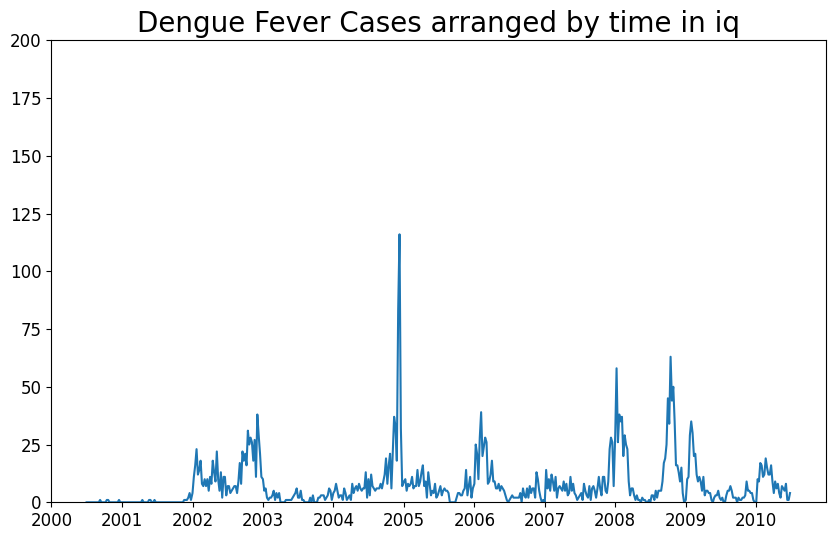

In [ ]:
# dengue fever cases of iq city
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

plt.figure(figsize=[10,6])
plt.title('Dengue Fever Cases arranged by time in iq', fontsize=20)
plt.plot(pd.to_datetime(iq_df_feature.week_start_date), iq_df_label.total_cases)

# from 2000 to 2011 arranged by week
start_date = mdates.date2num(pd.to_datetime('2000-01-01'))
end_date = mdates.date2num(pd.to_datetime('2010-12-31'))

plt.xlim([start_date, end_date])
plt.ylim([0,200])
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

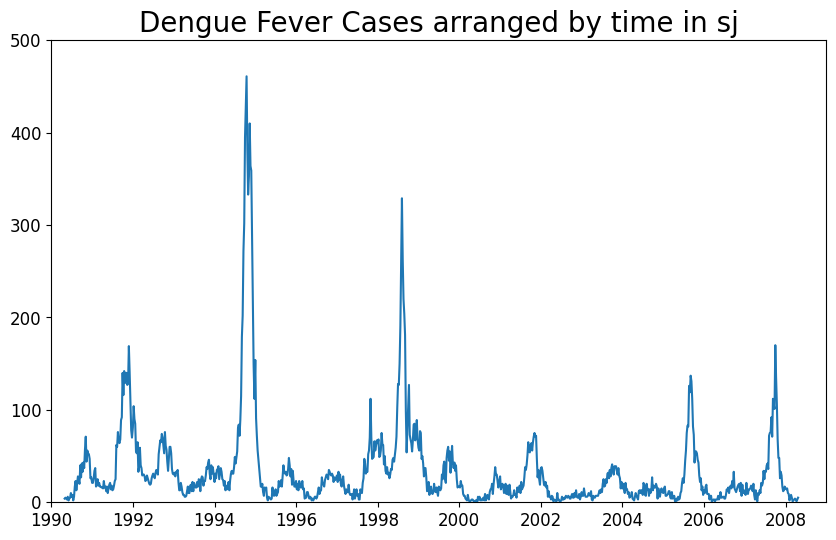

In [ ]:
# dengue fever cases of sj city
import matplotlib.pyplot as plt
import pandas as pd
import matplotlib.dates as mdates

plt.figure(figsize=[10,6])
plt.title('Dengue Fever Cases arranged by time in sj', fontsize=20)
plt.plot(pd.to_datetime(sj_df_feature.week_start_date), sj_df_label.total_cases)

# from 2000 to 2011 arranged by week
start_date = mdates.date2num(pd.to_datetime('1990-01-01'))
end_date = mdates.date2num(pd.to_datetime('2008-12-31'))

plt.xlim([start_date, end_date])
plt.ylim([0,500])
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.show()

### 4.2 Decision Tree


#### 4.2.1 Training Decision Tree For iq

**iq_df_feature_yufeng_engineering:** iq Features prepared in 2.1.3 Feature engineering part.   

Here we only need to add the deleted time features ['year',
 'weekofyear',  'week_start_date'] to the data that has been filtered and added to general_temp.

In [ ]:
# add ['year', 'weekofyear', 'week_start_date'] back and name the data as iq_df_feature_DT
columns_to_add = iq_df_feature_yufeng[['year', 'weekofyear']]

iq_df_feature_DT = pd.concat([iq_df_feature_yufeng_engineering, columns_to_add], axis=1)

X = iq_df_feature_DT
y = iq_df_label['total_cases']
y_df = y.to_frame(name='total_cases')
iq_df_all_DT = pd.concat([X, y_df], axis=1)
iq_df_all_DT

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,year,weekofyear,total_cases
936,0.489655,92.418571,16.651429,43.19,2000,26,0
937,0.479777,93.581429,16.862857,46.00,2000,27,0
938,0.452593,95.848571,17.120000,64.77,2000,28,0
939,0.202175,87.234286,14.431429,23.96,2000,29,0
940,0.418374,88.161429,15.444286,31.80,2000,30,0
...,...,...,...,...,...,...,...
1451,0.719307,88.765714,18.485714,45.00,2010,22,5
1452,0.595530,91.600000,18.070000,207.10,2010,23,8
1453,0.403419,94.280000,17.008571,50.60,2010,24,1
1454,0.420729,94.660000,16.815714,62.33,2010,25,1


iq_df_feature_DT is training data for Decision Tree (DT) of iq city

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
import joblib
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

X = iq_df_feature_DT
y = iq_df_label['total_cases']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

DT_model_iq = DecisionTreeRegressor(random_state=42)

DT_model_iq.fit(X_train, y_train)

predictions = DT_model_iq.predict(X_test)

# Calculate MAE on test set
mae = mean_absolute_error(y_test, predictions)
print("Mean Absolute Error on the test set MAE:", mae)

# save the model
joblib.dump(DT_model_iq, 'DT_model_iq.joblib')

# Visualization the tree
plt.figure(figsize=(200, 100))
plot_tree(DT_model_iq, filled=True, feature_names=X.columns, rounded=True, fontsize=12)
plt.show()


Mean Absolute Error on the test set MAE: 6.0576923076923075


#### 4.2.2 Training Decision Tree For sj

**sj_df_feature_yufeng_engineering:** sj Features prepared in 2.1.3 Feature engineering part.   

Here we only need to add the deleted time features ['year',
 'weekofyear'] to the data that has been filtered and added to general_temp.

In [ ]:
# add ['year', 'weekofyear'] back and name the data as iq_df_feature_DT
columns_to_add = sj_df_feature_yufeng[['year', 'weekofyear']]

sj_df_feature_DT = pd.concat([sj_df_feature_yufeng_engineering, columns_to_add], axis=1)

X = sj_df_feature_DT
y = sj_df_label['total_cases']
y_df = y.to_frame(name='total_cases')
sj_df_all_DT = pd.concat([X, y_df], axis=1)
sj_df_all_DT

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,year,weekofyear,total_cases
0,0.321873,73.365714,14.012857,32.00,1990,18,4
1,0.491912,77.368571,15.372857,17.94,1990,19,5
2,0.559386,82.052857,16.848571,26.10,1990,20,4
3,0.617544,80.337143,16.672857,13.90,1990,21,3
4,0.722110,80.460000,17.210000,12.20,1990,22,6
...,...,...,...,...,...,...,...
931,0.280021,74.247143,13.644286,7.55,2008,13,4
932,0.430873,74.600000,14.662857,3.67,2008,14,3
933,0.330995,75.027143,14.184286,35.00,2008,15,1
934,0.344702,72.285714,13.858571,4.82,2008,16,3


iq_df_feature_DT is training data for Decision Tree (DT) of iq city

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
import joblib
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

X = sj_df_feature_DT
y = sj_df_label['total_cases']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

DT_model_sj = DecisionTreeRegressor(random_state=42)

DT_model_sj.fit(X_train, y_train)

predictions = DT_model_sj.predict(X_test)

# Calculate MAE on test set
mae = mean_absolute_error(y_test, predictions)
print("Mean Absolute Error on the test set MAE:", mae)

# save the model
joblib.dump(DT_model_sj, 'DT_model_sj.joblib')

# Visualization the tree
plt.figure(figsize=(200, 100))
plot_tree(DT_model_sj, filled=True, feature_names=X.columns, rounded=True, fontsize=12)
plt.show()


Mean Absolute Error on the test set MAE: 15.48936170212766


#### 4.3.3 Submission of Decision Tree and its perference
sj_df_test_yufeng_DT: Processed test set data for decision trees of sj  
iq_df_test_yufeng_DT: Processed test set data for decision trees of iq

In [ ]:
sj_df_test_yufeng_DT = sj_df_test_yufeng_engineering

In [ ]:
# add ['year', 'weekofyear'] back and name the data as sj_df_test_DT_yufeng
columns_to_add = sj_df_test_yufeng[['year', 'weekofyear']]
sj_df_test_DT_yufeng = pd.concat([sj_df_test_yufeng_engineering, columns_to_add], axis=1)

In [ ]:
# add ['year', 'weekofyear'] back and name the data as iq_df_feature_DT
columns_to_add = iq_df_test_yufeng[['year', 'weekofyear']]
iq_df_test_DT_yufeng = pd.concat([iq_df_test_yufeng_engineering, columns_to_add], axis=1)

In [ ]:
# Load the model and predict IQ data
DT_model_iq = joblib.load('DT_model_iq.joblib')
iq_submit = DT_model_iq.predict(iq_df_test_DT_yufeng).astype(int)

# Load the model and predict sj data
DT_model_sj = joblib.load('DT_model_sj.joblib')
sj_submit = DT_model_sj.predict(sj_df_test_DT_yufeng).astype(int)

submission = pd.read_csv('/content/submission_format.csv', index_col=[0, 1, 2])

submission.total_cases = np.concatenate([sj_submit, iq_submit])

submission.to_csv("/content/DT.csv")

This model got 30.4543 MAE in competition

### 4.3 Further analysis on tree model and find better a model
**Prepared Data**:  
sj_df_feature_DT  
iq_df_feature_DT  
**Problem**: The decision tree model seems to be overfitting. The MAE of the decision tree model on the iq city validation set is 6.05, and the MAE on the sj city validation set is 15.49.  
However, the performance on the test set provided by the competition organizer was poor, and its MAE reached 30.   


**Analysis**: This may be caused by the characteristic of **year**. For iq city, the training set data consists of 2000 to 2010, while the test set years are from 2010 to 2013, which means that in fact, the year feature is an unseen feature for the trained decision tree model.  
At the same time, since the outbreak situation is different for each year, it is unwise to directly delete the weekofyear.



**Possible solution:** Demarcating dengue fever outbreak periods as a new feature

#### 4.3.1: For iq: (New Feature) Outbreak and low peak periods
For iq city, we determine   
week 1 to week 11 as sub-peak period  
week 11 to week 20 as sub-trough period  
week 20 to week 36 as trough period  
week 36 to week 52 as peak period  

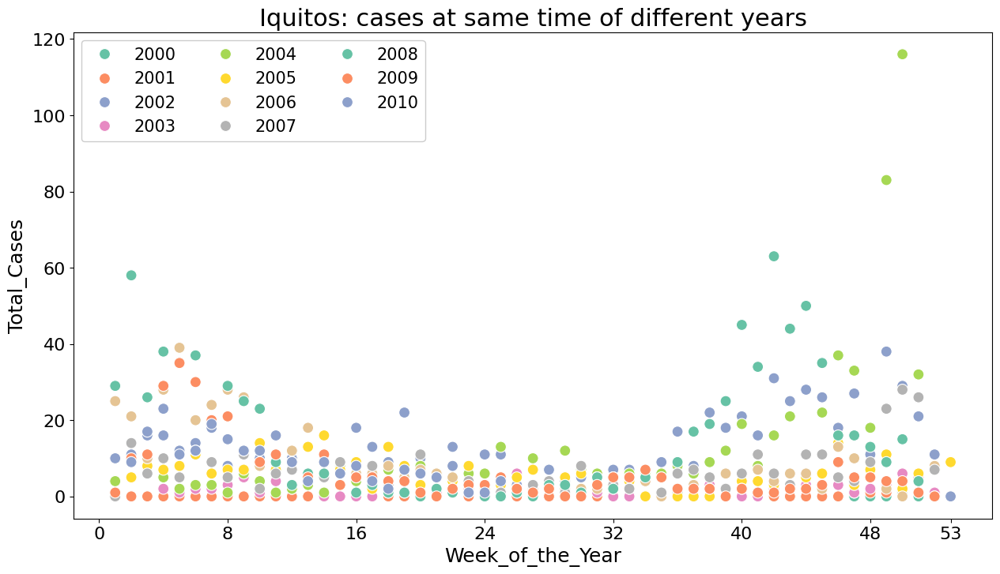

In [ ]:
plt.figure(figsize=[15,8])
plt.title('Iquitos: cases at same time of different years', size=22)
sns.scatterplot(x='weekofyear',y=iq_df_label['total_cases'], hue='year', s=100,
                data=iq_df_feature, palette='Set2',legend='full')
plt.legend(loc=2, framealpha=1, ncol=3, prop={'size': 15})
plt.ylabel('Total_Cases',size=18)
plt.xlabel('Week_of_the_Year',size=18)
plt.xticks([0,8,16,24,32,40,48,53], size=16)
plt.yticks(size=16)
plt.show()

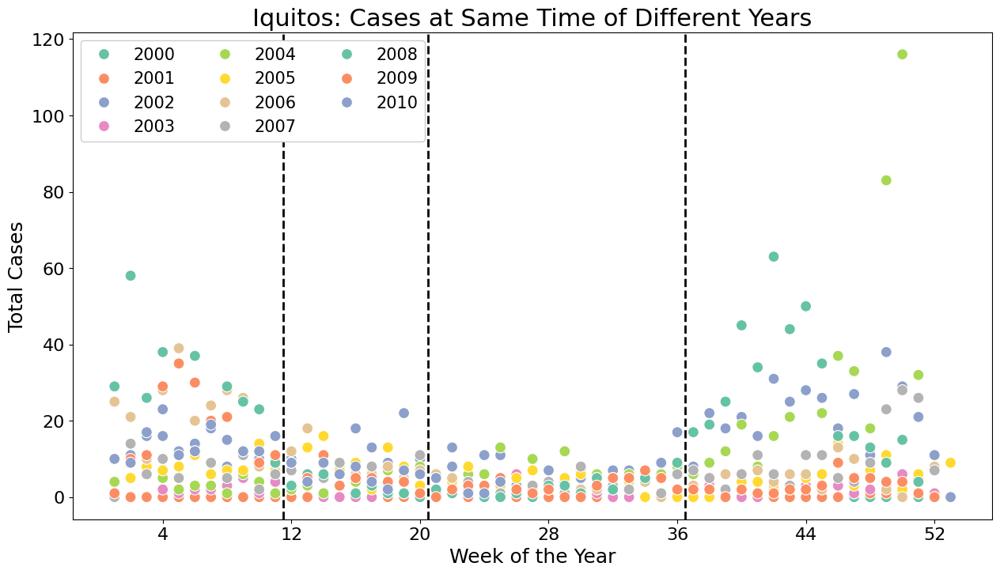

In [ ]:
plt.figure(figsize=[15,8])
plt.title('Iquitos: Cases at Same Time of Different Years', size=22)
sns.scatterplot(x='weekofyear', y=iq_df_label['total_cases'], hue='year', s=100,
                data=iq_df_feature, palette='Set2', legend='full')
plt.legend(loc=2, framealpha=1, ncol=3, prop={'size': 15})
plt.ylabel('Total Cases', size=18)
plt.xlabel('Week of the Year', size=18)
plt.xticks([4,12,20,28,36,44,52], size=16)
plt.yticks(size=16)

# Add dotted lines to distinguish different periods
plt.axvline(x=11.5, color='black', linestyle='--', lw=2)
plt.axvline(x=20.5, color='black', linestyle='--', lw=2)
plt.axvline(x=36.5, color='black', linestyle='--', lw=2)
plt.show()

In [ ]:
iq_df_all_RF = iq_df_all_DT.copy()

# cut the season
def assign_season(week):
    if 1 <= week < 11.5:
        return 'Sub-Peak'
    elif 11.5 <= week < 20.5:
        return 'Sub-Trough'
    elif 20.5 <= week < 36:
        return 'Trough'
    elif 36 <= week <= 52:
        return 'Peak'

if 'season' not in iq_df_all_RF.columns:
    iq_df_all_RF['season'] = iq_df_all_RF['weekofyear'].apply(assign_season)

    # one-hot Encode
    season_dummies = pd.get_dummies(iq_df_all_RF['season'], prefix='season')

    iq_df_all_RF = pd.concat([iq_df_all_RF, season_dummies], axis=1)

iq_df_all_RF


,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,year,weekofyear,total_cases,season,season_Peak,season_Sub-Peak,season_Sub-Trough,season_Trough
936,0.489655,92.418571,16.651429,43.19,2000,26,0,Trough,False,False,False,True
937,0.479777,93.581429,16.862857,46.00,2000,27,0,Trough,False,False,False,True
938,0.452593,95.848571,17.120000,64.77,2000,28,0,Trough,False,False,False,True
939,0.202175,87.234286,14.431429,23.96,2000,29,0,Trough,False,False,False,True
940,0.418374,88.161429,15.444286,31.80,2000,30,0,Trough,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...
1451,0.719307,88.765714,18.485714,45.00,2010,22,5,Trough,False,False,False,True
1452,0.595530,91.600000,18.070000,207.10,2010,23,8,Trough,False,False,False,True
1453,0.403419,94.280000,17.008571,50.60,2010,24,1,Trough,False,False,False,True
1454,0.420729,94.660000,16.815714,62.33,2010,25,1,Trough,False,False,False,True


#### 4.3.2:  For sj: (New Feature) Outbreak and low peak periods
For sj city, we determine   
week 1 to week 10 as sub-trough period  
week 11 to week 22 as trough period  
week 22 to week 30 as sub-peak period  
week after 30 as peak period

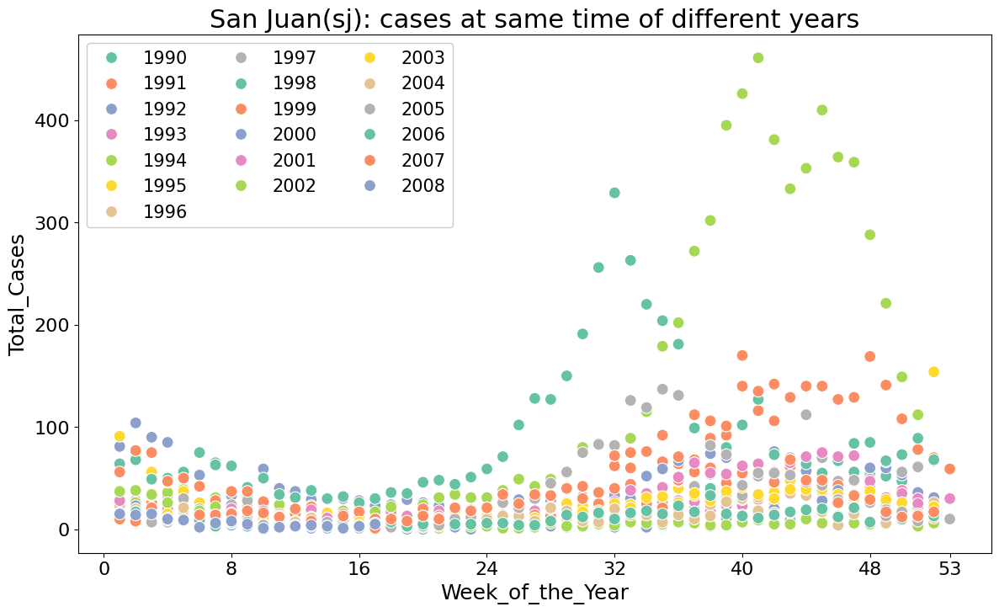

In [ ]:
plt.figure(figsize=[14,8])
plt.title('San Juan(sj): cases at same time of different years', size=22)
sns.scatterplot(x='weekofyear',y=sj_df_label['total_cases'], hue='year', s=100,
                data=sj_df_feature, palette='Set2',legend='full')
plt.legend(loc=2, framealpha=1, ncol=3, prop={'size': 15})
plt.ylabel('Total_Cases',size=18)
plt.xlabel('Week_of_the_Year',size=18)
plt.xticks([0,8,16,24,32,40,48,53], size=16)
plt.yticks(size=16)
plt.show()

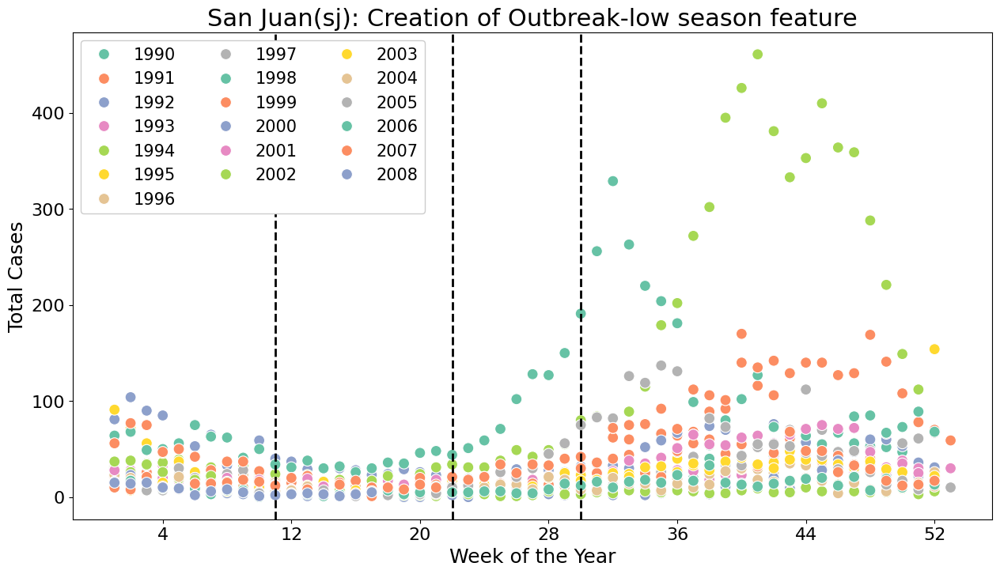

In [ ]:
plt.figure(figsize=[15,8])
plt.title('San Juan(sj): Creation of Outbreak-low season feature', size=22)
sns.scatterplot(x='weekofyear', y=sj_df_label['total_cases'], hue='year', s=100,
                data=sj_df_feature, palette='Set2', legend='full')
plt.legend(loc=2, framealpha=1, ncol=3, prop={'size': 15})
plt.ylabel('Total Cases', size=18)
plt.xlabel('Week of the Year', size=18)
plt.xticks([4,12,20,28,36,44,52], size=16)
plt.yticks(size=16)

# Add dotted lines to distinguish different periods
plt.axvline(x=11, color='black', linestyle='--', lw=2)
plt.axvline(x=22, color='black', linestyle='--', lw=2)
plt.axvline(x=30, color='black', linestyle='--', lw=2)
plt.show()

In [ ]:
sj_df_all_RF = sj_df_all_DT.copy()

# cut the season
def assign_season(week):
    if 1 <= week < 11:
        return 'Sub-Peak'
    elif 11 <= week < 22:
        return 'Sub-Trough'
    elif 22 <= week < 30:
        return 'Trough'
    elif 30 <= week <= 52:
        return 'Peak'

if 'season' not in sj_df_all_RF.columns:
    sj_df_all_RF['season'] = sj_df_all_RF['weekofyear'].apply(assign_season)

    # one-hot Encode
    season_dummies = pd.get_dummies(sj_df_all_RF['season'], prefix='season')

    sj_df_all_RF = pd.concat([sj_df_all_RF, season_dummies], axis=1)

sj_df_all_RF

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,year,weekofyear,total_cases,season,season_Peak,season_Sub-Peak,season_Sub-Trough,season_Trough
0,0.321873,73.365714,14.012857,32.00,1990,18,4,Sub-Trough,False,False,True,False
1,0.491912,77.368571,15.372857,17.94,1990,19,5,Sub-Trough,False,False,True,False
2,0.559386,82.052857,16.848571,26.10,1990,20,4,Sub-Trough,False,False,True,False
3,0.617544,80.337143,16.672857,13.90,1990,21,3,Sub-Trough,False,False,True,False
4,0.722110,80.460000,17.210000,12.20,1990,22,6,Trough,False,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...
931,0.280021,74.247143,13.644286,7.55,2008,13,4,Sub-Trough,False,False,True,False
932,0.430873,74.600000,14.662857,3.67,2008,14,3,Sub-Trough,False,False,True,False
933,0.330995,75.027143,14.184286,35.00,2008,15,1,Sub-Trough,False,False,True,False
934,0.344702,72.285714,13.858571,4.82,2008,16,3,Sub-Trough,False,False,True,False


#### 4.3.3: Create lag features  
For example, the spread of dengue fever relies on mosquitoes and other animals. Although these animals rely on water and temperature to reproduce, when the climate is suitable, they do not reproduce immediately, but need to wait for a period of time. This is why it is necessary to consider the **latency of climate data**

For sj

In [ ]:
sj_df_feature_RF_Lag = sj_df_all_RF.copy()

# List of features to create lag features
features_to_lag = ['general_temp', 'reanalysis_relative_humidity_percent',
                   'reanalysis_specific_humidity_g_per_kg', 'reanalysis_precip_amt_kg_per_m2']

for feature in features_to_lag:
    for lag in range(1, 4):
        sj_df_feature_RF_Lag[feature + '_lag' + str(lag)] = sj_df_all_RF[feature].shift(lag)

sj_df_feature_RF_Lag.dropna(inplace=True)

sj_df_feature_RF_Lag


,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,year,weekofyear,total_cases,season,season_Peak,season_Sub-Peak,...,general_temp_lag3,reanalysis_relative_humidity_percent_lag1,reanalysis_relative_humidity_percent_lag2,reanalysis_relative_humidity_percent_lag3,reanalysis_specific_humidity_g_per_kg_lag1,reanalysis_specific_humidity_g_per_kg_lag2,reanalysis_specific_humidity_g_per_kg_lag3,reanalysis_precip_amt_kg_per_m2_lag1,reanalysis_precip_amt_kg_per_m2_lag2,reanalysis_precip_amt_kg_per_m2_lag3
3,0.617544,80.337143,16.672857,13.90,1990,21,3,Sub-Trough,False,False,...,0.321873,82.052857,77.368571,73.365714,16.848571,15.372857,14.012857,26.10,17.94,32.00
4,0.722110,80.460000,17.210000,12.20,1990,22,6,Trough,False,False,...,0.491912,80.337143,82.052857,77.368571,16.672857,16.848571,15.372857,13.90,26.10,17.94
5,0.723995,79.891429,17.212857,26.49,1990,23,2,Trough,False,False,...,0.559386,80.460000,80.337143,82.052857,17.210000,16.672857,16.848571,12.20,13.90,26.10
6,0.623934,82.000000,17.234286,38.60,1990,24,4,Trough,False,False,...,0.617544,79.891429,80.460000,80.337143,17.212857,17.210000,16.672857,26.49,12.20,13.90
7,0.679099,83.375714,17.977143,30.00,1990,25,5,Trough,False,False,...,0.722110,82.000000,79.891429,80.460000,17.234286,17.212857,17.210000,38.60,26.49,12.20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
931,0.280021,74.247143,13.644286,7.55,2008,13,4,Sub-Trough,False,False,...,0.350247,72.915714,71.934286,74.681429,13.737143,13.721429,14.474286,0.90,9.38,6.50
932,0.430873,74.600000,14.662857,3.67,2008,14,3,Sub-Trough,False,False,...,0.340847,74.247143,72.915714,71.934286,13.644286,13.737143,13.721429,7.55,0.90,9.38
933,0.330995,75.027143,14.184286,35.00,2008,15,1,Sub-Trough,False,False,...,0.305683,74.600000,74.247143,72.915714,14.662857,13.644286,13.737143,3.67,7.55,0.90
934,0.344702,72.285714,13.858571,4.82,2008,16,3,Sub-Trough,False,False,...,0.280021,75.027143,74.600000,74.247143,14.184286,14.662857,13.644286,35.00,3.67,7.55


For iq

In [ ]:
iq_df_feature_RF_Lag = iq_df_all_RF.copy()

# List of features to create lag features
features_to_lag = ['general_temp', 'reanalysis_relative_humidity_percent',
                   'reanalysis_specific_humidity_g_per_kg', 'reanalysis_precip_amt_kg_per_m2']

for feature in features_to_lag:
    for lag in range(1, 4):
        iq_df_feature_RF_Lag[feature + '_lag' + str(lag)] = iq_df_all_RF[feature].shift(lag)

iq_df_feature_RF_Lag.dropna(inplace=True)

iq_df_feature_RF_Lag

,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,year,weekofyear,total_cases,season,season_Peak,season_Sub-Peak,...,general_temp_lag3,reanalysis_relative_humidity_percent_lag1,reanalysis_relative_humidity_percent_lag2,reanalysis_relative_humidity_percent_lag3,reanalysis_specific_humidity_g_per_kg_lag1,reanalysis_specific_humidity_g_per_kg_lag2,reanalysis_specific_humidity_g_per_kg_lag3,reanalysis_precip_amt_kg_per_m2_lag1,reanalysis_precip_amt_kg_per_m2_lag2,reanalysis_precip_amt_kg_per_m2_lag3
939,0.202175,87.234286,14.431429,23.96,2000,29,0,Trough,False,False,...,0.489655,95.848571,93.581429,92.418571,17.120000,16.862857,16.651429,64.77,46.00,43.19
940,0.418374,88.161429,15.444286,31.80,2000,30,0,Trough,False,False,...,0.479777,87.234286,95.848571,93.581429,14.431429,17.120000,16.862857,23.96,64.77,46.00
941,0.302501,74.728571,13.421429,1.00,2000,31,0,Trough,False,False,...,0.452593,88.161429,87.234286,95.848571,15.444286,14.431429,17.120000,31.80,23.96,64.77
942,0.500684,83.275714,15.311429,26.68,2000,32,0,Trough,False,False,...,0.202175,74.728571,88.161429,87.234286,13.421429,15.444286,14.431429,1.00,31.80,23.96
943,0.477448,82.490000,15.465714,16.90,2000,33,0,Trough,False,False,...,0.418374,83.275714,74.728571,88.161429,15.311429,13.421429,15.444286,26.68,1.00,31.80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1451,0.719307,88.765714,18.485714,45.00,2010,22,5,Trough,False,False,...,0.563996,78.998571,97.445714,96.712857,14.908571,18.391429,18.602857,8.80,87.30,85.46
1452,0.595530,91.600000,18.070000,207.10,2010,23,8,Trough,False,False,...,0.547535,88.765714,78.998571,97.445714,18.485714,14.908571,18.391429,45.00,8.80,87.30
1453,0.403419,94.280000,17.008571,50.60,2010,24,1,Trough,False,False,...,0.447999,91.600000,88.765714,78.998571,18.070000,18.485714,14.908571,207.10,45.00,8.80
1454,0.420729,94.660000,16.815714,62.33,2010,25,1,Trough,False,False,...,0.719307,94.280000,91.600000,88.765714,17.008571,18.070000,18.485714,50.60,207.10,45.00


#### Deal with test set

In [ ]:
features_to_fill = [
    'station_diur_temp_rng_c', 'station_avg_temp_c', 'station_precip_mm',
    'station_max_temp_c', 'station_min_temp_c', 'reanalysis_min_air_temp_k',
    'reanalysis_tdtr_k', 'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_sat_precip_amt_mm', 'reanalysis_relative_humidity_percent',
    'reanalysis_precip_amt_kg_per_m2', 'reanalysis_max_air_temp_k',
    'reanalysis_dew_point_temp_k', 'reanalysis_avg_temp_k',
    'reanalysis_air_temp_k', 'precipitation_amt_mm', 'ndvi_sw',
    'ndvi_se', 'ndvi_nw', 'ndvi_ne'
]

# Call functions
sj_df_test_yufeng = sj_test_df.copy()
sj_df_test_yufeng.sort_values(by='week_start_date', inplace=True)
fill_missing_values_with_interpolation(sj_df_test_yufeng, features_to_fill)

# Correct weekofyear in testset
years_to_adjust = [2010,2011, 2012]

sj_df_test_yufeng['weekofyear'] = np.where(sj_df_test_yufeng['year'].isin(years_to_adjust),
                                              sj_df_test_yufeng['weekofyear'] + 1, sj_df_test_yufeng['weekofyear'])

sj_df_test_yufeng['weekofyear'] = np.where(sj_df_test_yufeng['weekofyear'] > 52,
                                              1, sj_df_test_yufeng['weekofyear'])

# Generate general_temp for testset
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

for feature in temperature_features:
    min_value = sj_df_test_yufeng[feature].min()
    max_value = sj_df_test_yufeng[feature].max()
    sj_df_test_yufeng[feature] = (sj_df_test_yufeng[feature] - min_value) / (max_value - min_value)

sj_df_test_yufeng['general_temp'] = sj_df_test_yufeng[temperature_features].mean(axis=1)

# Selection
selected_features = [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2',
    'weekofyear',
    'year'
]

sj_df_test_yufeng_engineering = sj_df_test_yufeng[selected_features]

sj_df_test_RF_Lag = sj_df_test_yufeng_engineering.copy()

def assign_season(week):
    if 1 <= week < 11:
        return 'Sub-Peak'
    elif 11 <= week < 20:
        return 'Sub-Trough'
    elif 20 <= week < 36:
        return 'Trough'
    elif 36 <= week <= 52:
        return 'Peak'

if 'season' not in sj_df_test_RF_Lag.columns:
    sj_df_test_RF_Lag['season'] = sj_df_test_RF_Lag['weekofyear'].apply(assign_season)
    season_dummies = pd.get_dummies(sj_df_test_RF_Lag['season'], prefix='season')
    sj_df_test_RF_Lag = pd.concat([sj_df_test_RF_Lag, season_dummies], axis=1)


features_to_lag = ['general_temp', 'reanalysis_relative_humidity_percent',
                   'reanalysis_specific_humidity_g_per_kg', 'reanalysis_precip_amt_kg_per_m2']

for feature in features_to_lag:
    for lag in range(1, 4):
        feature_name = feature + '_lag' + str(lag)
        sj_df_test_RF_Lag[feature_name] = sj_df_test_RF_Lag[feature].shift(lag)
        sj_df_test_RF_Lag[feature_name].fillna(method='bfill', inplace=True)
sj_df_test_RF_Lag.head()


,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,weekofyear,year,season,season_Peak,season_Sub-Peak,season_Sub-Trough,...,general_temp_lag3,reanalysis_relative_humidity_percent_lag1,reanalysis_relative_humidity_percent_lag2,reanalysis_relative_humidity_percent_lag3,reanalysis_specific_humidity_g_per_kg_lag1,reanalysis_specific_humidity_g_per_kg_lag2,reanalysis_specific_humidity_g_per_kg_lag3,reanalysis_precip_amt_kg_per_m2_lag1,reanalysis_precip_amt_kg_per_m2_lag2,reanalysis_precip_amt_kg_per_m2_lag3
0,0.454579,78.781429,15.918571,25.37,18,2008,Sub-Trough,False,False,True,...,0.454579,78.781429,78.781429,78.781429,15.918571,15.918571,15.918571,25.37,25.37,25.37
1,0.399068,78.230000,15.791429,21.83,19,2008,Sub-Trough,False,False,True,...,0.454579,78.781429,78.781429,78.781429,15.918571,15.918571,15.918571,25.37,25.37,25.37
2,0.579045,78.270000,16.674286,4.12,20,2008,Trough,False,False,False,...,0.454579,78.230000,78.781429,78.781429,15.791429,15.918571,15.918571,21.83,25.37,25.37
3,0.646655,73.015714,15.775714,2.20,21,2008,Trough,False,False,False,...,0.454579,78.270000,78.230000,78.781429,16.674286,15.791429,15.918571,4.12,21.83,25.37
4,0.617936,74.084286,16.137143,4.36,22,2008,Trough,False,False,False,...,0.399068,73.015714,78.270000,78.230000,15.775714,16.674286,15.791429,2.20,4.12,21.83


In [ ]:
features_to_fill = [
    'station_diur_temp_rng_c', 'station_avg_temp_c', 'station_precip_mm',
    'station_max_temp_c', 'station_min_temp_c', 'reanalysis_min_air_temp_k',
    'reanalysis_tdtr_k', 'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_sat_precip_amt_mm', 'reanalysis_relative_humidity_percent',
    'reanalysis_precip_amt_kg_per_m2', 'reanalysis_max_air_temp_k',
    'reanalysis_dew_point_temp_k', 'reanalysis_avg_temp_k',
    'reanalysis_air_temp_k', 'precipitation_amt_mm', 'ndvi_sw',
    'ndvi_se', 'ndvi_nw', 'ndvi_ne'
]

# Call functions
iq_df_test_yufeng = iq_test_df.copy()
iq_df_test_yufeng.sort_values(by='week_start_date', inplace=True)
fill_missing_values_with_interpolation(iq_df_test_yufeng, features_to_fill)

# Correct weekofyear in testset
years_to_adjust = [2011, 2012]

iq_df_test_yufeng['weekofyear'] = np.where(iq_df_test_yufeng['year'].isin(years_to_adjust),
                                              iq_df_test_yufeng['weekofyear'] + 1, iq_df_test_yufeng['weekofyear'])

iq_df_test_yufeng['weekofyear'] = np.where(iq_df_test_yufeng['weekofyear'] > 52,
                                              1, iq_df_test_yufeng['weekofyear'])

# Generate general_temp for testset
temperature_features = [
    'reanalysis_max_air_temp_k', 'station_avg_temp_c',
    'reanalysis_avg_temp_k', 'reanalysis_min_air_temp_k',
    'station_min_temp_c', 'reanalysis_dew_point_temp_k',
    'reanalysis_air_temp_k', 'station_max_temp_c'
]

for feature in temperature_features:
    min_value = iq_df_test_yufeng[feature].min()
    max_value = iq_df_test_yufeng[feature].max()
    iq_df_test_yufeng[feature] = (iq_df_test_yufeng[feature] - min_value) / (max_value - min_value)

iq_df_test_yufeng['general_temp'] = iq_df_test_yufeng[temperature_features].mean(axis=1)

# Selection
selected_features = [
    'general_temp',
    'reanalysis_relative_humidity_percent',
    'reanalysis_specific_humidity_g_per_kg',
    'reanalysis_precip_amt_kg_per_m2',
    'weekofyear',
    'year'
]

iq_df_test_yufeng_engineering = iq_df_test_yufeng[selected_features]

iq_df_test_RF_Lag = iq_df_test_yufeng_engineering.copy()

def assign_season(week):
    if 1 <= week < 11:
        return 'Sub-Peak'
    elif 11 <= week < 20:
        return 'Sub-Trough'
    elif 20 <= week < 36:
        return 'Trough'
    elif 36 <= week <= 52:
        return 'Peak'

if 'season' not in iq_df_test_RF_Lag.columns:
    iq_df_test_RF_Lag['season'] = iq_df_test_RF_Lag['weekofyear'].apply(assign_season)
    season_dummies = pd.get_dummies(iq_df_test_RF_Lag['season'], prefix='season')
    iq_df_test_RF_Lag = pd.concat([iq_df_test_RF_Lag, season_dummies], axis=1)


features_to_lag = ['general_temp', 'reanalysis_relative_humidity_percent',
                   'reanalysis_specific_humidity_g_per_kg', 'reanalysis_precip_amt_kg_per_m2']

for feature in features_to_lag:
    for lag in range(1, 4):
        feature_name = feature + '_lag' + str(lag)
        iq_df_test_RF_Lag[feature_name] = iq_df_test_RF_Lag[feature].shift(lag)
        iq_df_test_RF_Lag[feature_name].fillna(method='bfill', inplace=True)
iq_df_test_RF_Lag.head()


,general_temp,reanalysis_relative_humidity_percent,reanalysis_specific_humidity_g_per_kg,reanalysis_precip_amt_kg_per_m2,weekofyear,year,season,season_Peak,season_Sub-Peak,season_Sub-Trough,...,general_temp_lag3,reanalysis_relative_humidity_percent_lag1,reanalysis_relative_humidity_percent_lag2,reanalysis_relative_humidity_percent_lag3,reanalysis_specific_humidity_g_per_kg_lag1,reanalysis_specific_humidity_g_per_kg_lag2,reanalysis_specific_humidity_g_per_kg_lag3,reanalysis_precip_amt_kg_per_m2_lag1,reanalysis_precip_amt_kg_per_m2_lag2,reanalysis_precip_amt_kg_per_m2_lag3
260,0.592870,92.581429,17.654286,34.11,26,2010,Trough,False,False,False,...,0.592870,92.581429,92.581429,92.581429,17.654286,17.654286,17.654286,34.11,34.11,34.11
261,0.529645,83.885714,16.320000,9.10,27,2010,Trough,False,False,False,...,0.592870,92.581429,92.581429,92.581429,17.654286,17.654286,17.654286,34.11,34.11,34.11
262,0.550218,92.057143,18.030000,61.09,28,2010,Trough,False,False,False,...,0.592870,83.885714,92.581429,92.581429,16.320000,17.654286,17.654286,9.10,34.11,34.11
263,0.269779,88.970000,15.394286,19.60,29,2010,Trough,False,False,False,...,0.592870,92.057143,83.885714,92.581429,18.030000,16.320000,17.654286,61.09,9.10,34.11
264,0.453158,78.610000,15.468571,18.93,30,2010,Trough,False,False,False,...,0.529645,88.970000,92.057143,83.885714,15.394286,18.030000,16.320000,19.60,61.09,9.10


#### Output the test and Train data

In [ ]:
iq_df_feature_RF_Lag.to_csv('iq_df_feature_RF_Lag.csv', index=False)
sj_df_feature_RF_Lag.to_csv('sj_df_feature_RF_Lag.csv', index=False)
iq_df_test_RF_Lag.to_csv('iq_df_test_RF_Lag.csv', index=False)
sj_df_test_RF_Lag.to_csv('sj_df_test_RF_Lag.csv', index=False)

In [ ]:
iq_RF_feature = iq_df_feature_RF_Lag.drop(columns=['total_cases','season'])
iq_RF_label = iq_df_feature_RF_Lag['total_cases']
sj_RF_feature = sj_df_feature_RF_Lag.drop(columns=['total_cases','season'])
sj_RF_label = sj_df_feature_RF_Lag['total_cases']

# For test set
iq_RF_test_yufeng = iq_df_test_RF_Lag.drop(columns=['season'])
sj_RF_test_yufeng = sj_df_test_RF_Lag.drop(columns=['season'])

#### 4.3.4: Limits of decision trees  
#### Train Random Forest
From previous attempts to visualize decision trees, we know that the depth and size of the decision tree at this time are already very complex, and it is unwise to use the decision tree at this time.  
I decided to use a more complex **Random Forest** regression model to fit the data

## 5.Conclusion
**Random forest with 3-weeks lag features and Seasonal period features![图像.png](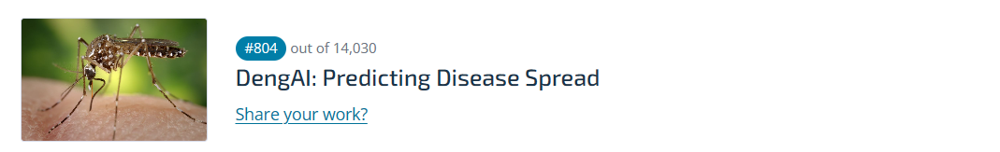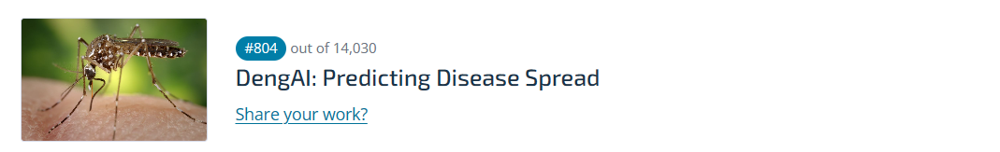)**  
Got 24.1 Mae in the competition ranked #804 out of 14030

### Train the RF model

In [ ]:
# iq_features = iq_yufeng_train.drop(['total_cases'], axis=1)
# iq_labels = iq_yufeng_train.total_cases
# sj_features = sj_yufeng_train.drop(['total_cases'], axis=1)
# sj_labels = sj_yufeng_train.total_cases

In [ ]:
# # The training need about 30 minutes
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import RandomizedSearchCV
# from scipy.stats import randint
# import time

# # search space for param_distributions
# param_distributions = {
#     'max_depth': randint(5, 100),
#     'max_features': ['sqrt', 'log2', 'auto', 2, 5],
#     'min_samples_leaf': randint(1, 5),
#     'min_samples_split': randint(2, 5),
#     'n_estimators': randint(100, 300)
# }

# # Create a random forest regressor instance
# rfr = RandomForestRegressor(criterion='absolute_error')

# # Create RandomizedSearchCV instance
# # K-Fold, K = 5
# rs = RandomizedSearchCV(estimator=rfr, param_distributions=param_distributions,
#                         n_iter=3000, cv=5, n_jobs=-1, random_state=42)

# start = time.time()

# rs.fit(sj_features, sj_labels)

# print(time.time() - start)

# sj_rf_params = rs.best_params_
# sj_rf_params


Here I directly provide the parameter results for my training

In [ ]:
sj_rf_params = {'max_depth': 21,
 'max_features': 2,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 145}

In [ ]:
# # The training need about 30 minutes
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import RandomizedSearchCV
# from scipy.stats import randint
# import time

# # search space for param_distributions
# param_distributions = {
#     'max_depth': randint(5, 100),
#     'max_features': ['sqrt', 'log2', 'auto', 2, 5],
#     'min_samples_leaf': randint(1, 5),
#     'min_samples_split': randint(2, 5),
#     'n_estimators': randint(100, 300)
# }

# # Create a random forest regressor instance
# rfr = RandomForestRegressor(criterion='absolute_error')

# # Create RandomizedSearchCV instance
# # K-Fold, K = 5
# rs = RandomizedSearchCV(estimator=rfr, param_distributions=param_distributions,
#                         n_iter=3000, cv=5, n_jobs=-1, random_state=42)

# start = time.time()

# rs.fit(iq_features, iq_labels)

# print(time.time() - start)

# iq_rf_params = rs.best_params_
# iq_rf_params


Here I directly provide the parameter results for my training

In [ ]:
iq_rf_params = {'max_depth': 20,
 'max_features': 2,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 100}

In [ ]:
from sklearn.ensemble import RandomForestRegressor
sj_rfr = RandomForestRegressor(**sj_rf_params, criterion='absolute_error')
iq_rfr = RandomForestRegressor(**iq_rf_params, criterion='absolute_error')

sj_rfr.fit(sj_RF_feature, sj_RF_label)
iq_rfr.fit(iq_RF_feature, iq_RF_label)


RandomForestRegressor(criterion='absolute_error', max_depth=20, max_features=2,
                      min_samples_leaf=2)

### Submission

In [ ]:
train_columns = iq_rfr.feature_names_in_

test_columns = iq_RF_test_yufeng.columns

missing_columns = set(train_columns) - set(test_columns)

extra_columns = set(test_columns) - set(train_columns)

print("if any missing?:", missing_columns)
print("if any extra?:", extra_columns)
if not missing_columns and not extra_columns:
    iq_RF_test_yufeng = iq_RF_test_yufeng[train_columns]
    print("Data all prepared")

if any missing?: set()
if any extra?: set()
Data all prepared


In [ ]:
train_columns = sj_rfr.feature_names_in_

test_columns = sj_RF_test_yufeng.columns

missing_columns = set(train_columns) - set(test_columns)

extra_columns = set(test_columns) - set(train_columns)

print("if any missing?:", missing_columns)
print("if any extra?:", extra_columns)
if not missing_columns and not extra_columns:
    sj_RF_test_yufeng = sj_RF_test_yufeng[train_columns]
    print("All Done")

if any missing?: set()
if any extra?: set()
All Done


In [ ]:
submission_format = pd.read_csv('/content/submission_format.csv')
# Make Prediction
sj_pred = sj_rfr.predict(sj_RF_test_yufeng).astype(int)
iq_pred = iq_rfr.predict(iq_RF_test_yufeng).astype(int)
final_pred_yufeng = np.concatenate([sj_pred, iq_pred])
submission_format.total_cases = final_pred_yufeng
submission_format.to_csv("RF_withlag_yufeng.csv",index=False)

======================================================================================================================================================================================================================================

## 2.Data Pre-processing Method:

### The Data Pre-processing Method is feature selection.

### Feature Selection checks the correlationship of Features in the given dataframe, and decide whether a feature is reserved based on its correlation parameter with other features.

### To ensure the authenticity of correlation parameter, Feature Selection drops all the rows with missing values before the feature selection, but will not give these rows up completely. After selecting features, Feature Selection will return to the raw dataframe and generate a new dataframe with selected features. Missing values in this new dataframe will be filled with the medium of columns they belong to.

### The hyper-parameter in feature selection is the level of correlationship, which split features into groups that all features inside are correlated.Only one feature is selected in a group. To regulate the value of hyper-parameter, Linear Regression is introduced to judge its performance. Linear Regression is a simple model, so if the hyper-parameter works well in Linear Regression, it has a higher possibility to work better than others hyper-parameters in other models.

### 2.1 Import essential extensions.

In [ ]:
!pip install q keras==3.1.1

Traceback (most recent call last):
  File "/usr/local/bin/pip3", line 8, in <module>
    sys.exit(main())
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/cli/main.py", line 77, in main
    command = create_command(cmd_name, isolated=("--isolated" in cmd_args))
  File "/usr/local/lib/python3.10/dist-packages/pip/_internal/commands/__init__.py", line 114, in create_command
    module = importlib.import_module(module_path)
  File "/usr/lib/python3.10/importlib/__init__.py", line 126, in import_module
    return _bootstrap._gcd_import(name[level:], package, level)
  File "<frozen importlib._bootstrap>", line 1050, in _gcd_import
  File "<frozen importlib._bootstrap>", line 1027, in _find_and_load
  File "<frozen importlib._bootstrap>", line 1006, in _find_and_load_unlocked
  File "<frozen importlib._bootstrap>", line 688, in _load_unlocked
  File "<frozen importlib._bootstrap_external>", line 883, in exec_module
  File "<frozen importlib._bootstrap>", line 241, in _call_with_

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime
from sklearn.preprocessing import LabelEncoder
from sklearn.utils import shuffle
from keras.models import load_model
from sklearn.preprocessing import MinMaxScaler
import keras
from keras.models import Sequential
from keras.layers import LSTM, Dropout, Dense
import tensorflow.compat.v2 as tf
import seaborn as sns
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.model_selection import train_test_split, cross_val_predict, cross_val_score
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import cross_val_score
import tensorflow as tf0
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
tf.enable_v2_behavior()
import heapq

In [ ]:
#load data
training_features_csv = 'https://raw.githubusercontent.com/conditg/deng-ai/master/data/dengue_features_train.csv'
training_labels_csv = 'https://raw.githubusercontent.com/conditg/deng-ai/master/data/dengue_labels_train.csv'
test_features_csv = 'https://raw.githubusercontent.com/conditg/deng-ai/master/data/dengue_features_test.csv'
submission_csv = 'https://raw.githubusercontent.com/conditg/deng-ai/master/data/submission_format.csv'
df_l = pd.read_csv(training_features_csv)
lb_l = pd.read_csv(training_labels_csv)
df2_l = pd.read_csv(test_features_csv)

### 2.2 Drop missing values

In [ ]:
#Missing values will be covered by medium after the selection.
df_clean_l = df_l.dropna()
#Remove values that are not suitable for calculating correaltion parameters.
df_clean_l = df_clean_l.drop('city',axis=1)
df_clean_l = df_clean_l.drop('year',axis=1)
df_clean_l = df_clean_l.drop('weekofyear',axis=1)
df_clean_l = df_clean_l.drop('week_start_date',axis=1)

### 2.3 Calculate correlation parameters

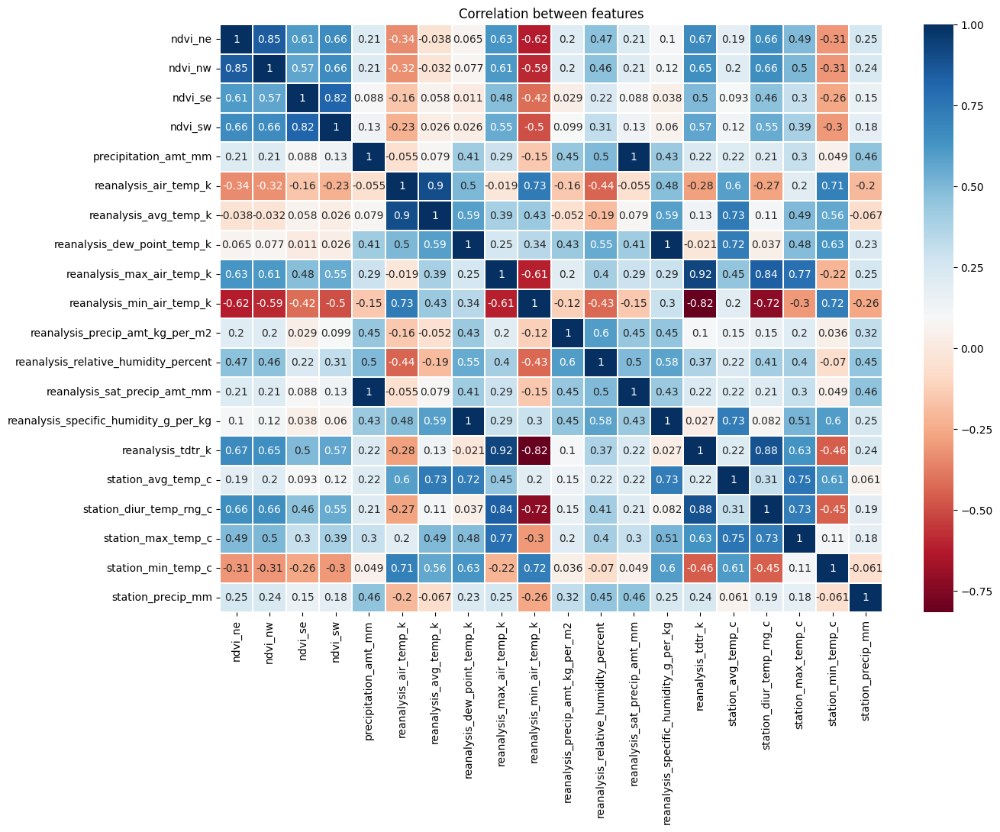

In [ ]:
corr_l = df_clean_l.corr()
#Draw a heat map to visualize the result.
f, ax= plt.subplots(figsize = (14, 10))
sns.heatmap(corr_l,cmap='RdBu', linewidths = 0.05, ax = ax,annot = True)
ax.set_title('Correlation between features')
plt.show()
plt.close()
f.savefig('sns_style_origin.jpg', dpi=100, bbox_inches='tight')

### 2.4 Provide a hyper-parameter which decides whether two columns of data are related

In [ ]:
hyper_l = 0.75
# The value of hyper_l is related to the number of features reserved, which is 10 and has the best performance in the evaluating model: Linear Regression.
# The detailed procession is shown in step 7.
corr0_l = corr_l

### 2.5 Select features based on the hyper-parameter

In [ ]:
def generate_pairs(corr,hyper):
    nega_hyper = -hyper
    Relation = []
    relation = []
    corr_col = [column for column in corr]
    #If the correlation parameter is bigger than the hyper-parameter, it is considered as related.
    #A list called pair is set to show pairs of columns that are related.
    #Record the related pairs of columns as pairs of numbers in pair.
    for j in range(len(corr_col)):
        for i in range(len(corr0_l[corr_col[j]])):
            if (corr0_l[corr_col[j]][i] >= hyper or corr0_l[corr_col[j]][i]<= nega_hyper):
                relation.append(1)
            else:
                relation.append(0)
        Relation.append(relation)
        relation = []
    pair = []
    for i in range(len(Relation)):
        for j in range(len(Relation)):
            if (i < j and Relation[i][j] == 1):
                pair.append((i,j))
    return pair


#Classify pairs into 2 types:
#1.pairs that do not share the same numbers with other pairs
#2.pairs that share the same numbers with other pairs
def classify_lists(lists):
    unique_lists = []
    repeated_lists = []

    for lst in lists:
        is_repeated = False
        for other_lst in lists:
            if lst != other_lst and any(x in other_lst for x in lst):
                is_repeated = True
                break
        if is_repeated:
            repeated_lists.append(lst)
        else:
            unique_lists.append(lst)

    return unique_lists, repeated_lists


#Merge type2 pairs into groups that do not share the same numbers with other pairs.
def merge_repeated_lists(repeated_lists):
    merged_list = []

    while repeated_lists:
        current_list = repeated_lists.pop(0)
        for other_list in repeated_lists[:]:
            common_elements = set(current_list).intersection(other_list)
            if common_elements:
                current_list += tuple(x for x in other_list if x not in current_list)
                repeated_lists.remove(other_list)
        merged_list.append(sorted(set(current_list)))
    while True:
        merged = False
        for i in range(len(merged_list)):
            for j in range(i+1, len(merged_list)):
                common_elements = set(merged_list[i]).intersection(merged_list[j])
                if common_elements:
                    merged_list[i] += tuple(x for x in merged_list[j] if x not in merged_list[i])
                    merged_list[j] = []
                    merged = True
        merged_list = [sublist for sublist in merged_list if sublist]
        if not merged:
            break

    return merged_list

def generate_combinations(lists):
    if not lists:
        return []

    def backtrack(curr_combination, index):
        if len(curr_combination) == len(lists):
            combinations.append(curr_combination[:])
            return
        for num in lists[index]:
            if num not in curr_combination:
                curr_combination.append(num)
                backtrack(curr_combination, index + 1)
                curr_combination.pop()

    combinations = []
    backtrack([], 0)
    return combinations

pair_l = generate_pairs(corr0_l,hyper_l)
unique_lists_l, repeated_lists_l = classify_lists(pair_l)
merged_list_l = merge_repeated_lists(repeated_lists_l)
#Merge type1 pair and type2 group into a new lists called group.
group_l = merged_list_l+unique_lists_l
#Only one of the columns is reserved in each group and others will be dropped.
#Delete_l is the list that contains number of columns that are dropped.
checklist_l = generate_combinations(group_l)
delete_group_l = []
delete_l = []
#Delete_group_l is a list that holds all possible delete_ls.
#Saving delete_ls in delete_group_l is to find the best solution in next step.
for h in range(len(checklist_l)):
    delete_l = []
    for i in range(len(group_l)):
        for j in range(len(group_l[i])):
            if (group_l[i][j] in checklist_l[h])==False:
                delete_l.append(group_l[i][j])
    delete_l.sort()
    delete_group_l.append(delete_l)

### 2.6 Decide selected features
#### After list delete_l is produced, it is time to select a combination
#### in in delete_group_l that can perform  best in Linear Regression.

In [ ]:
# performances_mean_l = []
# performances_std_l = []
# for delete in delete_group_l:
# #Remove columns in df_clean based on the delete list to get df_clean_del.
#     cols_to_drop_l = delete
#     df_clean_del_l = df_clean_l
#     df_clean_del_l = df_clean_del_l.drop(df_clean_del_l.columns[cols_to_drop_l], axis=1)
#     columns_to_select_l = df_clean_del_l.columns
#     selected_columns_df_l = df_l[columns_to_select_l]
#     selected_columns_df2_l = df2_l[columns_to_select_l]
#     median_values_l = selected_columns_df_l.median()
#     median_values2_l = selected_columns_df2_l.median()
#     df_filled_l = selected_columns_df_l.fillna(median_values_l)
#     df_filled2_l = selected_columns_df2_l.fillna(median_values2_l)
#     # Get X and y from given dataframe.
#     X_l = df_filled_l
#     y_l = lb_l['total_cases']

#     # Split proportion: 80% training / 20% testing
#     X_train_l, X_test_l, y_train_l, y_test_l = train_test_split(X_l, y_l, test_size=0.2, random_state=42)
#     X_train_l
#     # Call MinMaxScaler
#     scaler_l = MinMaxScaler()

#     # Normalization
#     result_df_scaled_l = pd.DataFrame(scaler_l.fit_transform(X_train_l), columns=X_train_l.columns)

#     X_train_l = result_df_scaled_l
#     # Important: ONLY X_train is eligible to be normalized.
#     X_train_l

#     # Evaluating
#     model_l = LinearRegression()

#     # 100-fold cross validation is applied.
#     scores_l = cross_val_score(model_l, X_l, y_l, cv=100, scoring='neg_mean_absolute_error')

#     performances_mean_l.append(scores_l.mean())
#     performances_std_l.append(scores_l.std())

In [ ]:
# max_number_l = heapq.nlargest(5, performances_mean_l)
# max_index_l = map(performances_mean_l.index, heapq.nlargest(5, performances_mean_l))
# print(max_number_l)
# print(set(max_index_l))

#### Based on the result from delete_group_l, the best combination is delete_group_l[66], which is:

In [ ]:
print(delete_group_l[66])

[1, 3, 5, 8, 9, 12, 13, 15, 16, 17]


#### Numbers in the list stand for the n-th feature in the raw dataframe.

In [ ]:
#Remove columns in df_clean based on the delete list to get df_clean_del.
delete_l = delete_group_l[66]
cols_to_drop_l = delete_l
df_clean_del_l = df_clean_l
df_clean_del_l = df_clean_del_l.drop(df_clean_del_l.columns[cols_to_drop_l], axis=1)
df_clean_del_l

,ndvi_ne,ndvi_se,precipitation_amt_mm,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_tdtr_k,station_min_temp_c,station_precip_mm
0,0.122600,0.198483,12.42,297.742857,292.414286,32.00,73.365714,2.628571,20.0,16.0
1,0.169900,0.162357,22.82,298.442857,293.951429,17.94,77.368571,2.371429,22.2,8.6
2,0.032250,0.157200,34.54,298.878571,295.434286,26.10,82.052857,2.300000,22.8,41.4
3,0.128633,0.227557,15.36,299.228571,295.310000,13.90,80.337143,2.428571,23.3,4.0
4,0.196200,0.251200,7.52,299.664286,295.821429,12.20,80.460000,3.014286,23.9,5.8
...,...,...,...,...,...,...,...,...,...,...
1451,0.342750,0.256343,55.30,300.771429,296.825714,45.00,88.765714,9.800000,22.4,27.0
1452,0.160157,0.136043,86.47,299.392857,296.452857,207.10,91.600000,7.471429,21.7,36.6
1453,0.247057,0.250357,58.94,297.592857,295.501429,50.60,94.280000,7.500000,19.2,7.4
1454,0.333914,0.278886,59.67,297.521429,295.324286,62.33,94.660000,7.871429,21.0,16.0


### 2.7 Recover and deal with the missing values.

In [ ]:
#Cut columns from df based on df_clean_del so that missing values can be recovered.
#Then replace the missing value with median.(or other possible values like average or mode)
columns_to_select_l = df_clean_del_l.columns
selected_columns_df_l = df_l[columns_to_select_l]
selected_columns_df2_l = df2_l[columns_to_select_l]
median_values_l = selected_columns_df_l.median()
median_values2_l = selected_columns_df2_l.median()
df_filled_l = selected_columns_df_l.fillna(median_values_l)
df_filled2_l = selected_columns_df2_l.fillna(median_values2_l)
df_filled_l

,ndvi_ne,ndvi_se,precipitation_amt_mm,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_tdtr_k,station_min_temp_c,station_precip_mm
0,0.122600,0.198483,12.42,297.742857,292.414286,32.00,73.365714,2.628571,20.0,16.0
1,0.169900,0.162357,22.82,298.442857,293.951429,17.94,77.368571,2.371429,22.2,8.6
2,0.032250,0.157200,34.54,298.878571,295.434286,26.10,82.052857,2.300000,22.8,41.4
3,0.128633,0.227557,15.36,299.228571,295.310000,13.90,80.337143,2.428571,23.3,4.0
4,0.196200,0.251200,7.52,299.664286,295.821429,12.20,80.460000,3.014286,23.9,5.8
...,...,...,...,...,...,...,...,...,...,...
1451,0.342750,0.256343,55.30,300.771429,296.825714,45.00,88.765714,9.800000,22.4,27.0
1452,0.160157,0.136043,86.47,299.392857,296.452857,207.10,91.600000,7.471429,21.7,36.6
1453,0.247057,0.250357,58.94,297.592857,295.501429,50.60,94.280000,7.500000,19.2,7.4
1454,0.333914,0.278886,59.67,297.521429,295.324286,62.33,94.660000,7.871429,21.0,16.0


### 2.8 Split train set and evaluate the performance of hyper-parameter

In [ ]:
# Use Linear Regression as an evaluator of the performance of hyper-parameter.
# Split training set to generate training set and testing set for
# To avoid overfitting and coincidence, 100-fold cross validation is introduced with LR to check the performance.
X_l = df_filled_l
y_l = lb_l['total_cases']
# The proportion of splitting: 80%training, 20%testing.
X_train_l, X_test_l, y_train_l, y_test_l = train_test_split(X_l, y_l, test_size=0.2, random_state=42)
X_train_l

,ndvi_ne,ndvi_se,precipitation_amt_mm,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_tdtr_k,station_min_temp_c,station_precip_mm
254,0.073900,0.145200,19.43,297.085714,292.821429,18.60,77.020000,2.057143,21.1,16.5
1063,0.268029,0.288671,35.02,298.950000,296.390000,30.89,92.614286,7.928571,22.9,57.2
636,-0.070450,0.219286,1.07,300.678571,295.912857,7.09,75.867143,2.614286,23.3,16.3
1289,0.143086,0.168457,93.62,298.092857,296.014286,46.45,94.721429,7.528571,22.1,97.1
514,0.231100,0.159100,25.96,296.450000,290.998571,3.29,72.142857,2.357143,21.1,0.8
...,...,...,...,...,...,...,...,...,...,...
1095,0.285814,0.288029,2.64,298.042857,291.850000,6.39,77.804286,11.428571,18.0,9.9
1130,0.306283,0.029880,120.10,298.200000,296.607143,76.20,96.238571,5.714286,23.6,142.6
1294,0.364614,0.329900,64.11,298.707143,296.168571,65.60,94.852857,8.957143,21.7,86.6
860,-0.276100,0.215317,6.61,300.992857,296.164286,8.20,75.568571,2.585714,24.4,18.0


In [ ]:
#Introduce MinMaxScaler to regularize X_train.
scaler_l = MinMaxScaler()
result_df_scaled_l = pd.DataFrame(scaler_l.fit_transform(X_train_l), columns=X_train_l.columns)

In [ ]:
X_train_l = result_df_scaled_l
#ONLY Xtrain can be regularized.
X_train_l

,ndvi_ne,ndvi_se,precipitation_amt_mm,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_tdtr_k,station_min_temp_c,station_precip_mm
0,0.524980,0.261245,0.049872,0.272889,0.360908,0.051377,0.471130,0.047712,0.587156,0.047022
1,0.737233,0.530862,0.089887,0.504889,0.766099,0.085324,0.853128,0.447907,0.752294,0.163009
2,0.367152,0.400470,0.002746,0.720000,0.711922,0.019584,0.442889,0.085686,0.788991,0.046452
3,0.600625,0.304951,0.240298,0.398222,0.723439,0.128304,0.904745,0.420643,0.678899,0.276717
4,0.696857,0.287367,0.066632,0.193778,0.153933,0.009088,0.351659,0.068160,0.587156,0.002280
...,...,...,...,...,...,...,...,...,...,...
1159,0.756679,0.529654,0.006776,0.392000,0.250608,0.017650,0.490342,0.686465,0.302752,0.028213
1160,0.779059,0.044532,0.308265,0.411556,0.790754,0.210480,0.941909,0.296981,0.816514,0.406384
1161,0.842837,0.608340,0.164553,0.474667,0.740957,0.181200,0.907965,0.518014,0.642202,0.246794
1162,0.142302,0.393011,0.016966,0.759111,0.740470,0.022650,0.435575,0.083739,0.889908,0.051297


In [ ]:
model_l = LinearRegression()
scores_l = cross_val_score(model_l, X_l, y_l, cv=100, scoring='neg_mean_absolute_error')

# get the detailed parameter of every hyper-parameter
print("Score of each fold:", scores_l)
print("Average:", scores_l.mean())
print("SE：",scores_l.std())

Score of each fold: [ -31.47420733  -15.03042453   -9.25870204  -14.21864333  -30.78757599
  -87.10916386  -19.41921455  -11.83770682  -19.28446796  -10.44721447
  -19.81962673  -20.4686275    -7.33046461   -7.18725776  -17.45366865
 -289.73977601  -50.97863566  -22.85352005  -22.36570741   -7.82431609
  -14.44898457  -28.08760192   -9.46217475   -6.70773419  -23.25695482
  -19.43303327  -27.94433494  -11.84902962 -119.39980316  -40.22211425
  -24.51130129  -24.02040095  -10.83819344   -7.94226459  -20.57862775
  -38.92105942  -22.55298825  -12.60431403  -25.89692421  -17.57835592
  -10.77558478  -22.36896325  -39.63473653  -31.78937144  -19.84530088
  -24.7414421   -10.86643663   -6.63284322  -21.29050676  -30.60784222
  -21.53543316  -14.13460914  -27.11840073  -38.54232643  -12.26378515
  -26.727771    -29.97390574  -25.82790005  -13.2563943   -21.16907605
  -48.52377634  -11.61688337  -15.31093376   -4.10714395   -7.77053429
   -7.77033255   -7.79948248   -7.54528799  -10.50090858 

#### Based on the performance result, 0.75(which means 10 features are reserved) is chosen as the value of hyper-parameter because it has a best performance comparing with other values.
#### Besides, under the given 10 feature groups, the best selected feature combination is :
##### { ndvi_ne, ndvi_se, precipitation_amt_mm, reanalysis_avg_temp_k, reanalysis_dew_point_temp_k, reanalysis_precip_amt_kg_per_m2,	reanalysis_relative_humidity_percent,	reanalysis_tdtr_k,	station_min_temp_c, 	station_precip_mm }

### 2.9 Split set based on city

#### The performances of data in different cities differ a lot, so it is essential to split the dataframe and put in the model seperately.

In [ ]:
selected_column2_l = df_l[['city','year','weekofyear','week_start_date']]
df_with_time_and_city_l = pd.concat([selected_column2_l, df_filled_l], axis=1)
df_with_time_and_city_l = df_with_time_and_city_l.set_index(['city','year','weekofyear'],drop=True, append=False, inplace=False, verify_integrity=False)
df_sj1_l = df_with_time_and_city_l.loc['sj']
df_iq1_l = df_with_time_and_city_l.loc['iq']
df_sj1_l.to_csv('./sj_train.csv')
df_iq1_l.to_csv('./iq_train.csv')

selected_column2_l = df2_l[['city','year','weekofyear','week_start_date']]
df_with_time_and_city2_l = pd.concat([selected_column2_l, df_filled2_l], axis=1)
df_with_time_and_city2_l = df_with_time_and_city2_l.set_index(['city','year','weekofyear'],drop=True, append=False, inplace=False, verify_integrity=False)
df_sj2_l = df_with_time_and_city2_l.loc['sj']
df_iq2_l = df_with_time_and_city2_l.loc['iq']
df_sj2_l.to_csv('./sj_test.csv')
df_iq2_l.to_csv('./iq_test.csv')

In [ ]:
itest_l = pd.read_csv('./iq_test.csv',index_col=[0,1])
itrain_l = pd.read_csv('./iq_train.csv',index_col=[0,1])
stest_l = pd.read_csv('./sj_test.csv',index_col=[0,1])
strain_l = pd.read_csv('./sj_train.csv',index_col=[0,1])
submission_format_l = pd.read_csv(submission_csv, index_col=[0,1,2])
lb_l = pd.read_csv(training_labels_csv,index_col=[0,1,2])

In [ ]:
lb_sj_l = lb_l.loc["sj"]
lb_iq_l = lb_l.loc["iq"]

In [ ]:
itrain_l.set_index("week_start_date")
itest_l.set_index("week_start_date")
strain_l.set_index("week_start_date")
stest_l.set_index("week_start_date")

,ndvi_ne,ndvi_se,precipitation_amt_mm,reanalysis_avg_temp_k,reanalysis_dew_point_temp_k,reanalysis_precip_amt_kg_per_m2,reanalysis_relative_humidity_percent,reanalysis_tdtr_k,station_min_temp_c,station_precip_mm
week_start_date,,,,,,,,,,
2008-04-29,-0.01890,0.102729,78.60,298.550000,294.527143,25.37,78.781429,3.128571,21.7,75.2
2008-05-06,-0.01800,0.082043,12.56,298.557143,294.395714,21.83,78.230000,2.571429,22.2,34.3
2008-05-13,-0.00150,0.151083,3.66,299.357143,295.308571,4.12,78.270000,4.428571,22.8,3.0
2008-05-20,0.11010,0.124329,0.00,299.728571,294.402857,2.20,73.015714,4.342857,24.4,0.3
2008-05-27,0.05680,0.062267,0.76,299.671429,294.760000,4.36,74.084286,3.542857,23.3,84.1
...,...,...,...,...,...,...,...,...,...,...
2013-03-26,-0.08740,0.156343,30.34,298.885714,294.675714,2.55,78.780000,3.314286,22.8,3.5
2013-04-02,-0.20325,0.204171,6.55,298.157143,294.628571,64.30,81.650000,2.828571,22.8,17.6
2013-04-09,-0.11760,0.192700,0.00,299.328571,294.948571,0.70,78.285714,3.171429,23.3,9.4


In [ ]:
lb_iq_l["week_start_date"] = itrain_l["week_start_date"]
lb_iq_l.set_index("week_start_date")
lb_sj_l["week_start_date"] = strain_l["week_start_date"]
lb_sj_l.set_index("week_start_date")

,total_cases
week_start_date,
1990-04-30,4
1990-05-07,5
1990-05-14,4
1990-05-21,3
1990-05-28,6
...,...
2008-03-25,4
2008-04-01,3
2008-04-08,1


## 3. Model Selection: LSTM

### Given that the raw data contains time data, LSTM can take advantages comparing with other models because of a better performance in time series.
### LSTM receives data from different cities and generates results seperately.

In [ ]:
# Data normalization
sc_X = MinMaxScaler(feature_range=(0,1))
sc_Y = MinMaxScaler(feature_range=(0,1))
# Set time step
time_steps = 5
train_scaled = sc_X.fit_transform(itrain_l.drop(columns = ["week_start_date"]))
label_scaled = sc_Y.fit_transform(np.reshape(lb_iq_l["total_cases"].tolist(), (len(lb_iq_l), 1)))
# Create training data
X_train = []
y_train = []
for i in range(time_steps, len(train_scaled)):
    X_train.append(train_scaled[i-time_steps:i, :])
    y_train.append(label_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)
# Reshape so that X_train is ready for modeling.
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], X_train.shape[2]))
# Model
model = Sequential()
model.add(LSTM(units=50,return_sequences=True,input_shape=(1, X_train.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(units=50))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam',loss='mean_squared_error')
proportion = int(len(X_train)*0.8)
model.fit(X_train[:proportion],y_train[:proportion],epochs=100,batch_size=32, validation_data=(X_train[proportion:], y_train[proportion:]))
test_scaled = sc_X.fit_transform(itest_l.drop(columns = ["week_start_date"]))
# Test data reshape
X_test = []
for i in range(time_steps, len(test_scaled)):
    X_test.append(test_scaled[i-time_steps:i, :])
X_test = np.array(X_test)
iqpredictions_l = model.predict(X_test)
iqpredictions_l = sc_Y.inverse_transform(iqpredictions_l)

/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


Epoch 1/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 8s 86ms/step - loss: 0.0091 - val_loss: 0.0085
Epoch 2/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step - loss: 0.0080 - val_loss: 0.0084
Epoch 3/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - loss: 0.0095 - val_loss: 0.0088
Epoch 4/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step - loss: 0.0064 - val_loss: 0.0084
Epoch 5/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 48ms/step - loss: 0.0079 - val_loss: 0.0084
Epoch 6/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 35ms/step - loss: 0.0058 - val_loss: 0.0084
Epoch 7/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step - loss: 0.0086 - val_loss: 0.0090
Epoch 8/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 38ms/step - loss: 0.0061 - val_loss: 0.0085
Epoch 9/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 33ms/step - loss: 0.0066 - val_loss: 0.0085
Epoch 10/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 45ms/step - loss: 0.0073 - val_loss: 0.0085
Epoch 11/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 34ms/step - loss: 0.0061 - val_loss: 0.0087
Epoch 12/100
13/13 ━━━━━━━━━━━━━━━━━━━━ 1s 29ms/step

In [ ]:
# Fill missing tails with the head of prediction based on the time feature.
iqpredictions_l = np.append(iqpredictions_l, iqpredictions_l[:len(itest_l)-len(iqpredictions_l)])

In [ ]:
iq_submission_l = submission_format_l.loc['iq']
iq_submission_l["total_cases"] = iqpredictions_l
iq_submission_l.insert(0, 'city', 'iq')
iq_submission_l.reset_index()

,year,weekofyear,city,total_cases
0,2010,26,iq,3.296001
1,2010,27,iq,3.019717
2,2010,28,iq,1.347207
3,2010,29,iq,1.761057
4,2010,30,iq,-0.354072
...,...,...,...,...
151,2013,22,iq,3.296001
152,2013,23,iq,3.019717
153,2013,24,iq,1.347207
154,2013,25,iq,1.761057


In [ ]:
# The same for San Juan
sc_X = MinMaxScaler(feature_range=(0,1))
sc_Y = MinMaxScaler(feature_range=(0,1))
time_step = 15
train_scaled = sc_X.fit_transform(strain_l.drop(columns = ["week_start_date"]))
label_scaled = sc_Y.fit_transform(np.reshape(lb_sj_l["total_cases"].tolist(), (len(lb_sj_l), 1)))
X_train = []
y_train = []
for i in range(time_steps, len(train_scaled)):
    X_train.append(train_scaled[i-time_steps:i, :])
    y_train.append(label_scaled[i, 0])
X_train, y_train = np.array(X_train), np.array(y_train)
X_train = np.reshape(X_train, (X_train.shape[0], X_train.shape[1], X_train.shape[2]))
model = Sequential()
model.add(LSTM(units=50,return_sequences=True,input_shape=(1, X_train.shape[2])))
model.add(Dropout(0.2))
model.add(LSTM(units=50))
model.add(Dropout(0.2))
model.add(Dense(1))
model.compile(optimizer='adam',loss='mean_squared_error')
proportion = int(len(X_train)*0.8)
model.fit(X_train[:proportion],y_train[:proportion],epochs=100,batch_size=32, validation_data=(X_train[proportion:], y_train[proportion:]))
test_scaled = sc_X.fit_transform(stest_l.drop(columns = ["week_start_date"]))
X_test = []
for i in range(time_steps, len(test_scaled)):
    X_test.append(test_scaled[i-time_steps:i, :])
X_test = np.array(X_test)
sjpredictions_l = model.predict(X_test)
sjpredictions_l = sc_Y.inverse_transform(sjpredictions_l)

Epoch 1/100


/usr/local/lib/python3.10/dist-packages/keras/src/layers/rnn/rnn.py:204: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


24/24 ━━━━━━━━━━━━━━━━━━━━ 4s 25ms/step - loss: 0.0128 - val_loss: 0.0036
Epoch 2/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 1s 9ms/step - loss: 0.0136 - val_loss: 0.0053
Epoch 3/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0146 - val_loss: 0.0038
Epoch 4/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0151 - val_loss: 0.0037
Epoch 5/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0117 - val_loss: 0.0037
Epoch 6/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0106 - val_loss: 0.0035
Epoch 7/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0131 - val_loss: 0.0035
Epoch 8/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0186 - val_loss: 0.0036
Epoch 9/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step - loss: 0.0123 - val_loss: 0.0043
Epoch 10/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0193 - val_loss: 0.0036
Epoch 11/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0109 - val_loss: 0.0036
Epoch 12/100
24/24 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - loss: 0.0185 - val_l

In [ ]:
sjpredictions_l = np.append(sjpredictions_l, sjpredictions_l[:len(stest_l)-len(sjpredictions_l)])

In [ ]:
sj_submission_l = submission_format_l.loc['sj']
sj_submission_l["total_cases"] = sjpredictions_l
sj_submission_l.insert(0, 'city', 'sj')
sj_submission_l.reset_index()

,year,weekofyear,city,total_cases
0,2008,18,sj,22.107086
1,2008,19,sj,16.274591
2,2008,20,sj,4.575702
3,2008,21,sj,-0.421548
4,2008,22,sj,11.432308
...,...,...,...,...
255,2013,13,sj,22.107086
256,2013,14,sj,16.274591
257,2013,15,sj,4.575702
258,2013,16,sj,-0.421548


In [ ]:
iq_submission_l.to_csv("LSTMiq_selectfeatures.csv")
sj_submission_l.to_csv("LSTMsj_selectfeatures.csv")

In [ ]:
sj_submission_l = pd.read_csv("LSTMsj_selectfeatures.csv", index_col =False)
iq_submission_l = pd.read_csv("LSTMiq_selectfeatures.csv", index_col =False)

## 4. Final processing of dataframe

### After the prediction from different cities are generated, to fit the submission form, some processions are important.

### 1.Introduce the submission format and cut columns from prediction.
### 2.Combine prediction from two cities.
### 3.Change the prediction data into int because the result is "total_cases" which is absolutely made up of integers.

In [ ]:
submission_l = pd.concat([sj_submission_l, iq_submission_l])
submission_l = submission_l[["city", "year", "weekofyear", "total_cases" ]]
submission_l.reset_index
submission_l.to_csv("LSTMsubmission_selectfeatures.csv", index = False)
submission_l = pd.read_csv("LSTMsubmission_selectfeatures.csv", index_col =False)
submission_l["total_cases"][submission_l["total_cases"] < 0] = 0
submission_l["total_cases"] = submission_l["total_cases"].astype(int)

<ipython-input-30-d8013c3b22dd>:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  submission_l["total_cases"][submission_l["total_cases"] < 0] = 0


In [ ]:
submission_l

,city,year,weekofyear,total_cases
0,sj,2008,18,22
1,sj,2008,19,16
2,sj,2008,20,4
3,sj,2008,21,0
4,sj,2008,22,11
...,...,...,...,...
411,iq,2013,22,3
412,iq,2013,23,3
413,iq,2013,24,1
414,iq,2013,25,1


In [ ]:
submission_l.to_csv("LSTMsubmission_selectfeatures.csv", index = False)

### Model Prediction data is saved in LSTMsubmission_selectfeatures.csv.

# Group final model conclusion (final_model_prediction_result.csv is result)

**Please do not jump directly to this part of the code**, this final model part Relying on previous work by our group


**Random forest with 3-weeks lag features and Seasonal period features**  
Got 24.1 Mae in the competition ranked #804 out of 14030

**The prediction result is also in zip** called **final_model_prediction_result.csv**

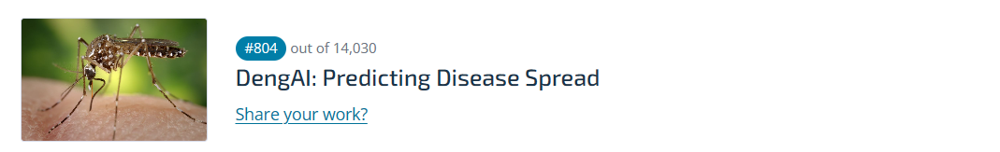

### Train the RF model

In [ ]:
iq_df_feature_RF_Lag = pd.read_csv('iq_df_feature_RF_Lag.csv')
sj_df_feature_RF_Lag = pd.read_csv('sj_df_feature_RF_Lag.csv')
iq_df_test_RF_Lag = pd.read_csv('iq_df_test_RF_Lag.csv')
sj_df_test_RF_Lag = pd.read_csv('sj_df_test_RF_Lag.csv')

iq_RF_feature = iq_df_feature_RF_Lag.drop(columns=['total_cases','season'])
iq_RF_label = iq_df_feature_RF_Lag['total_cases']
sj_RF_feature = sj_df_feature_RF_Lag.drop(columns=['total_cases','season'])
sj_RF_label = sj_df_feature_RF_Lag['total_cases']

# For test set
iq_RF_test_yufeng = iq_df_test_RF_Lag.drop(columns=['season'])
sj_RF_test_yufeng = sj_df_test_RF_Lag.drop(columns=['season'])

In [ ]:
# # The training need about 30 minutes
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import RandomizedSearchCV
# from scipy.stats import randint
# import time

# # search space for param_distributions
# param_distributions = {
#     'max_depth': randint(5, 100),
#     'max_features': ['sqrt', 'log2', 'auto', 2, 5],
#     'min_samples_leaf': randint(1, 5),
#     'min_samples_split': randint(2, 5),
#     'n_estimators': randint(100, 300)
# }

# # Create a random forest regressor instance
# rfr = RandomForestRegressor(criterion='absolute_error')

# # Create RandomizedSearchCV instance
# # K-Fold, K = 5
# rs = RandomizedSearchCV(estimator=rfr, param_distributions=param_distributions,
#                         n_iter=3000, cv=5, n_jobs=-1, random_state=42)

# start = time.time()

# rs.fit(sj_features, sj_labels)

# print(time.time() - start)

# sj_rf_params = rs.best_params_
# sj_rf_params


It need around 30 min to train So! !


Here I directly provide the parameter results for my training

In [ ]:
sj_rf_params = {'max_depth': 21,
 'max_features': 2,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 145}

In [ ]:
# # The training need about 30 minutes
# from sklearn.ensemble import RandomForestRegressor
# from sklearn.model_selection import RandomizedSearchCV
# from scipy.stats import randint
# import time

# # search space for param_distributions
# param_distributions = {
#     'max_depth': randint(5, 100),
#     'max_features': ['sqrt', 'log2', 'auto', 2, 5],
#     'min_samples_leaf': randint(1, 5),
#     'min_samples_split': randint(2, 5),
#     'n_estimators': randint(100, 300)
# }

# # Create a random forest regressor instance
# rfr = RandomForestRegressor(criterion='absolute_error')

# # Create RandomizedSearchCV instance
# # K-Fold, K = 5
# rs = RandomizedSearchCV(estimator=rfr, param_distributions=param_distributions,
#                         n_iter=3000, cv=5, n_jobs=-1, random_state=42)

# start = time.time()

# rs.fit(iq_features, iq_labels)

# print(time.time() - start)

# iq_rf_params = rs.best_params_
# iq_rf_params


Here I directly provide the parameter results for my training

In [ ]:
iq_rf_params = {'max_depth': 20,
 'max_features': 2,
 'min_samples_leaf': 2,
 'min_samples_split': 2,
 'n_estimators': 100}

In [ ]:
from sklearn.ensemble import RandomForestRegressor
sj_rfr = RandomForestRegressor(**sj_rf_params, criterion='absolute_error')
iq_rfr = RandomForestRegressor(**iq_rf_params, criterion='absolute_error')

sj_rfr.fit(sj_RF_feature, sj_RF_label)
iq_rfr.fit(iq_RF_feature, iq_RF_label)


RandomForestRegressor(criterion='absolute_error', max_depth=20, max_features=2,
                      min_samples_leaf=2)

### Submission

In [ ]:
train_columns = iq_rfr.feature_names_in_

test_columns = iq_RF_test_yufeng.columns

missing_columns = set(train_columns) - set(test_columns)

extra_columns = set(test_columns) - set(train_columns)

print("if any missing?:", missing_columns)
print("if any extra?:", extra_columns)
if not missing_columns and not extra_columns:
    iq_RF_test_yufeng = iq_RF_test_yufeng[train_columns]
    print("Data all prepared")

if any missing?: set()
if any extra?: set()
Data all prepared


In [ ]:
train_columns = sj_rfr.feature_names_in_

test_columns = sj_RF_test_yufeng.columns

missing_columns = set(train_columns) - set(test_columns)

extra_columns = set(test_columns) - set(train_columns)

print("if any missing?:", missing_columns)
print("if any extra?:", extra_columns)
if not missing_columns and not extra_columns:
    sj_RF_test_yufeng = sj_RF_test_yufeng[train_columns]
    print("All Done")

if any missing?: set()
if any extra?: set()
All Done


In [ ]:
submission_format = pd.read_csv('submission_format.csv')
# Make Prediction
sj_pred = sj_rfr.predict(sj_RF_test_yufeng).astype(int)
iq_pred = iq_rfr.predict(iq_RF_test_yufeng).astype(int)
final_pred_yufeng = np.concatenate([sj_pred, iq_pred])
submission_format.total_cases = final_pred_yufeng
submission_format.to_csv("final_model.csv",index=False)